In [1]:
from joblib import Parallel, delayed
import os
os.environ['R_HOME'] = '/public/home/liuzj/softwares/anaconda3/envs/hormone_new/lib/R'
import rpy2
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
import rpy2.ipython.html
rpy2.ipython.html.init_printing()
from jpy_tools.rTools import py2r, r2py, r_inline_plot, rHelp, trl, rSet, rGet, ad2so, so2ad, so2md, rcontext, Trl, r2py_re, py2r_re, RR, FR
from jpy_tools import loadPkl, toPkl
rBase = importr('base')
rUtils = importr('utils')
dplyr = importr('dplyr')
reticulate = importr('reticulate')
R = ro.r
T = Trl()
R("options(browser='firefox', shiny.port=6533, max.print=200)")
%load_ext rpy2.ipython


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

<Figure size 100x100 with 0 Axes>

In [2]:
import scanpy as sc
import muon as mu
import pandas as pd
import numpy as np
import scipy.sparse as ss
from tqdm import tqdm
from loguru import logger
from functools import partial
from jpy_tools import singleCellTools

In [3]:
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
import matplotlib as mpl
from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.font_manager as font_manager
import marsilea as ma
import marsilea.plotter as mp
# plt.rcParams['figure.dpi'] = 150
font_dirs = ["/public/home/mowp/test/fonts/"]
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
plt.rcParams["font.family"] = "Arial"
sns.despine(top=True, right=True)
from itertools import product
from functools import reduce
import patchworklib as pw
from jpy_tools.otherTools import pwRecoverSeaborn, pwStack, F, pwShow
pw.show = pwShow
fc_recoverSns = pwRecoverSeaborn()
import seaborn.objects as so
from cycler import cycler
dt_snsStyle = {**sns.axes_style('ticks'), "legend.frameon": False, "axes.spines.top":False, "axes.spines.right":False, "axes.prop_cycle":cycler(color=['grey'])}
so.Plot.config.theme.update(dt_snsStyle)

<Figure size 640x480 with 0 Axes>

In [4]:
dir_result = '/data/Zhaijx/liuzj/projects/singleCell/hormone/res/'

# load data

In [6]:
ad_all = sc.read_h5ad("/public/home/lizw/home2/task/singlecell/singlecell_hormone/20230914_all_libraries/ALL.h5ad")

In [7]:
ad_all.obs = ad_all.obs.rename(lambda _: _.replace("_", "-"), axis=0)

In [8]:
ad_all.obs = ad_all.obs.assign(All_label=lambda _: _.Sample.astype(str) + '-' + _.Replicates.astype(str))

In [9]:
ad_all.obs = ad_all.obs.assign(Hormone = lambda _: _.Sample.str.split('_').str[0])

In [10]:
ad_all.obs.value_counts("All_label", sort=False)

All_label
ABA_05h-Rep1     16691
ABA_05h-Rep2     11618
ABA_3h-Rep1      29017
ABA_3h-Rep2      26957
AUX_05h-Rep1     19530
AUX_05h-Rep2     11497
AUX_3h-Rep1      28099
AUX_3h-Rep2      25721
BR_05h-Rep1      13638
BR_05h-Rep2      26029
BR_3h-Rep1       16259
BR_3h-Rep2       15943
CK_05h-Rep1      18996
CK_05h-Rep2      33087
CK_3h-Rep1       28554
CK_3h-Rep2       22708
ET_05h-Rep1      35932
ET_05h-Rep2      31788
ET_3h-Rep1       36110
ET_3h-Rep2       18209
GA_05h-Rep1      16715
GA_05h-Rep2      38480
GA_3h-Rep1       19264
GA_3h-Rep2       24440
JA_05h-Rep1      26704
JA_05h-Rep2      10899
JA_3h-Rep1       13369
JA_3h-Rep2        9968
Mock_05h-Rep1    21017
Mock_05h-Rep2    31045
Mock_3h-Rep1     28674
Mock_3h-Rep2     24210
SA_05h-Rep1      10963
SA_05h-Rep2      11055
SA_3h-Rep1       21006
SA_3h-Rep2       24965
SL_05h-Rep1      17316
SL_05h-Rep2       7051
SL_3h-Rep1       18581
SL_3h-Rep2       18606
dtype: int64

# load TF

In [11]:
ls_tf = pd.read_table("/data/Zhaijx/liuzj/data/Araport11/tf/Ath_TF_list.txt.1")['Gene_ID'].tolist()

# load gene name

In [12]:
import pyranges as pr

In [13]:
df_gff = pr.read_gff3('/data/Zhaijx/liuzj/data/Araport11/tair10/Araport11_GFF3_genes_transposons.Mar92021.gff.gz', as_df=True)

In [14]:
df_gff.query("Feature == 'gene'")

,Chromosome,Source,Feature,Start,End,Score,Strand,Frame,ID,Name,...,product,protein_id,exon_number,number,gene_synonym,pseudo,exception,part,partial,start_range
0,Chr1,Araport11,gene,3630,5899,.,+,.,AT1G01010,AT1G01010,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17,Chr1,Araport11,gene,6787,9130,.,-,.,AT1G01020,AT1G01020,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
96,Chr1,Araport11,gene,11100,11372,.,+,.,AT1G03987,AT1G03987,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
99,Chr1,Araport11,gene,11648,13714,.,-,.,AT1G01030,AT1G01030,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
123,Chr1,Araport11,gene,23120,31227,.,+,.,AT1G01040,AT1G01040,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
789381,ChrM,Araport11,gene,329975,330773,.,-,.,ATMG00735,cox3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
789384,ChrM,Araport11,gene,346453,346526,.,+,.,ATMG00700,trnK(TTT),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
789392,ChrM,Araport11,gene,360106,360128,.,+,.,ATMG00665,nad5,...,NaN,NaN,NaN,NaN,NaN,NaN,trans-splicing,2/3,NaN,NaN
789396,ChrM,Araport11,gene,361636,361939,.,+,.,ATMG00650,nad4L,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [15]:
dt_id2sym = df_gff.query("Feature == 'gene'").assign(new_name = lambda _: np.select([~_.symbol.isna(), ~_.Note.isna()],[ _.symbol, _.Note], _.ID)).set_index('ID')['new_name'].to_dict()

# QC

## Basic

In [29]:
ad_all.var['Mito_Chlo'] = ad_all.var.index.str[2:4].isin(['MG', 'CG'])

In [33]:
ad_all.layers['raw'] = ad_all.X.copy()

In [36]:
ead = singleCellTools.EnhancedAnndata(ad_all, 'raw')

2024-05-21 19:34:30.882 | WARNING  | jpy_tools.singleCellTools:rawLayer:445 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


In [37]:
ead.initLayer('raw', logbase=2)

In [38]:
sc.pp.calculate_qc_metrics(ead.ad, qc_vars=['Mito_Chlo'], inplace=True, percent_top=None, layer='raw')

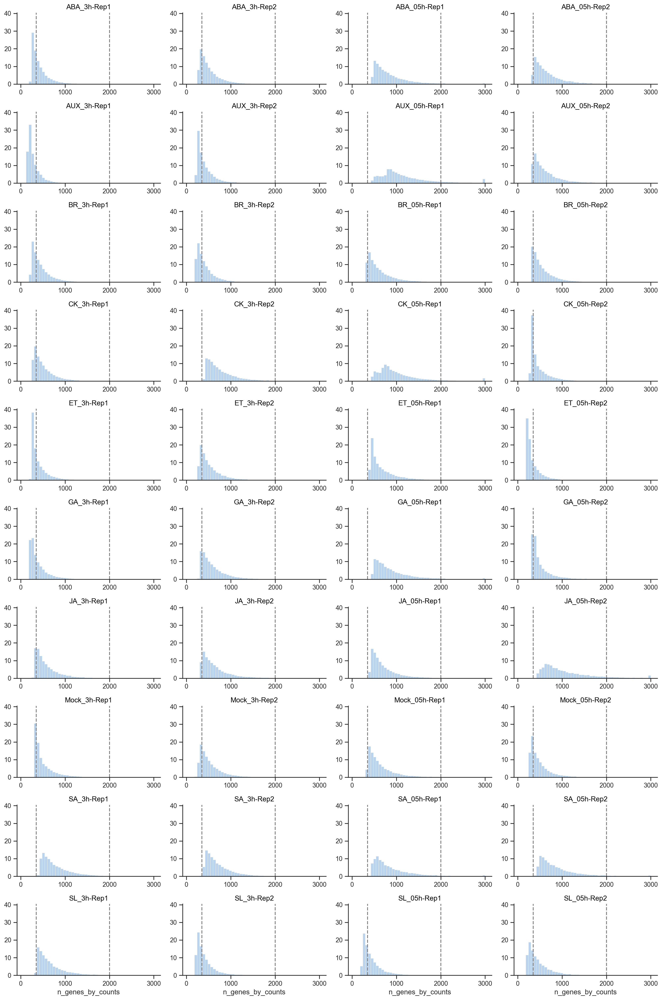

In [39]:
ead.pl.histogram(
    "n_genes_by_counts",
    groupby="All_label",
    binrange=(0, 3000), 
    markLine=(350, 2000),
    fc_additional=lambda _: _.layout(size=(4 * 4, 3 * 8)),
)[1]

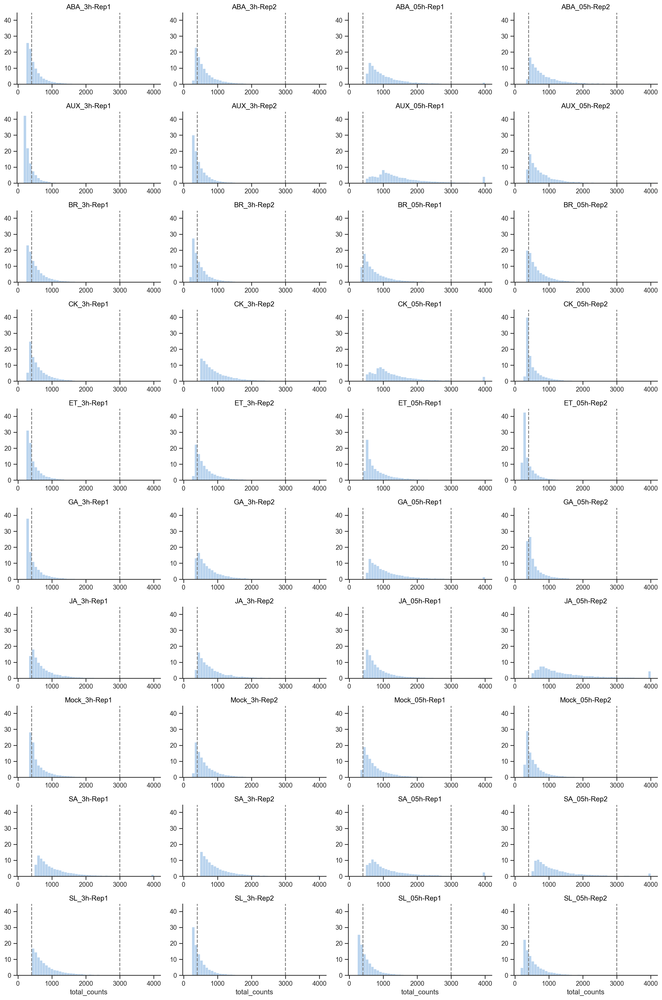

In [40]:
ead.pl.histogram(
    "total_counts",
    groupby="All_label",
    binrange=(0, 4000),
    markLine=(400, 3000),
    fc_additional=lambda _: _.layout(size=(4 * 4, 3 * 8)),
)[1]

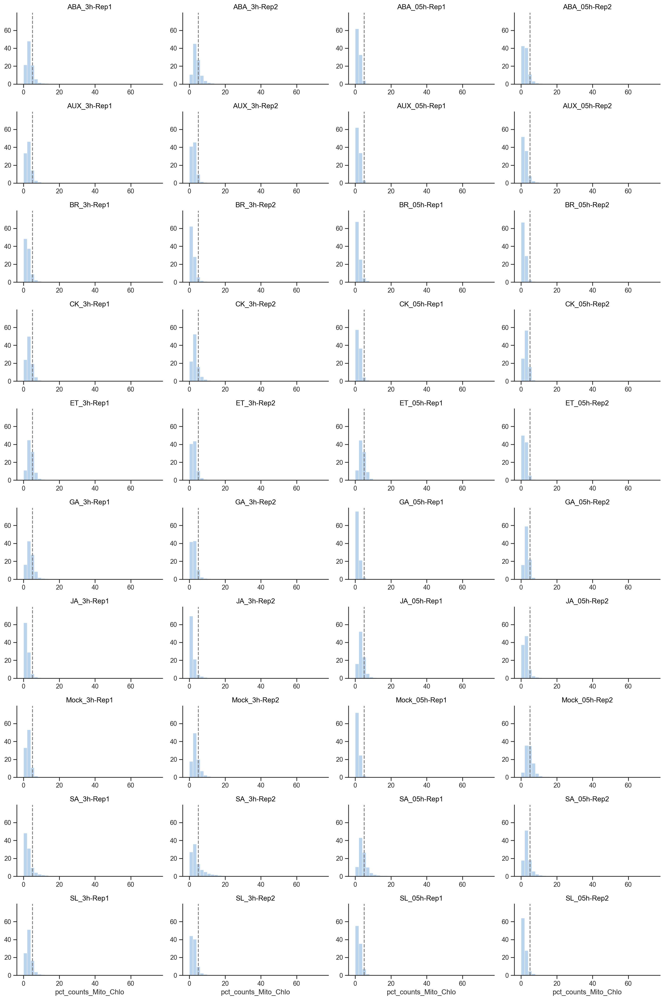

In [41]:
ead.pl.histogram(
    "pct_counts_Mito_Chlo",
    groupby="All_label",
    binrange=(0, 100),
    markLine=5,
    fc_additional=lambda _: _.layout(size=(4 * 4, 3 * 8)),
)[1]

In [42]:
ead

enhancedAnndata: AnnData object with n_obs × n_vars = 860711 × 32833
    obs: 'Sample', 'Replicates', 'Time', 'All_label', 'Hormone', 'ft_anno_prev', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_Mito_Chlo', 'log1p_total_counts_Mito_Chlo', 'pct_counts_Mito_Chlo'
    var: 'Mito_Chlo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'EnhancedAnndata_rawLayer', 'log1p'
    layers: 'raw', 'normalize_log'
rawLayer: raw

In [43]:
_df = pd.DataFrame(
    data=[
        ad_all.obs.value_counts("All_label", sort=False),
        ad_all[ad_all.obs.eval("400 < total_counts < 3000 & pct_counts_Mito_Chlo < 5 & 350 < n_genes_by_counts < 2000")].obs.value_counts("All_label", sort=False)
    ],
    index=["All", "Filtered"]
).T.assign(Ratio=lambda x: x.Filtered / x.All)

In [44]:
_df.sort_values("Ratio")

,All,Filtered,Ratio
All_label,,,
AUX_3h-Rep1,28099,5995,0.213353
ET_05h-Rep2,31788,9654,0.303700
GA_3h-Rep1,19264,7185,0.372975
ET_3h-Rep1,36110,14115,0.390889
Mock_05h-Rep2,31045,14122,0.454888
ABA_3h-Rep1,29017,13208,0.455181
SL_3h-Rep2,18606,8515,0.457648
AUX_3h-Rep2,25721,12101,0.470472
BR_3h-Rep2,15943,7595,0.476385


In [45]:
ead = ead[ead.obs.eval("400 < total_counts < 3000 & pct_counts_Mito_Chlo < 5 & 350 < n_genes_by_counts < 2000")]

2024-05-21 19:38:40.833 | WARNING  | jpy_tools.singleCellTools:rawLayer:445 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


# remove doublets

In [5]:
ead = singleCellTools.EnhancedAnndata(loadPkl('ad_qc_0521', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_result))

2024-05-22 17:03:09.271 | WARNING  | jpy_tools.singleCellTools:rawLayer:445 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


In [7]:
ead.qc.removeDoubletByScDblFinder(groupby="All_label", BPPARAM=4)

2024-05-22 10:40:22.074 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:174 - Convert adata to Seurat object
2024-05-22 10:51:34.598 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:180 - Calculate doublet score
2024-05-22 11:24:14.625 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:184 - Intergrate result with adata
2024-05-22 11:24:20.448 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:202 - before filter: 557851
2024-05-22 11:24:35.971 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:206 - after filter: 498376


In [8]:
toPkl(ead.ad, 'ad_qc_0521', 'ipf', dir_path=dir_result)

Global seed set to 0


2024-05-22 11:24:39.955 | INFO     | jpy_tools.otherTools:toPkl:482 - please run `loadPkl('ad_qc_0521', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


# Norm

In [5]:
ead = singleCellTools.EnhancedAnndata(loadPkl('ad_qc_0521', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_result))

2024-05-23 11:24:22.516 | WARNING  | jpy_tools.singleCellTools:rawLayer:445 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


In [6]:
ead

enhancedAnndata: AnnData object with n_obs × n_vars = 498376 × 32833
    obs: 'Sample', 'Replicates', 'Time', 'All_label', 'Hormone', 'ft_anno_prev', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_Mito_Chlo', 'log1p_total_counts_Mito_Chlo', 'pct_counts_Mito_Chlo'
    var: 'Mito_Chlo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'EnhancedAnndata_rawLayer', 'log1p'
    obsm: 'scDblFinder'
    layers: 'normalize_log', 'raw'
rawLayer: raw

In [ ]:
ead.norm.normBySct(nTopGenes=5000, batchKey="All_label", njobs=10)

In [21]:
del(ead.ad.obsm['sct_residual'])

In [22]:
# ead.ad.write_h5ad(f"{dir_result}/ad_qc_0521_sct.h5ad")

In [7]:
ead = singleCellTools.EnhancedAnndata(sc.read_h5ad(f"{dir_result}/ad_qc_0521_sct.h5ad"))

2024-05-23 13:28:30.381 | WARNING  | jpy_tools.singleCellTools:rawLayer:445 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


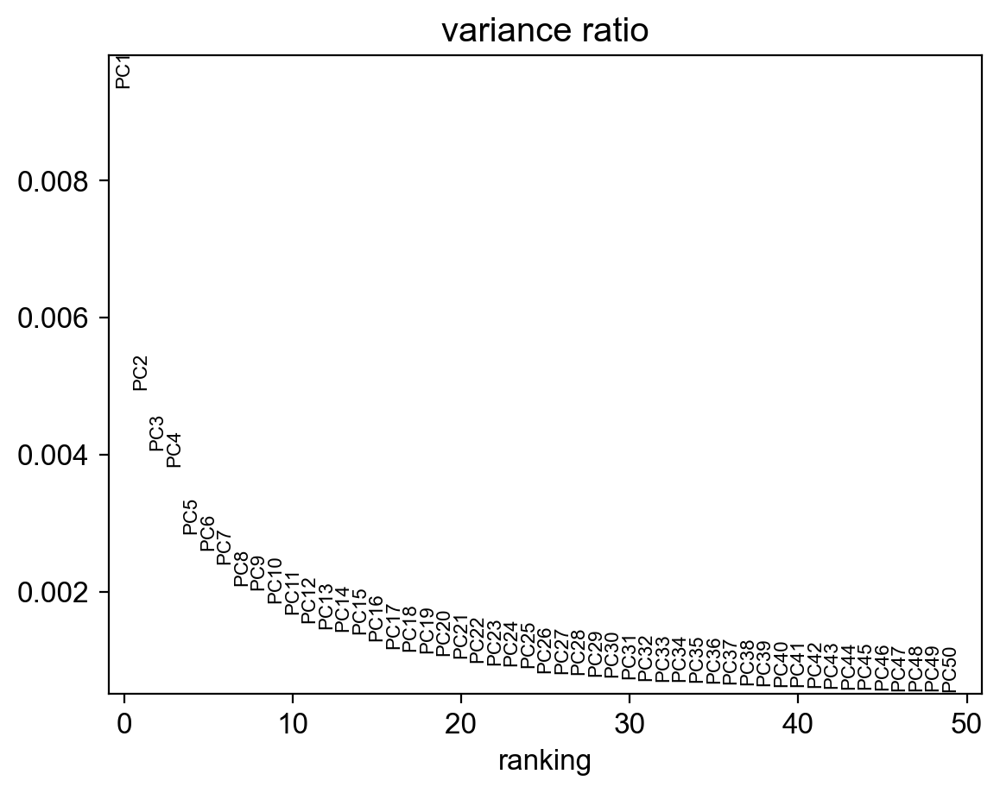

In [9]:
sc.pl.pca_variance_ratio(ead.ad, 50)

In [13]:
ead.obs['Treatment'] = ead.obs['Sample']

In [17]:
ead.obs[['Treatment','All_label']]

,Treatment,All_label
AAACCCAAGACTCAAA-1-Mock-05h-Rep1-Time05h,Mock_05h,Mock_05h-Rep1
AAACCCAAGCATTGAA-1-Mock-05h-Rep1-Time05h,Mock_05h,Mock_05h-Rep1
AAACCCAAGGAGGTTC-1-Mock-05h-Rep1-Time05h,Mock_05h,Mock_05h-Rep1
AAACCCAAGTAGAATC-1-Mock-05h-Rep1-Time05h,Mock_05h,Mock_05h-Rep1
AAACCCACAAACCACT-1-Mock-05h-Rep1-Time05h,Mock_05h,Mock_05h-Rep1
...,...,...
TTTGTTGGTTGCGTAT-1-SA-3h-Rep2-Time3h,SA_3h,SA_3h-Rep2
TTTGTTGTCAGCCTTC-1-SA-3h-Rep2-Time3h,SA_3h,SA_3h-Rep2
TTTGTTGTCATTCCTA-1-SA-3h-Rep2-Time3h,SA_3h,SA_3h-Rep2
TTTGTTGTCCCTCGAT-1-SA-3h-Rep2-Time3h,SA_3h,SA_3h-Rep2


In [19]:
sc.external.pp.harmony_integrate(ead.ad, ['Treatment','All_label'], max_iter_harmony=50, lamb=0.5)

2024-05-23 12:36:37,620 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-23 12:41:08,087 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-23 12:41:12,138 - harmonypy - INFO - Iteration 1 of 50
2024-05-23 12:47:57,901 - harmonypy - INFO - Iteration 2 of 50
2024-05-23 12:54:36,377 - harmonypy - INFO - Iteration 3 of 50
2024-05-23 13:01:37,982 - harmonypy - INFO - Iteration 4 of 50
2024-05-23 13:08:01,777 - harmonypy - INFO - Iteration 5 of 50
2024-05-23 13:13:02,835 - harmonypy - INFO - Iteration 6 of 50
2024-05-23 13:16:57,460 - harmonypy - INFO - Converged after 6 iterations


In [22]:
sc.pp.neighbors(ead.ad, 100, use_rep='X_pca_harmony', metric='cosine')

In [32]:
sc.tl.umap(ead.ad, 0.3)

2024-05-23 15:18:31.789 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1584 - ls_color: Index(['ABA', 'AUX', 'BR', 'CK', 'ET', 'GA', 'JA', 'Mock', 'SA', 'SL'], dtype='object')


2024-05-23 15:19:27.945 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1711 - Title location: 0.8878333333333334


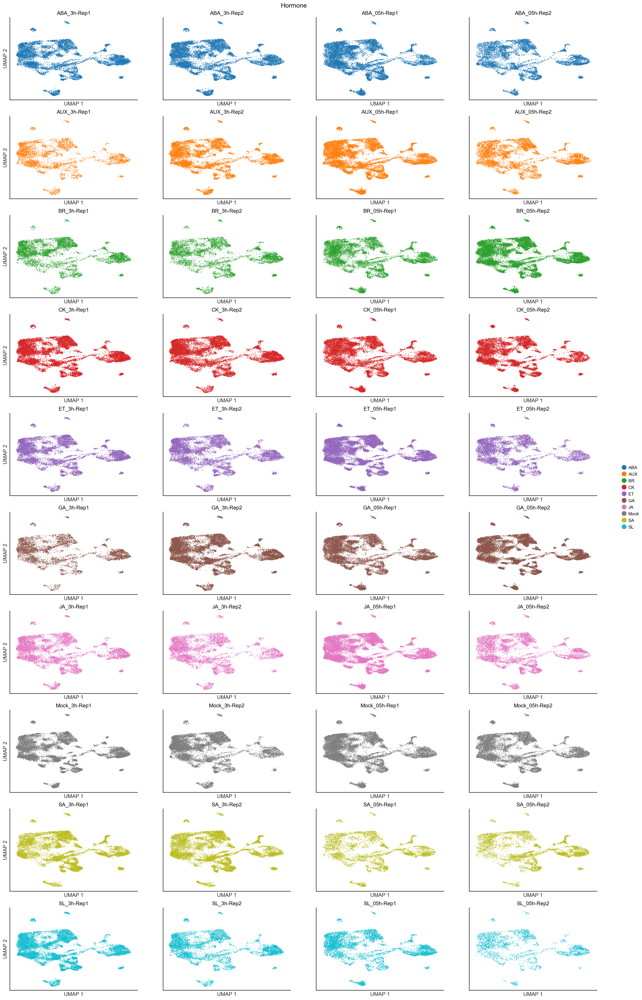

In [35]:
fig = ead.pl.embedding('umap', 'Hormone', groupby='All_label', figsize=(6 * 4, 5 * 8), size=0.5, addBackground=False, wrap=4, )
fig

# Final Clustering Res

In [ ]:
sc.tl.leiden(ead.ad, resolution=3, key_added='over_clustering', n_iterations=2)

In [ ]:
sc.tl.paga(ead.ad, groups='over_clustering')

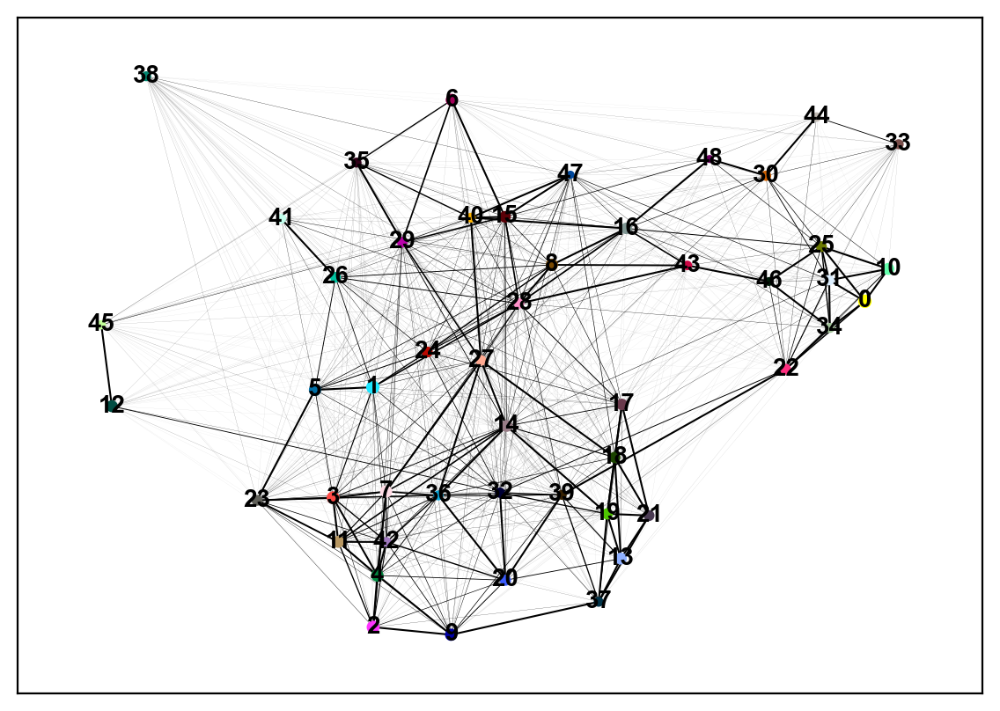

In [ ]:
sc.pl.paga(ead.ad, layout='fa',edge_width_scale=0.1, node_size_scale=0.1)

In [ ]:
sc.tl.umap(ead.ad, 0.1, init_pos='paga')

In [ ]:
# ead.obsm['X_umap_nn100_paga3'] = ead.obsm['X_umap']
ead.obsm['X_umap'] =  ead.obsm['X_umap_nn100_paga3'] 
 

2024-05-24 10:37:29.811 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1584 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24',
       '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36',
       '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48'],
      dtype='object')
2024-05-24 10:37:51.232 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1711 - Title location: 0.8966666666666666


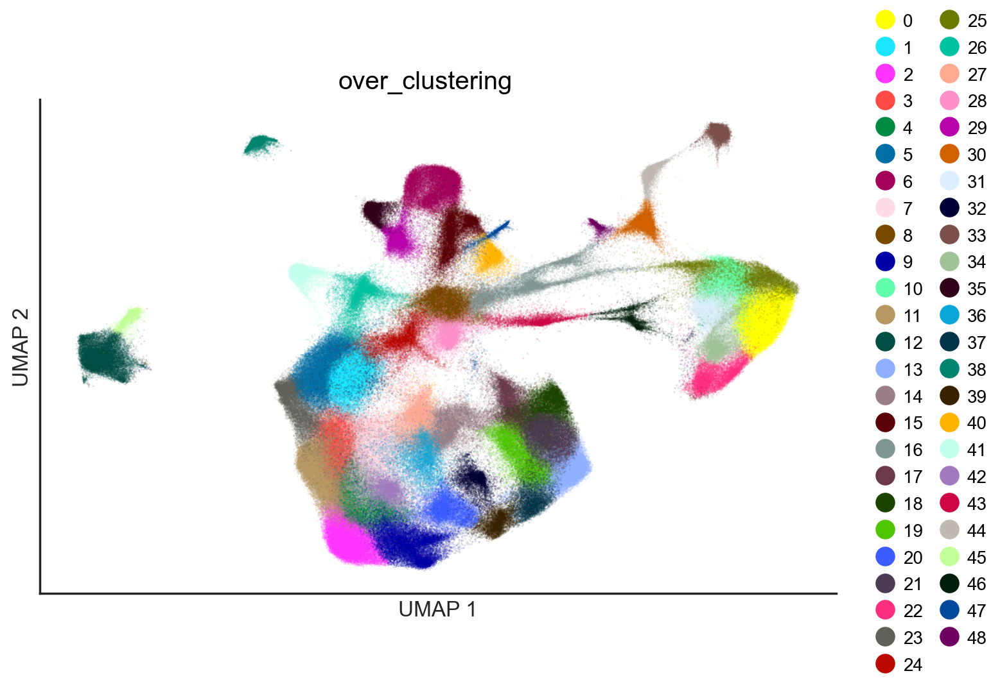

In [ ]:
fig = ead.pl.embedding('umap', 'over_clustering', figsize=(8, 5), size=0.05, legendCol=2)
fig

2024-05-24 10:38:23.420 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1584 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21'],
      dtype='object')
2024-05-24 10:38:43.255 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1711 - Title location: 0.8966666666666666


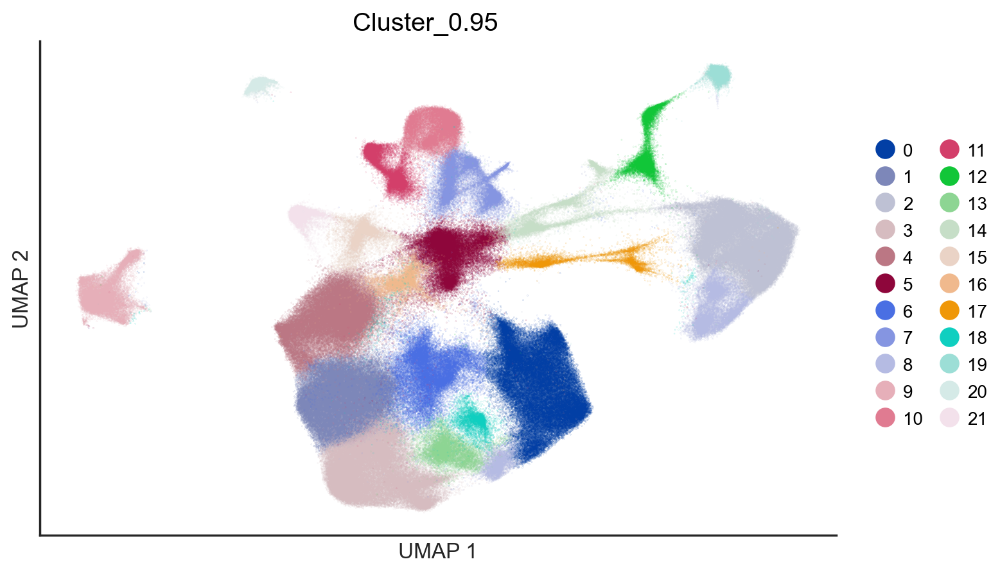

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_0.95', figsize=(8, 5), size=0.05, legendCol=2)
fig

2024-05-24 10:39:10.509 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1584 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24',
       '25', '26'],
      dtype='object')
2024-05-24 10:39:31.414 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1711 - Title location: 0.8966666666666666


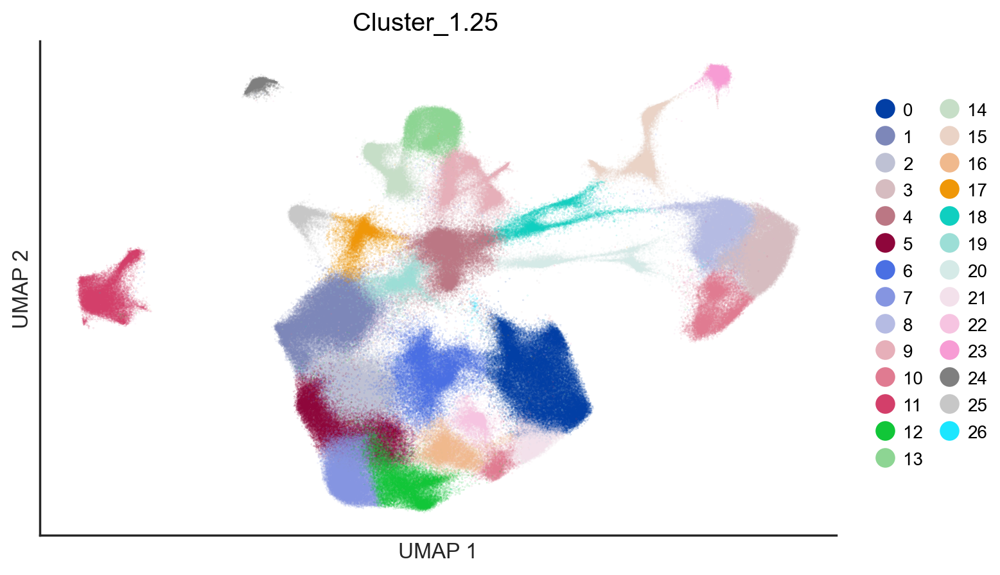

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_1.25', figsize=(8, 5), size=0.05, legendCol=2)
fig

2024-05-24 11:18:20.949 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1584 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24',
       '25', '26', '27'],
      dtype='object')
2024-05-24 11:18:43.906 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1711 - Title location: 0.8966666666666666


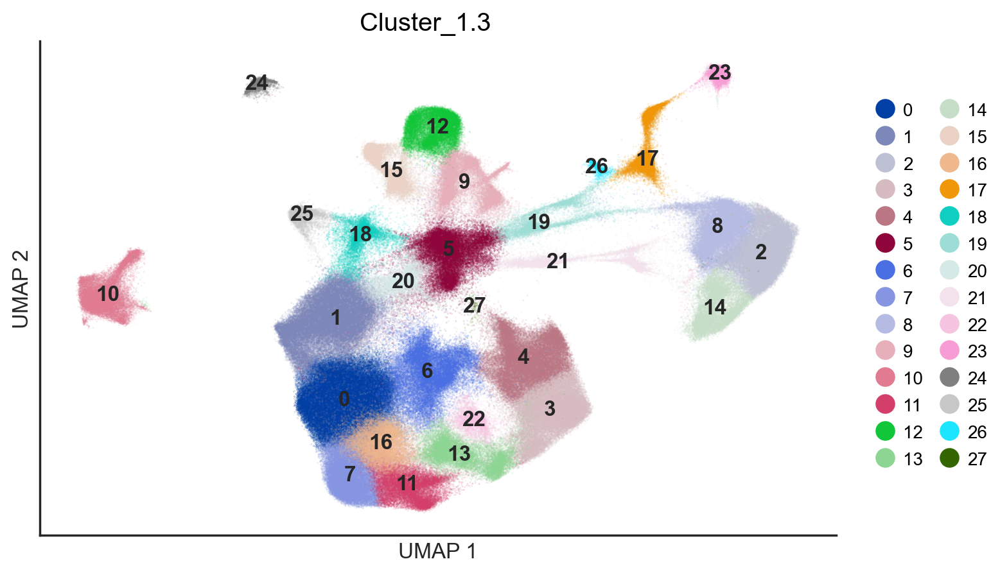

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_1.3', figsize=(8, 5), size=0.05, legendCol=2, legendInFig=True)
fig

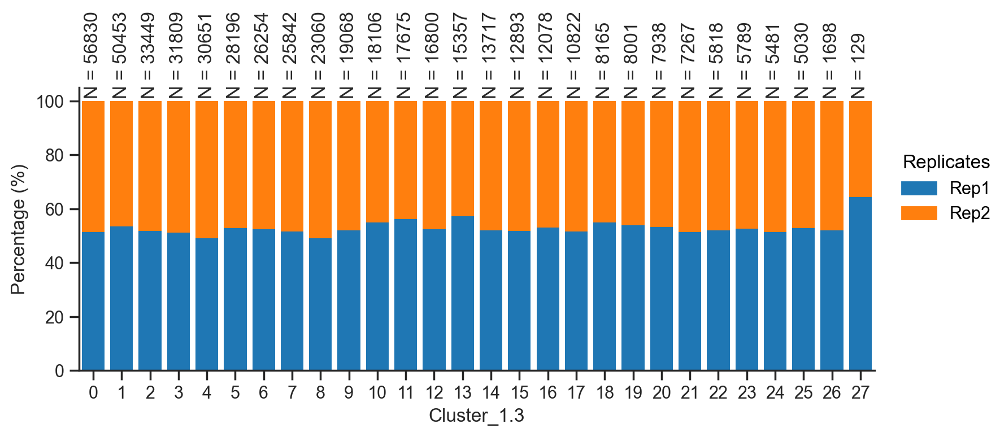

In [ ]:
ead.pl.clusterPercentage(x='Cluster_1.3', y='Replicates', figsize=(8,4))[1]

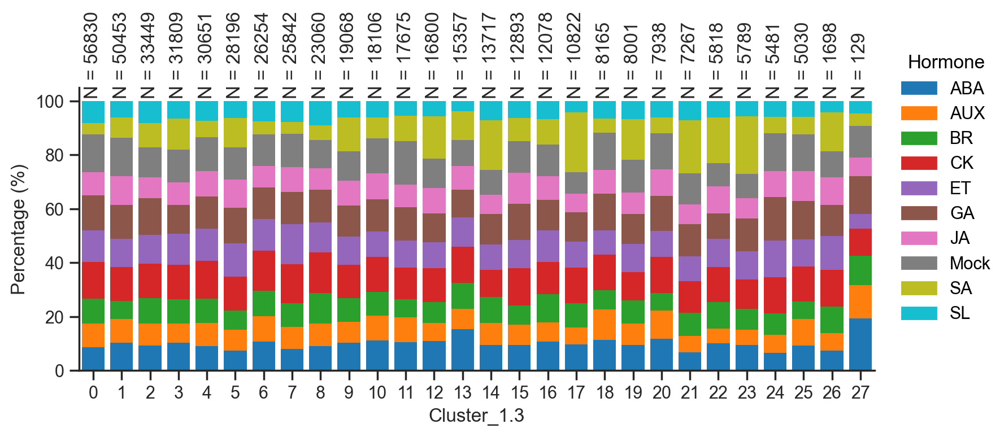

In [ ]:
ead.pl.clusterPercentage(x='Cluster_1.3', y='Hormone', figsize=(8,4))[1]

# Split Subcluster

In [ ]:
ead.obs['Cluster'] = ead.obs['Cluster_1.3']

2024-05-24 11:22:43.320 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1584 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24',
       '25', '26', '27'],
      dtype='object')
2024-05-24 11:23:05.416 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1711 - Title location: 0.8966666666666666


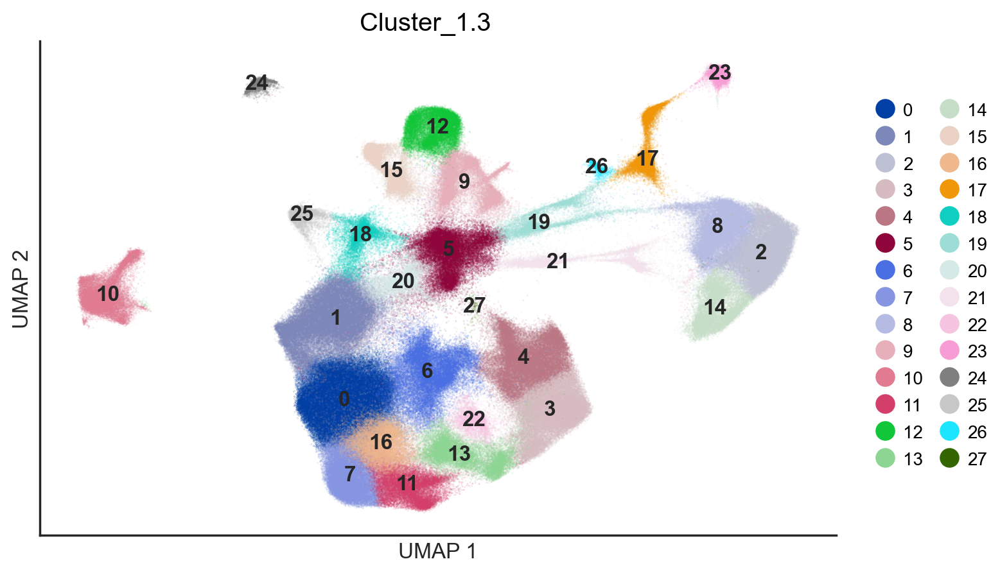

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_1.3', figsize=(8, 5), size=0.05, legendCol=2, legendInFig=True)
fig

## split 19

In [ ]:
sc.tl.leiden(
    ead.ad,
    resolution=0.3,
    restrict_to=("Cluster", ["19"]),
    key_added="Cluster_19",
    n_iterations=2,
)

2024-05-24 11:54:09.997 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1584 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19,0', '19,1', '19,2', '20', '21',
       '22', '23', '24', '25', '26', '27'],
      dtype='object')
2024-05-24 11:54:33.401 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1711 - Title location: 0.8966666666666666


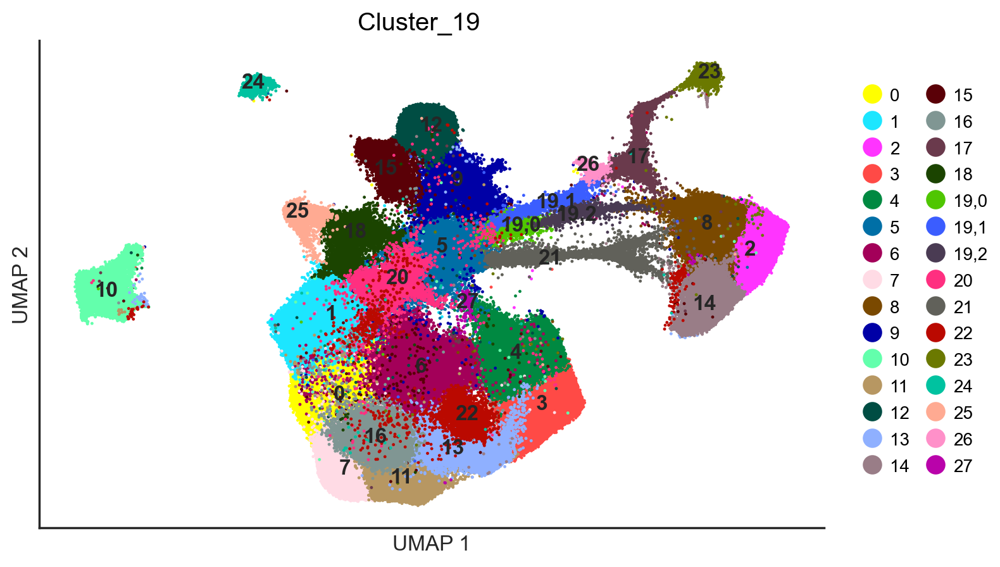

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_19', figsize=(8, 5), size=1, legendCol=2, legendInFig=True)
fig

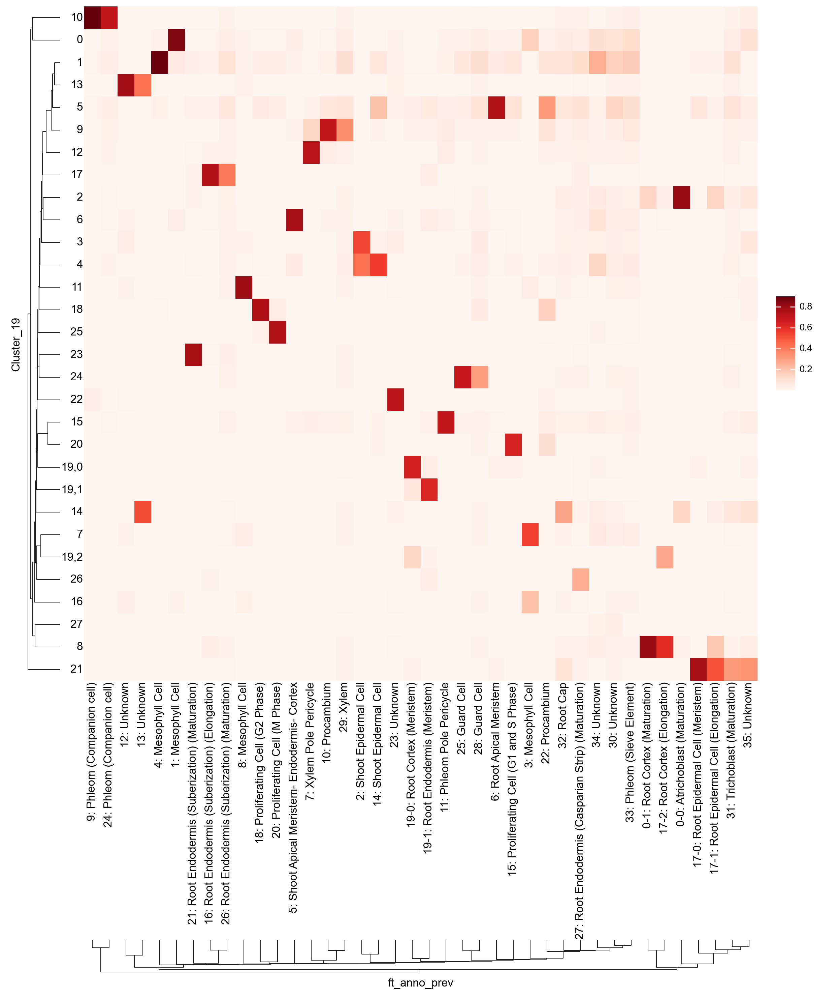

In [ ]:
ead.pl.clusterCompareHeatmap('Cluster_19', 'ft_anno_prev', figsize=(10, 10)).render()

In [ ]:
ead_sub = ead[ead.obs.eval("`Cluster_1.3` == '19'")].copy()

In [ ]:
sc.pp.highly_variable_genes(
    ead_sub.ad, n_top_genes=3000, layer='raw', flavor='seurat_v3'
)

In [ ]:
def reloadPackages(package):
    import importlib
    from types import ModuleType
    for p in dir(package):
        p = getattr(package, p)
        if isinstance(p, ModuleType):
            importlib.reload(p)
    importlib.reload(package)
reloadPackages(singleCellTools)

In [ ]:
ead_sub = singleCellTools.EnhancedAnndata(ead_sub.ad)
ead = singleCellTools.EnhancedAnndata(ead.ad)

2025-06-12 16:30:19.169 | WARNING  | jpy_tools.singleCellTools:rawLayer:608 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


2025-06-12 16:30:19.297 | WARNING  | jpy_tools.singleCellTools:rawLayer:608 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


2025-06-12 16:30:20.931 | WARNING  | jpy_tools.singleCellTools.basic:testAllCountIsInt:318 - Make sure that adata.layer contains unnormalized count data	Layer:raw


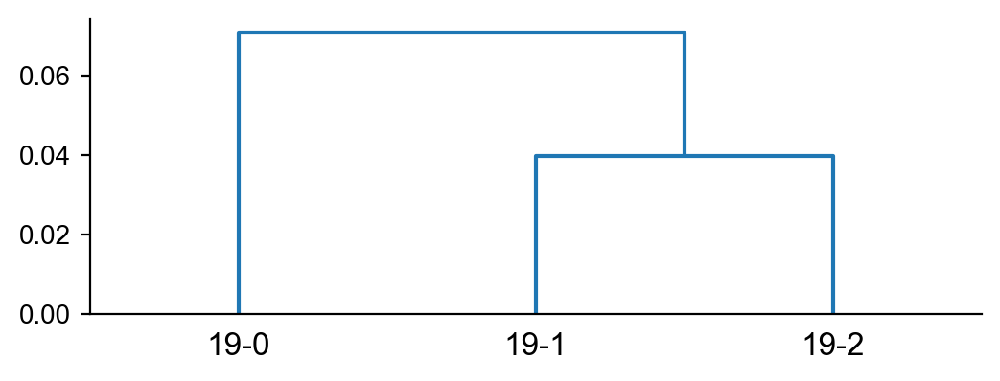

2025-06-12 16:30:23.183 | INFO     | jpy_tools.singleCellTools.others:calucatePvalueForEachSplitUseScshc:1006 - start calculating p-value for each split


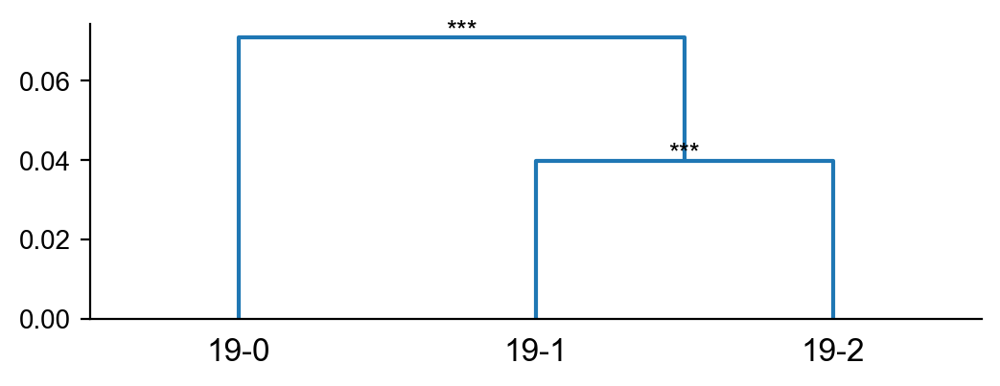

In [ ]:
ead_sub.cl.calculateSplitPvalueByScshc(
    ls_hvg=ead_sub.var.query("highly_variable").index.tolist(), clusterKey='Cluster_ft', figsize=(6,2)
)

## Split 9

In [ ]:
sc.tl.leiden(
    ead.ad,
    resolution=0.1,
    restrict_to=("Cluster_19", ["9"]),
    key_added="Cluster_19_9",
    n_iterations=2,
)

2024-05-24 12:00:07.897 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1584 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9,0', '9,1', '9,2', '10',
       '11', '12', '13', '14', '15', '16', '17', '18', '19,0', '19,1', '19,2',
       '20', '21', '22', '23', '24', '25', '26', '27'],
      dtype='object')


2024-05-24 12:00:30.580 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1711 - Title location: 0.8966666666666666


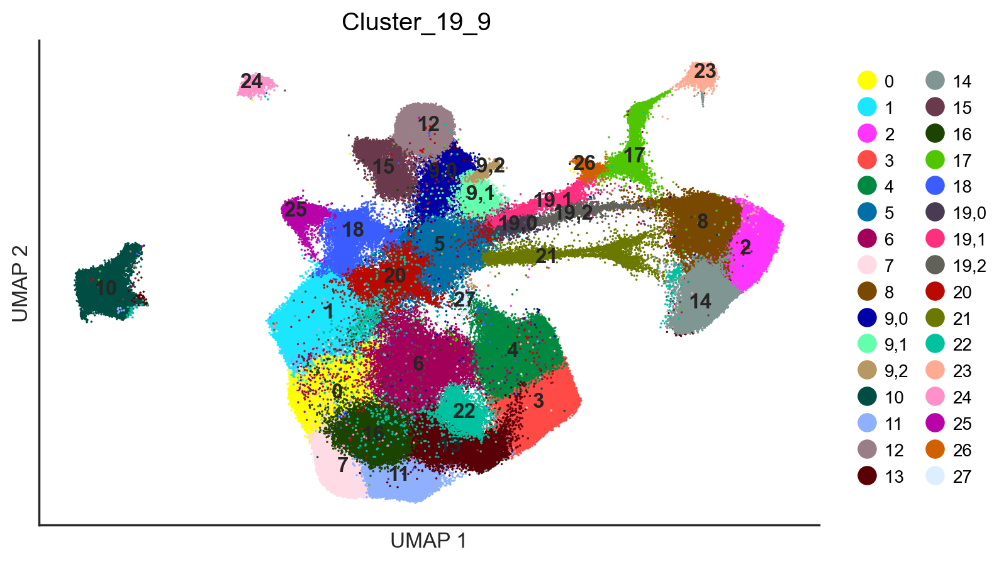

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_19_9', figsize=(8, 5), size=0.5, legendCol=2, legendInFig=True)
fig

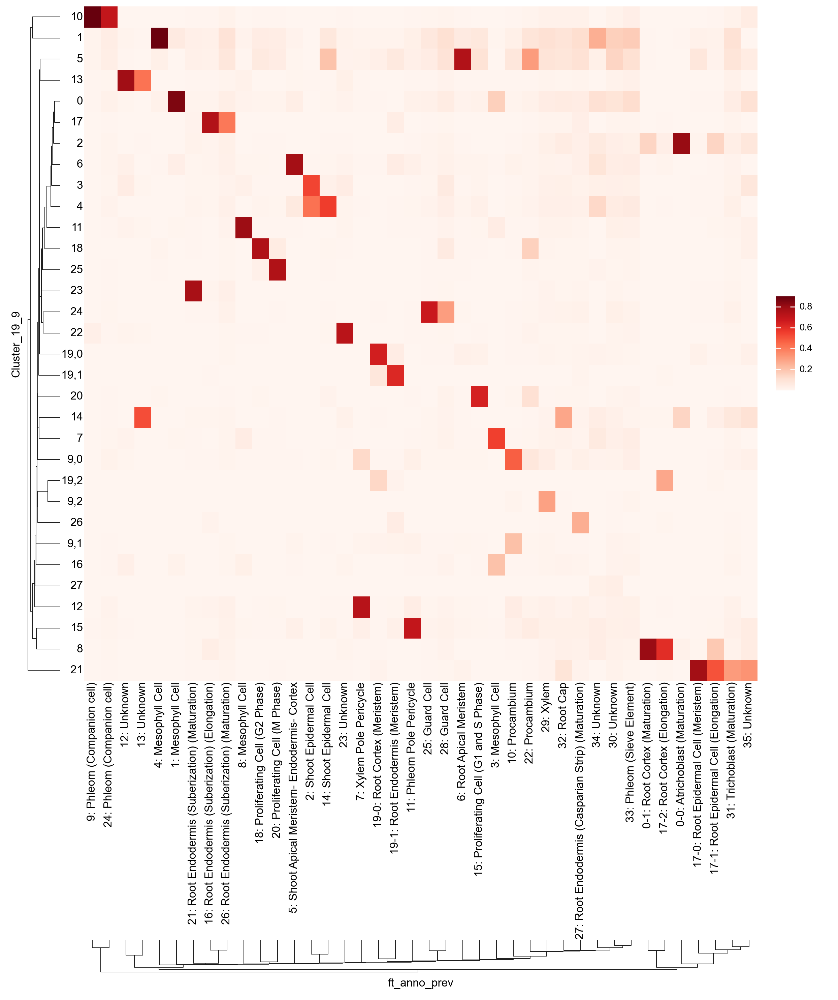

In [ ]:
ead.pl.clusterCompareHeatmap('Cluster_19_9', 'ft_anno_prev', figsize=(10, 10)).render()

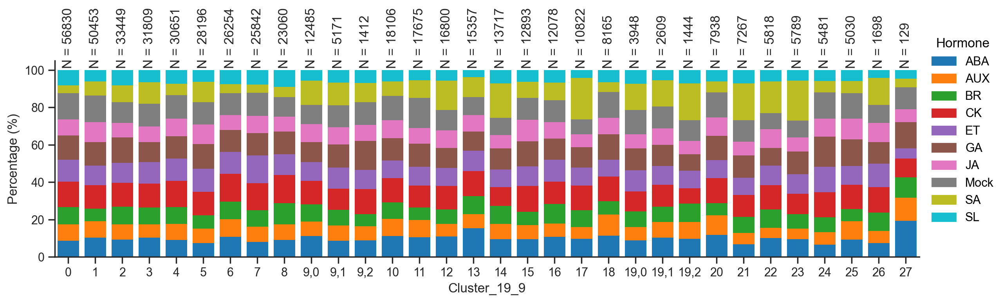

In [ ]:
ead.pl.clusterPercentage(x='Cluster_19_9', y='Hormone', figsize=(12,4))[1]

In [ ]:
ead_sub = ead[ead.obs.eval("`Cluster_1.3` == '9'")].copy()

In [ ]:
sc.pp.highly_variable_genes(
    ead_sub.ad, n_top_genes=3000, layer='raw', flavor='seurat_v3'
)

2025-06-12 16:31:45.902 | WARNING  | jpy_tools.singleCellTools.basic:testAllCountIsInt:318 - Make sure that adata.layer contains unnormalized count data	Layer:raw


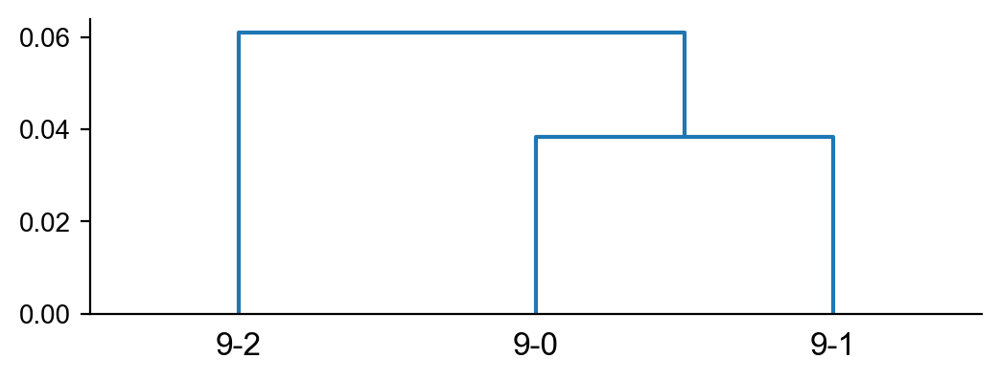

2025-06-12 16:31:50.200 | INFO     | jpy_tools.singleCellTools.others:calucatePvalueForEachSplitUseScshc:1006 - start calculating p-value for each split


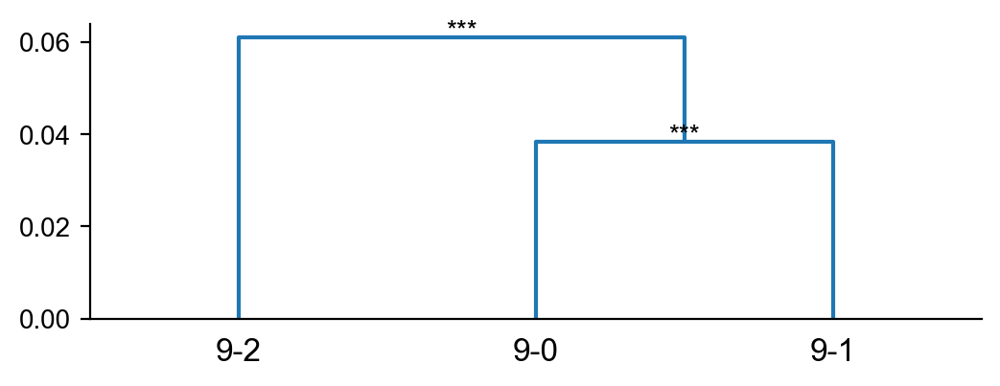

In [ ]:
ead_sub.cl.calculateSplitPvalueByScshc(
    ls_hvg=ead_sub.var.query("highly_variable").index.tolist(), clusterKey='Cluster_ft', figsize=(6,2)
)

## split 21

In [ ]:
sc.tl.leiden(
    ead.ad,
    resolution=0.25,
    restrict_to=("Cluster_19_9", ["21"]),
    key_added="Cluster_19_9_21",
    n_iterations=2,
)

2024-05-24 12:42:40.231 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1584 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9,0', '9,1', '9,2', '10',
       '11', '12', '13', '14', '15', '16', '17', '18', '19,0', '19,1', '19,2',
       '20', '21,0', '21,1', '21,2', '22', '23', '24', '25', '26', '27'],
      dtype='object')
2024-05-24 12:43:03.043 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1711 - Title location: 0.8966666666666666


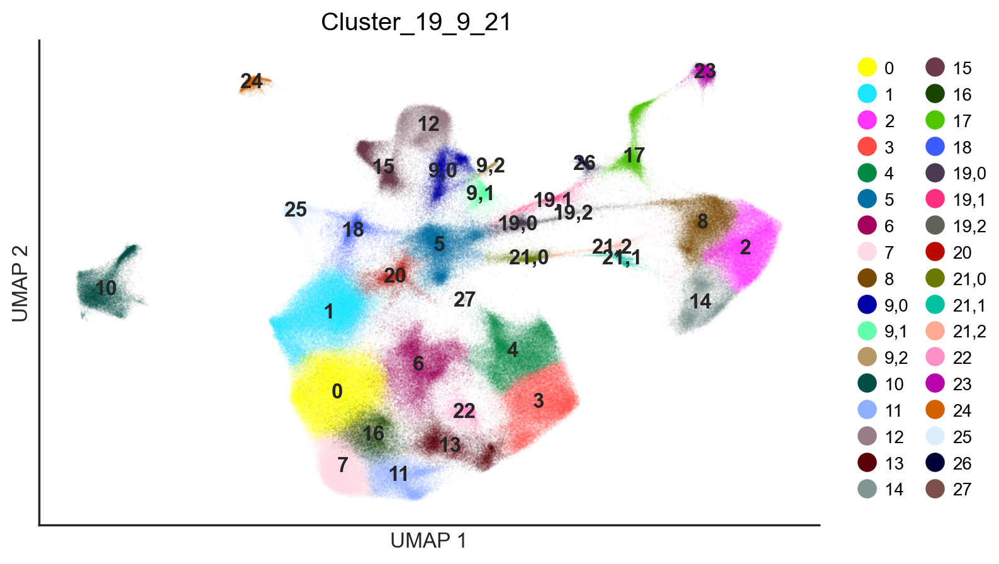

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_19_9_21', figsize=(8, 5), size=0.02, legendCol=2, legendInFig=True)
fig

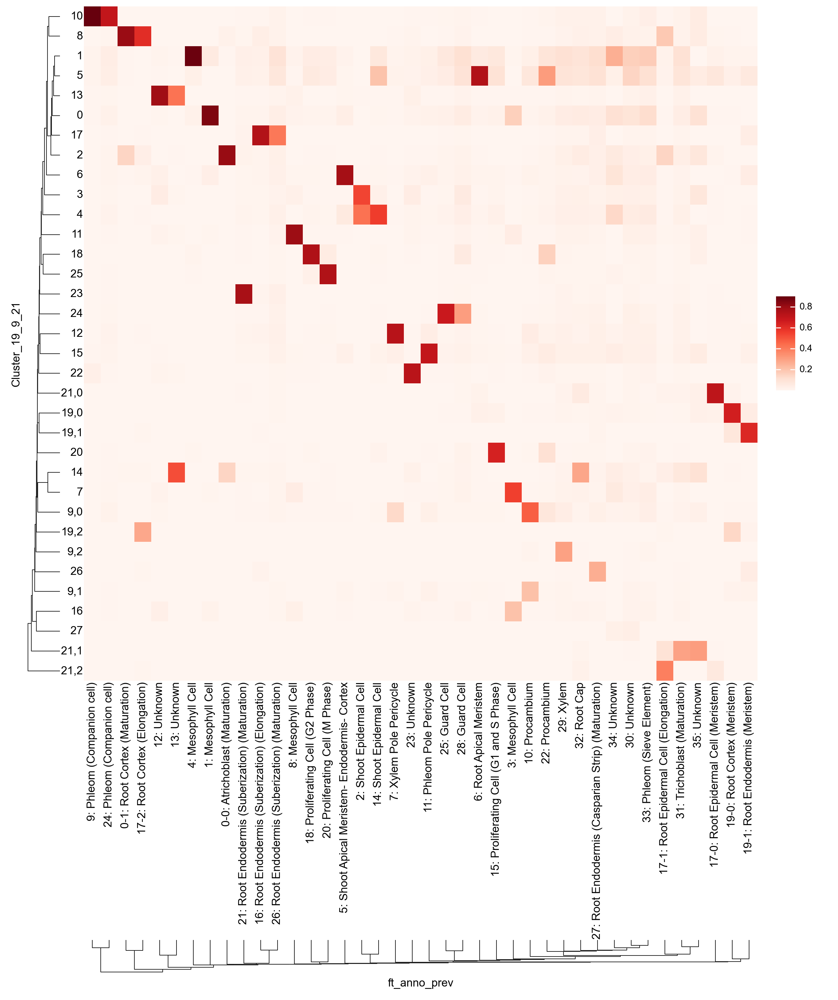

In [ ]:
ead.pl.clusterCompareHeatmap('Cluster_19_9_21', 'ft_anno_prev', figsize=(10, 10)).render()

In [ ]:
ead_sub = ead[ead.obs.eval("`Cluster_1.3` == '21'")].copy()

In [ ]:
sc.pp.highly_variable_genes(
    ead_sub.ad, n_top_genes=3000, layer='raw', flavor='seurat_v3'
)

2025-06-12 16:33:47.224 | WARNING  | jpy_tools.singleCellTools.basic:testAllCountIsInt:318 - Make sure that adata.layer contains unnormalized count data	Layer:raw


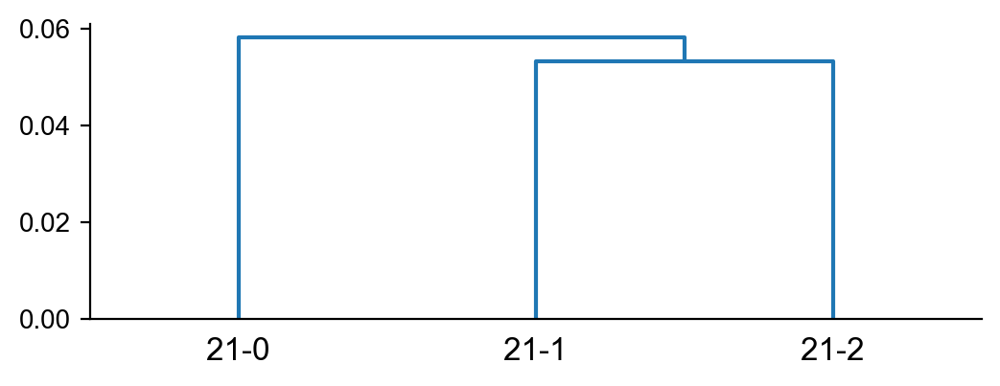

2025-06-12 16:33:49.349 | INFO     | jpy_tools.singleCellTools.others:calucatePvalueForEachSplitUseScshc:1006 - start calculating p-value for each split


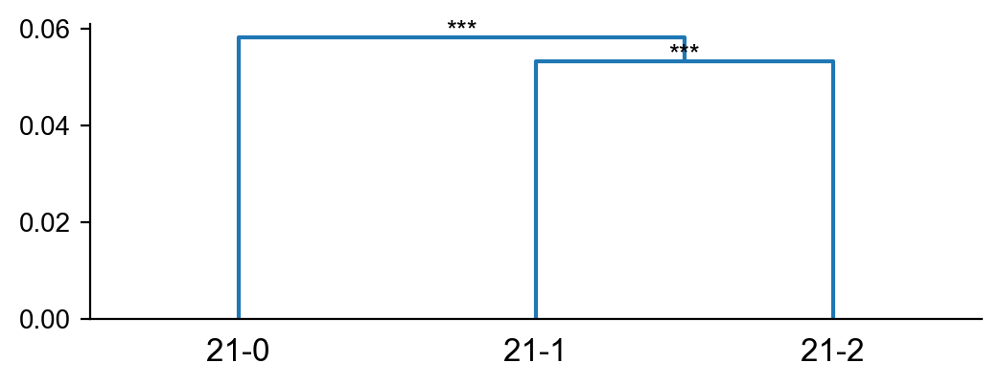

In [ ]:
ead_sub.cl.calculateSplitPvalueByScshc(
    ls_hvg=ead_sub.var.query("highly_variable").index.tolist(), clusterKey='Cluster_ft', figsize=(6,2)
)

## split 14

In [ ]:
sc.tl.leiden(
    ead.ad,
    resolution=0.1,
    restrict_to=("Cluster_19_9_21", ["14"]),
    key_added="Cluster_19_9_21_14",
    n_iterations=2,
)

2024-05-24 18:10:47.646 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1590 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9,0', '9,1', '9,2', '10',
       '11', '12', '13', '14,0', '14,1', '15', '16', '17', '18', '19,0',
       '19,1', '19,2', '20', '21,0', '21,1', '21,2', '22', '23', '24', '25',
       '26', '27'],
      dtype='object')


2024-05-24 18:11:09.581 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1717 - Title location: 0.8966666666666666


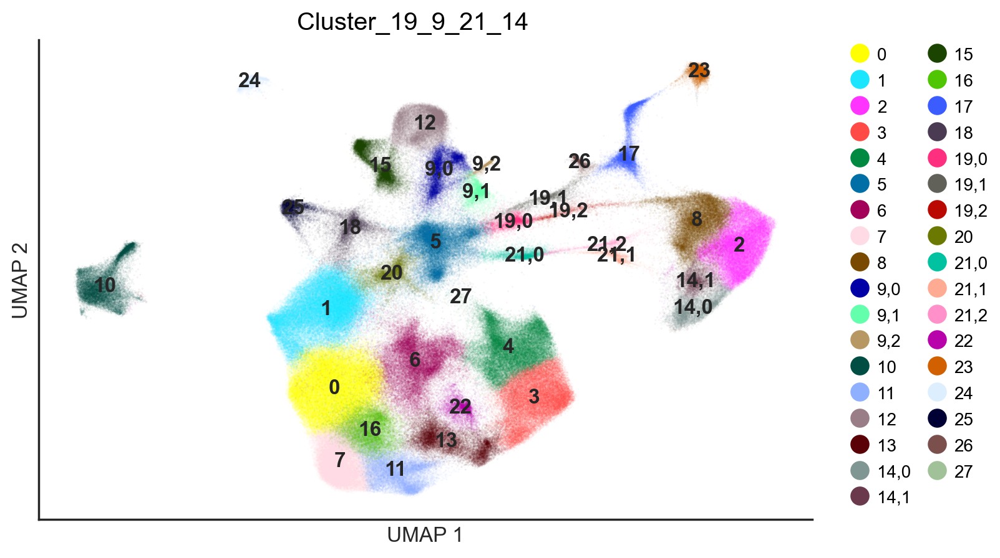

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_19_9_21_14', figsize=(8, 5), size=0.02, legendCol=2, legendInFig=True)
fig

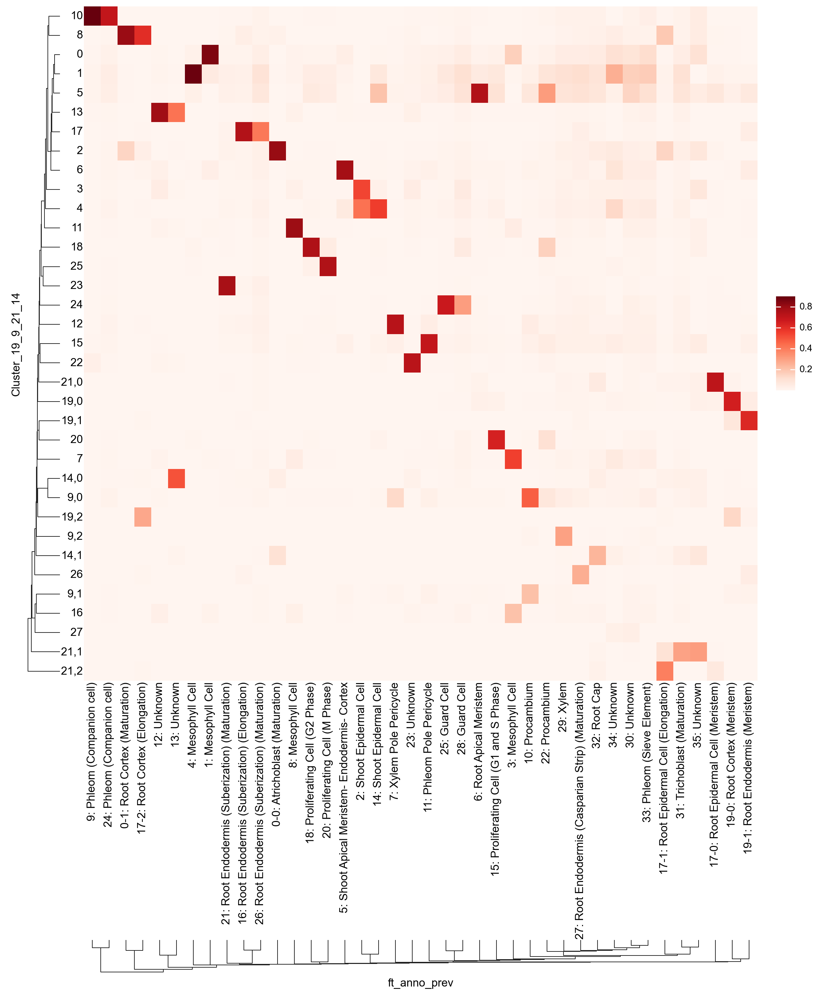

In [ ]:
ead.pl.clusterCompareHeatmap('Cluster_19_9_21_14', 'ft_anno_prev', figsize=(10, 10)).render()

In [ ]:
ead.obs["Cluster_ft"] = ead.obs["Cluster_19_9_21_14"]
ead.obs["Cluster_ft"] = ead.obs["Cluster_ft"].map(lambda _: _.replace(',', '-'))

In [ ]:
ead_sub = ead[ead.obs.eval("`Cluster_1.3` == '14'")].copy()

In [ ]:
sc.pp.highly_variable_genes(
    ead_sub.ad, n_top_genes=3000, layer='raw', flavor='seurat_v3'
)

2025-06-12 16:37:32.106 | WARNING  | jpy_tools.singleCellTools.basic:testAllCountIsInt:318 - Make sure that adata.layer contains unnormalized count data	Layer:raw


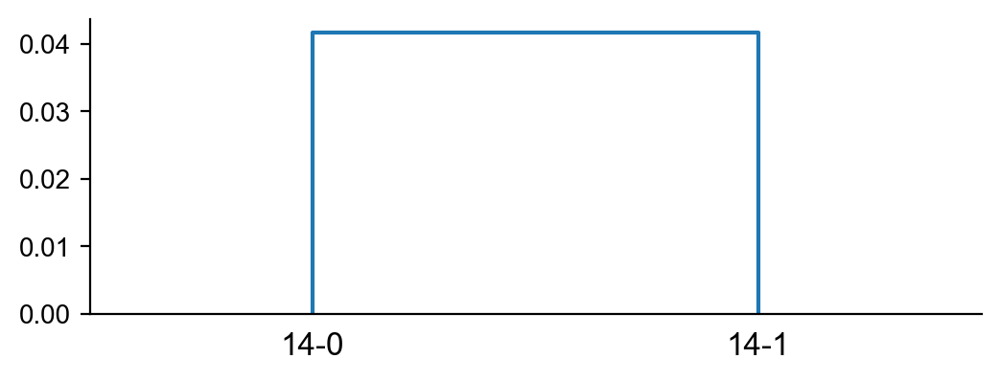

2025-06-12 16:37:36.396 | INFO     | jpy_tools.singleCellTools.others:calucatePvalueForEachSplitUseScshc:1006 - start calculating p-value for each split


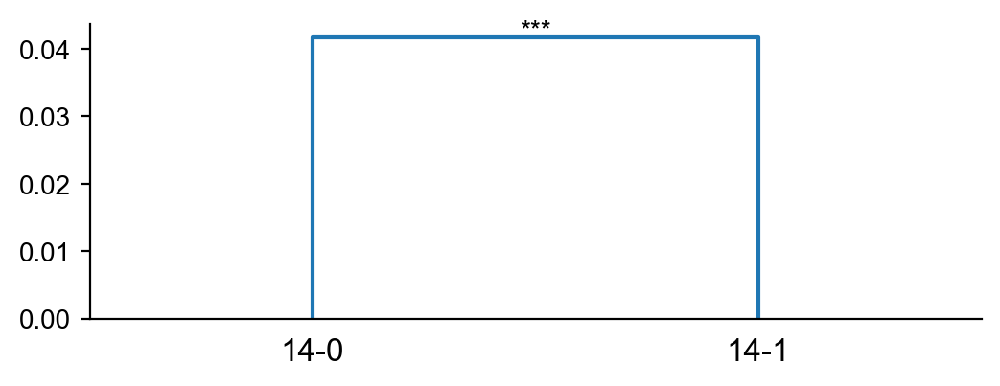

In [ ]:
ead_sub.cl.calculateSplitPvalueByScshc(
    ls_hvg=ead_sub.var.query("highly_variable").index.tolist(), clusterKey='Cluster_ft', figsize=(6,2)
)

# Anno

In [ ]:
ead

enhancedAnndata: AnnData object with n_obs × n_vars = 498376 × 32833
    obs: 'Sample', 'Replicates', 'Time', 'All_label', 'Hormone', 'ft_anno_prev', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_Mito_Chlo', 'log1p_total_counts_Mito_Chlo', 'pct_counts_Mito_Chlo', '__group', 'Treatment', 'Cluster', 'Cluster_0.95', 'Cluster_1.25', 'over_clustering', 'Cluster_1.3', 'Cluster_1.5', 'Cluster_19', 'Cluster_19_9', 'Cluster_19_9_8', 'Cluster_19_9_21', 'Cluster_ft', 'Cluster_ft_anno', 'sketch', 'Cluster_19_9_21_14'
    var: 'Mito_Chlo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable'
    uns: 'ABA_05h-Rep1_sct_clip_range', 'ABA_05h-Rep1_sct_vst_pickle', 'ABA_05h-Rep2_sct_clip_range', 'ABA_05h-Rep2_sct_vst_pickle', 'ABA_3h-Rep1_sct_clip_range', 'ABA_3h-Rep1_sct_vst_pickle', 'ABA_3h-Rep2_sct_clip_range', 'ABA_3h-Rep2_sct_vst_pickle', 'AUX_05h-Rep1_sct_clip

In [ ]:
sr_anno = ead.obs[['Cluster_ft', 'ft_anno_prev']].dropna().value_counts().unstack().fillna(0).astype(int).idxmax(1).map(lambda _: _.split(':')[1].strip())
sr_anno = sr_anno.index.astype(str) + ': ' + sr_anno.astype(str)
dt_anno = sr_anno.to_dict()

In [ ]:
dt_anno['14-1'] = "14-1: Root cap"

In [ ]:
ead.obs['Cluster_ft_anno'] = ead.obs['Cluster_ft'].map(dt_anno)

In [ ]:
dt_color = {
    "0: Mesophyll Cell": "aquamarine",
    "1: Mesophyll Cell": "mediumaquamarine",
    "2: Atrichoblast (Maturation)": "mistyrose",
    "3: Shoot Epidermal Cell": "chartreuse",
    "4: Shoot Epidermal Cell": "limegreen",
    "5: Root Apical Meristem": "lightcoral",
    "6: Shoot Apical Meristem- Endodermis- Cortex": "palegreen",
    "7: Mesophyll Cell": "mediumturquoise",
    "8: Root Cortex (Maturation)": "orchid",
    "9-0: Procambium": "yellow",
    "9-1: Procambium": "khaki",
    "9-2: Xylem": "navajowhite",
    "10: Phleom": "goldenrod",
    "11: Mesophyll Cell": "paleturquoise",
    "12: Xylem Pole Pericycle": "darkorange",
    "13: Unknown": "slategray",
    "14-0: Unknown": "cadetblue",
    "14-1: Root cap": "darksalmon",
    "15: Phleom Pole Pericycle": "lightsalmon",
    "16: Mesophyll Cell": "mediumseagreen",
    "17: Root Endodermis (Suberization) (Elongation)": "mediumvioletred",
    "18: Proliferating Cell (G2 Phase)": "tan",
    "19-0: Root Cortex (Meristem)": "purple",
    "19-1: Root Endodermis (Meristem)": "violet",
    "19-2: Root Cortex (Elongation)": "fuchsia",
    "20: Proliferating Cell (G1 and S Phase)": "wheat",
    "21-0: Root Epidermal Cell (Meristem)": "brown",
    "21-1: Trichoblast (Maturation)": "peru",
    "21-2: Root Epidermal Cell (Elongation)": "red",
    "22: Unknown": "steelblue",
    "23: Root Endodermis (Suberization) (Maturation)": "sandybrown",
    "24: Guard Cell": "darkgreen",
    "25: Proliferating Cell (M Phase)": "darkgoldenrod",
    "26: Root Endodermis (Casparian Strip) (Maturation)": "crimson",
    "27: Unknown": "lightsteelblue",
}
ead.pl.setAdColors('Cluster_ft_anno', dt_color)

2024-05-29 16:22:46.893 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1590 - ls_color: Index(['0: Mesophyll Cell', '1: Mesophyll Cell',
       '2: Atrichoblast (Maturation)', '3: Shoot Epidermal Cell',
       '4: Shoot Epidermal Cell', '5: Root Apical Meristem',
       '6: Shoot Apical Meristem- Endodermis- Cortex', '7: Mesophyll Cell',
       '8: Root Cortex (Maturation)', '9-0: Procambium', '9-1: Procambium',
       '9-2: Xylem', '10: Phleom (Companion cell)', '11: Mesophyll Cell',
       '12: Xylem Pole Pericycle', '13: Unknown', '14-0: Unknown',
       '14-1: Root cap', '15: Phleom Pole Pericycle', '16: Mesophyll Cell',
       '17: Root Endodermis (Suberization) (Elongation)',
       '18: Proliferating Cell (G2 Phase)', '19-0: Root Cortex (Meristem)',
       '19-1: Root Endodermis (Meristem)', '19-2: Root Cortex (Elongation)',
       '20: Proliferating Cell (G1 and S Phase)',
       '21-0: Root Epidermal Cell (Meristem)',
       '21-1: Trichoblast (Maturation)',
      

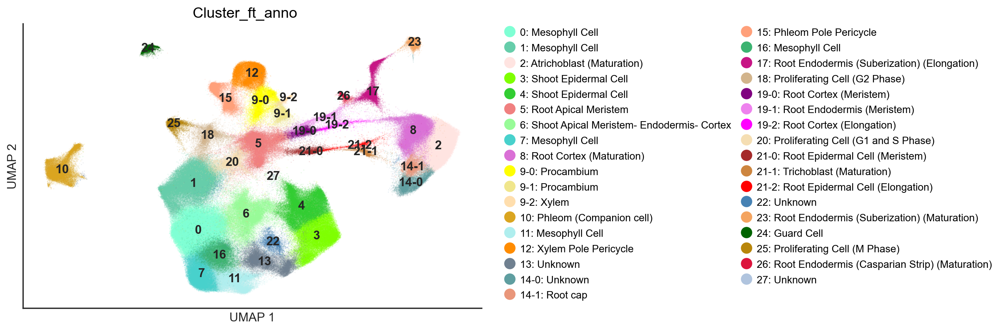

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_ft_anno', figsize=(8, 5), size=0.05, legendCol=2, legendInFig=True)
fig

2024-11-05 18:47:41.087 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1591 - ls_color: Index(['0: Mesophyll Cell', '1: Mesophyll Cell',
       '2: Atrichoblast (Maturation)', '3: Shoot Epidermal Cell',
       '4: Shoot Epidermal Cell', '5: Root Apical Meristem',
       '6: Shoot Apical Meristem- Endodermis- Cortex', '7: Mesophyll Cell',
       '8: Root Cortex (Maturation)', '9-0: Procambium', '9-1: Procambium',
       '9-2: Xylem', '10: Phleom (Companion cell)', '11: Mesophyll Cell',
       '12: Xylem Pole Pericycle', '13: Unknown', '14-0: Unknown',
       '14-1: Root cap', '15: Phleom Pole Pericycle', '16: Mesophyll Cell',
       '17: Root Endodermis (Suberization) (Elongation)',
       '18: Proliferating Cell (G2 Phase)', '19-0: Root Cortex (Meristem)',
       '19-1: Root Endodermis (Meristem)', '19-2: Root Cortex (Elongation)',
       '20: Proliferating Cell (G1 and S Phase)',
       '21-0: Root Epidermal Cell (Meristem)',
       '21-1: Trichoblast (Maturation)',
      

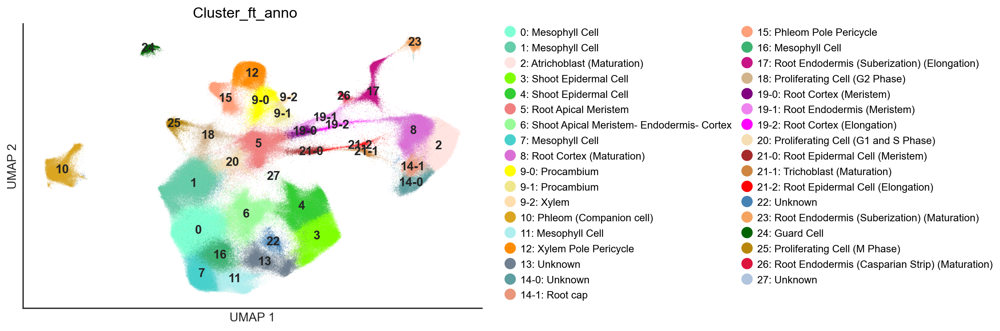

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_ft_anno', figsize=(8, 5), size=0.05, legendCol=2, legendInFig=True)
fig

In [ ]:
dt_color = {x.split(':')[0]:y for x,y in dt_color.items()}
ead.pl.setAdColors('Cluster_ft', dt_color)

In [ ]:
toPkl(ead.ad, 'ad_apr_embedding_0523_sct', 'ipf', dir_path=dir_result)

2024-05-25 11:27:31.056 | INFO     | jpy_tools.otherTools:toPkl:482 - please run `loadPkl('ad_apr_embedding_0523_sct', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


# Call Spec Genes

In [ ]:
ead = singleCellTools.EnhancedAnndata(loadPkl('ad_apr_embedding_0523_sct', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_result))

2024-05-24 19:07:33.100 | WARNING  | jpy_tools.singleCellTools:rawLayer:446 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


In [ ]:
import geosketch

In [ ]:
ls_sketch = geosketch.gs(ead.obsm['X_pca_harmony'], N=150000, seed=39, replace=False, verbose=2)
ead.obs['sketch'] = False
ead.obs.iloc[ls_sketch, ead.obs.columns.tolist().index('sketch')] = True

2024-05-24 16:23:04.876863 | [geosketch] n_iter = 0
2024-05-24 16:26:28.830138 | [geosketch] Found 39269 non-empty grid cells
2024-05-24 16:26:28.836340 | [geosketch] Grid size 39269, decrease unit to 0.125
2024-05-24 16:26:28.839678 | [geosketch] n_iter = 1
2024-05-24 16:29:48.189385 | [geosketch] Found 195370 non-empty grid cells
2024-05-24 16:29:48.191068 | [geosketch] Grid size 195370, increase unit to 0.1875
2024-05-24 16:29:48.192201 | [geosketch] n_iter = 2
2024-05-24 16:33:08.932700 | [geosketch] Found 272927 non-empty grid cells
2024-05-24 16:33:08.934249 | [geosketch] Grid size 272927, increase unit to 0.21875
2024-05-24 16:33:08.935293 | [geosketch] n_iter = 3
2024-05-24 16:36:28.838298 | [geosketch] Found 121838 non-empty grid cells
2024-05-24 16:36:28.841866 | [geosketch] Grid size 121838, decrease unit to 0.203125
2024-05-24 16:36:28.843307 | [geosketch] n_iter = 4
2024-05-24 16:39:47.922887 | [geosketch] Found 210092 non-empty grid cells
2024-05-24 16:39:47.925994 | [geo

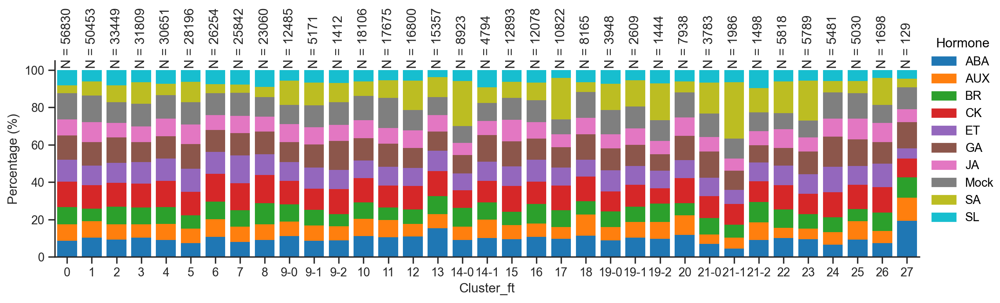

In [ ]:
ead.pl.clusterPercentage(x='Cluster_ft', y='Hormone', figsize=(12,4))[1]

In [ ]:
ead_sketch = ead[ead.obs['sketch']]
ead_sketch

2024-05-25 11:28:17.811 | WARNING  | jpy_tools.singleCellTools:rawLayer:446 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


enhancedAnndata: AnnData object with n_obs × n_vars = 150000 × 32833
    obs: 'Sample', 'Replicates', 'Time', 'All_label', 'Hormone', 'ft_anno_prev', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_Mito_Chlo', 'log1p_total_counts_Mito_Chlo', 'pct_counts_Mito_Chlo', '__group', 'Treatment', 'Cluster', 'Cluster_0.95', 'Cluster_1.25', 'over_clustering', 'Cluster_1.3', 'Cluster_1.5', 'Cluster_19', 'Cluster_19_9', 'Cluster_19_9_8', 'Cluster_19_9_21', 'Cluster_ft', 'Cluster_ft_anno', 'sketch', 'Cluster_19_9_21_14'
    var: 'Mito_Chlo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable'
    uns: 'ABA_05h-Rep1_sct_clip_range', 'ABA_05h-Rep1_sct_vst_pickle', 'ABA_05h-Rep2_sct_clip_range', 'ABA_05h-Rep2_sct_vst_pickle', 'ABA_3h-Rep1_sct_clip_range', 'ABA_3h-Rep1_sct_vst_pickle', 'ABA_3h-Rep2_sct_clip_range', 'ABA_3h-Rep2_sct_vst_pickle', 'AUX_05h-Rep1_sct_clip

In [ ]:
sc.pp.filter_genes(ead_sketch.ad, min_cells=3)

In [ ]:
ead_sketch

enhancedAnndata: AnnData object with n_obs × n_vars = 150000 × 26593
    obs: 'Sample', 'Replicates', 'Time', 'All_label', 'Hormone', 'ft_anno_prev', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_Mito_Chlo', 'log1p_total_counts_Mito_Chlo', 'pct_counts_Mito_Chlo', '__group', 'Treatment', 'Cluster', 'Cluster_0.95', 'Cluster_1.25', 'over_clustering', 'Cluster_1.3', 'Cluster_1.5', 'Cluster_19', 'Cluster_19_9', 'Cluster_19_9_8', 'Cluster_19_9_21', 'Cluster_ft', 'Cluster_ft_anno', 'sketch', 'Cluster_19_9_21_14'
    var: 'Mito_Chlo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'n_cells'
    uns: 'ABA_05h-Rep1_sct_clip_range', 'ABA_05h-Rep1_sct_vst_pickle', 'ABA_05h-Rep2_sct_clip_range', 'ABA_05h-Rep2_sct_vst_pickle', 'ABA_3h-Rep1_sct_clip_range', 'ABA_3h-Rep1_sct_vst_pickle', 'ABA_3h-Rep2_sct_clip_range', 'ABA_3h-Rep2_sct_vst_pickle', 'AUX_05h-Re

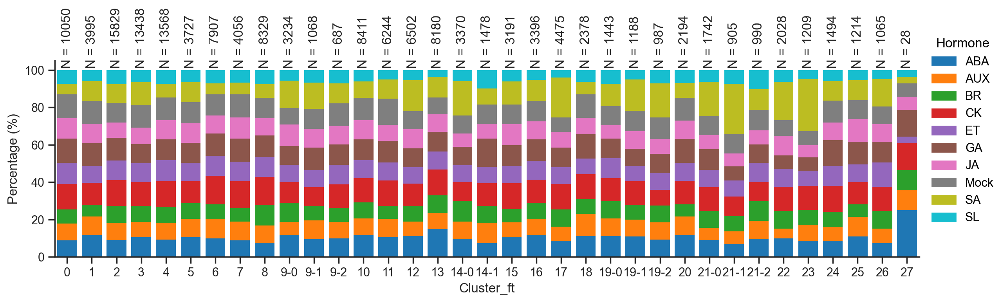

In [ ]:
ead_sketch.pl.clusterPercentage(x='Cluster_ft', y='Hormone', figsize=(12,4))[1]

In [ ]:
ead_sketch.cl.getClusterSpecGeneByCellex("Cluster_ft")

In [ ]:
fig = ead.pl.embedding('umap', 'Cluster_ft_anno', figsize=(8, 5), size=0.05, legendCol=2, legendInFig=True)
fig

In [ ]:
ead.uns['Cluster_ft_cellexES_sketch'] = ead_sketch.uns['Cluster_ft_cellexES']

In [ ]:
def getCutoffCorrespondingGeneCounts(df, cutoff):
    df = df.query("enrichScore > @cutoff", engine='python').value_counts("Cluster_ft", sort=False).rename(cutoff)
    return df

ls_sr = []
for cutoff in np.arange(0.8, 1.05, 0.05):
    sr = getCutoffCorrespondingGeneCounts(ead.uns['Cluster_ft_cellexES_sketch'], cutoff)
    ls_sr.append(sr)
pd.concat(ls_sr, axis=1).T

Cluster_ft,0,1,2,3,4,5,6,7,8,9-0,...,20,21-0,21-1,21-2,22,23,24,25,26,27
0.80,669,460,511,465,523,710,410,387,486,438,...,312,383,463,404,236,225,231,361,285,166
0.85,476,343,344,338,370,495,298,290,346,320,...,235,266,356,296,177,171,174,281,203,127
0.90,274,211,214,213,230,276,191,184,186,190,...,163,186,240,180,107,113,122,191,127,91
0.95,114,87,86,90,89,100,80,86,74,77,...,83,82,115,75,57,50,58,85,59,46
1.00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
dt_specGenes = (
    ead.uns["Cluster_ft_cellexES_sketch"]
    .query("enrichScore > 0.95")
    .sort_values(["Cluster_ft", "enrichScore"], ascending=[True, False])
    .groupby("Cluster_ft")["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
h = ead.pl.heatmapGeneExp(
    None,
    ls_leftAnno=["Cluster_ft"],
    dt_genes=dt_specGenes,
    height=20,
    width=15,
    standardScale=0,
)

In [ ]:
h.render()

In [ ]:
ead.uns["Cluster_ft_cellexES_sketch"][["gene", "Cluster_ft", "enrichScore"]].query("enrichScore > 0.95").rename(
    columns={'enrichScore': 'Specificity Score', 'gene': 'Gene', 'Cluster_ft': 'Cluster'}
).to_excel("/datapool/data/Users/zhijian/projects/hormone/publication/specGene.xlsx")

# Anno By Jaccard

In [ ]:
ad_pub = sc.read_h5ad('/datapool/data/Users/zhijian/projects/hormone/ad_pub.h5ad')

In [ ]:
dt_pubSpec = ad_pub.uns["pub_cellex_cellexES"].query("enrichScore > 0.8").sort_values(
    ["celltype", "enrichScore"], ascending=[True, False]
).groupby("celltype")["gene"].agg(list).to_dict()

In [ ]:
dt_specGenes = (
    ead.uns["Cluster_ft_cellexES_sketch"]
    .query("enrichScore > 0.95")
    .sort_values(["Cluster_ft", "enrichScore"], ascending=[True, False])
    .groupby("Cluster_ft")["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
df_jaccard = pd.DataFrame(index=dt_pubSpec.keys(), columns=dt_specGenes.keys())
for pub, spec in product(dt_pubSpec.keys(), dt_specGenes.keys()):
    set_pub = set(dt_pubSpec[pub])
    set_spec = set(dt_specGenes[spec])
    if len(set_pub) == 0 or len(set_spec) == 0:
        continue
    jaccard = len(set_pub & set_spec) / len(set_pub | set_spec)
    df_jaccard.loc[pub, spec] = jaccard
df_jaccard = df_jaccard.fillna(0)

In [ ]:
ls_clusterPubOrder = [
    # Shoot
    '15: companion cell',
    '2: epidermal cell', '12: epidermal cell', '14: epidermal cell', '18: epidermal cell',
    '11: guard cell',
    '0: mesophyll cell', '3: mesophyll cell', '4: mesophyll cell', '16: mesophyll cell',
    '5: proliferating cell', '9: proliferating cell', '17: proliferating cell', '19: proliferating cell',
    '20: shoot endodermis',
    '1: shoot meristematic cell', '13: shoot meristematic cell',
    '8: undefined cell', '21: undefined cell',
    '6: vascular cell', '7: vascular cell', '10: vascular cell', '22: vascular cell',

    # Root
    'Meristem_Atrichoblast',   'Elongation_Atrichoblast',   'Maturation_Atrichoblast',
    'Meristem_Cortex',         'Elongation_Cortex',         'Maturation_Cortex',
    'Distal Columella',        'Distal Lateral Root Cap',
    'Meristem_Endodermis',     'Elongation_Endodermis',     'Maturation_Endodermis',
    'Meristem_Pericycle',      'Elongation_Pericycle',      'Maturation_Pericycle',
    'Meristem_Phloem',         'Elongation_Phloem',         'Maturation_Phloem',
    'Meristem_Procambium',     'Elongation_Procambium',     'Maturation_Procambium',
    'Proximal Columella',      'Proximal Lateral Root Cap',
    'Meristem_Quiescent Center',
    'Meristem_Trichoblast',    'Elongation_Trichoblast',    'Maturation_Trichoblast',
    'Meristem_Xylem',          'Elongation_Xylem',          'Maturation_Xylem'
]

In [ ]:
df_jaccard = df_jaccard.loc[ls_clusterPubOrder]

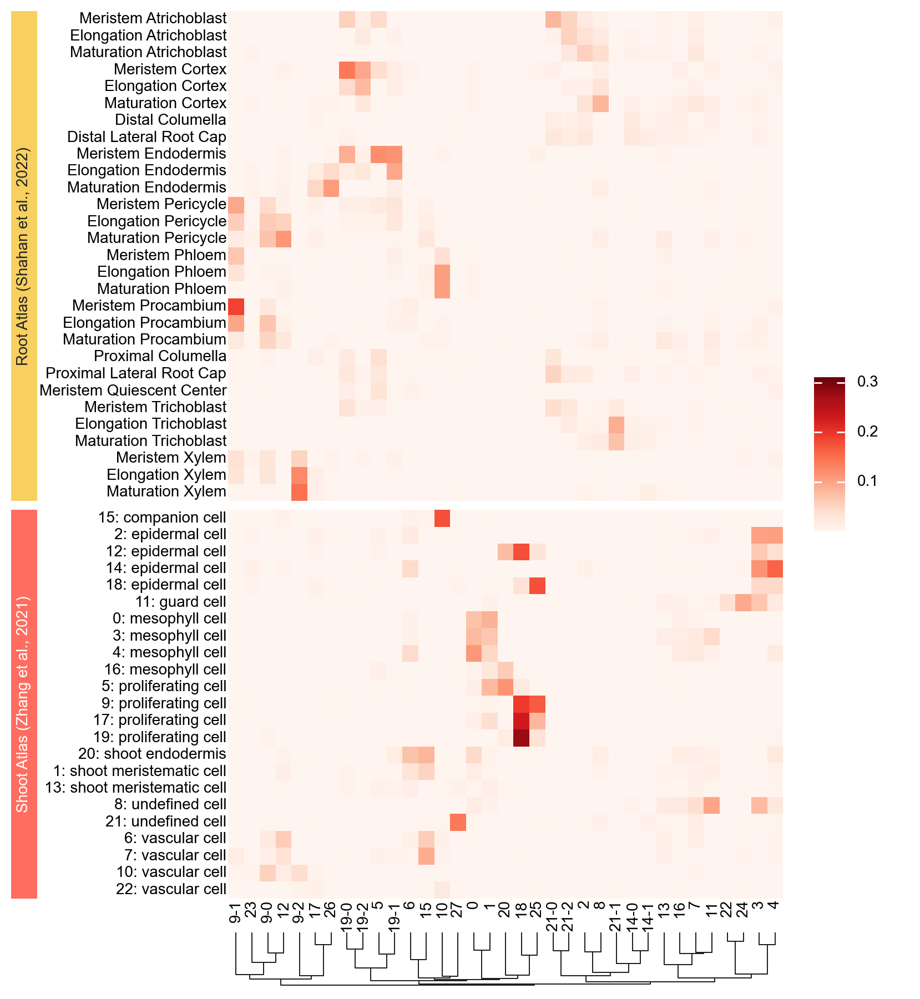

In [ ]:
h = ma.Heatmap(df_jaccard.values, cmap='Reds', width=5, height=8, vmax=0.31)
h.group_rows(df_jaccard.index.map(
    lambda _: (
        "Shoot Atlas (Zhang et al., 2021)"
        if ":" in _
        else "Root Atlas (Shahan et al., 2022)"
    )
))
h.add_left(mp.Labels(df_jaccard.index.map(lambda _: _.replace("_", ' '))))
h.add_left(
    mp.Chunk(["Root Atlas (Shahan et al., 2022)", "Shoot Atlas (Zhang et al., 2021)"], ['#f7d060', '#ff6d60'])
)
h.add_bottom(
    mp.Labels(df_jaccard.columns)
)
h.add_dendrogram(
    'bottom', metric='correlation', method='complete'
)
h.add_legends()
h.render()

## without re-cluster

In [ ]:
ead_sketch = ead[ead.obs['sketch']].copy()

In [ ]:
ead_sketch.cl.getClusterSpecGeneByCellex(
    'Cluster_1.3'
)

cutoff       0.60  0.70  0.80  0.90  0.95  0.99
Cluster_1.3                                    
5            1477  1088   690   275   106     8
21           1346  1024   677   314   136     6
0            1343   972   594   238    99     6
19           1261   915   585   284   120    15
14           1206   878   543   212    67     4
2            1171   853   538   233    84     2
9            1126   825   554   254   112    12
8            1071   797   509   201    78     6
4            1026   779   505   219    84     6
18           1013   748   496   264   120    18
10           1003   753   488   216    74     0
3             993   719   459   208    89     8
13            968   702   443   180    68     9
11            896   660   430   185    77     4
1             875   634   422   187    76     1
6             824   590   393   174    72    11
17            774   592   379   175    80     2
12            761   569   388   173    78    13
7             670   507   337   157    6

In [ ]:
dt_specGenes = (
    ead_sketch.uns["Cluster_1.3_cellexES"]
    .query("enrichScore > 0.95")
    .sort_values(["Cluster_1.3", "enrichScore"], ascending=[True, False])
    .groupby("Cluster_1.3")["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
df_jaccard = pd.DataFrame(index=dt_pubSpec.keys(), columns=dt_specGenes.keys())
for pub, spec in product(dt_pubSpec.keys(), dt_specGenes.keys()):
    set_pub = set(dt_pubSpec[pub])
    set_spec = set(dt_specGenes[spec])
    if len(set_pub) == 0 or len(set_spec) == 0:
        continue
    jaccard = len(set_pub & set_spec) / len(set_pub | set_spec)
    df_jaccard.loc[pub, spec] = jaccard
df_jaccard = df_jaccard.fillna(0)

In [ ]:
ls_clusterPubOrder = [
    # Shoot
    '15: companion cell',
    '2: epidermal cell', '12: epidermal cell', '14: epidermal cell', '18: epidermal cell',
    '11: guard cell',
    '0: mesophyll cell', '3: mesophyll cell', '4: mesophyll cell', '16: mesophyll cell',
    '5: proliferating cell', '9: proliferating cell', '17: proliferating cell', '19: proliferating cell',
    '20: shoot endodermis',
    '1: shoot meristematic cell', '13: shoot meristematic cell',
    '8: undefined cell', '21: undefined cell',
    '6: vascular cell', '7: vascular cell', '10: vascular cell', '22: vascular cell',

    # Root
    'Meristem_Atrichoblast',   'Elongation_Atrichoblast',   'Maturation_Atrichoblast',
    'Meristem_Cortex',         'Elongation_Cortex',         'Maturation_Cortex',
    'Distal Columella',        'Distal Lateral Root Cap',
    'Meristem_Endodermis',     'Elongation_Endodermis',     'Maturation_Endodermis',
    'Meristem_Pericycle',      'Elongation_Pericycle',      'Maturation_Pericycle',
    'Meristem_Phloem',         'Elongation_Phloem',         'Maturation_Phloem',
    'Meristem_Procambium',     'Elongation_Procambium',     'Maturation_Procambium',
    'Proximal Columella',      'Proximal Lateral Root Cap',
    'Meristem_Quiescent Center',
    'Meristem_Trichoblast',    'Elongation_Trichoblast',    'Maturation_Trichoblast',
    'Meristem_Xylem',          'Elongation_Xylem',          'Maturation_Xylem'
]

In [ ]:
df_jaccard = df_jaccard.loc[ls_clusterPubOrder]

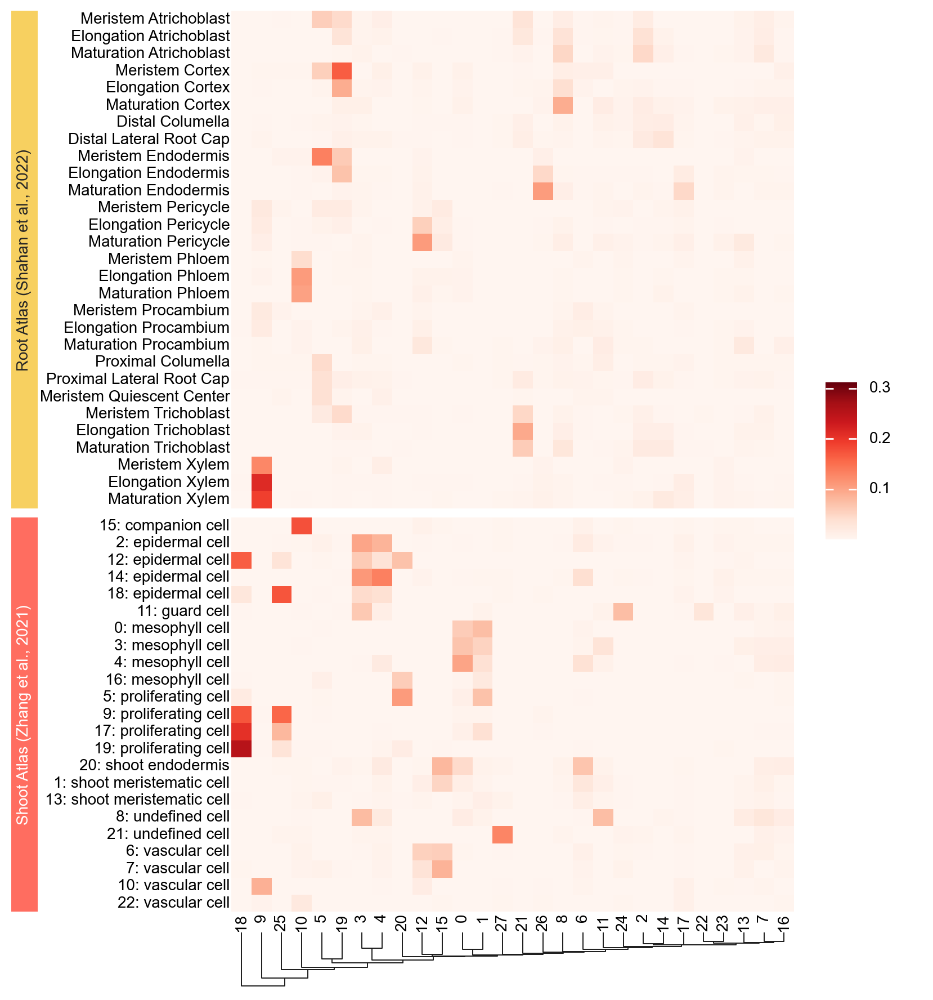

In [ ]:
h = ma.Heatmap(df_jaccard.values, cmap='Reds', width=5, height=8, vmax=0.31)
h.group_rows(df_jaccard.index.map(
    lambda _: (
        "Shoot Atlas (Zhang et al., 2021)"
        if ":" in _
        else "Root Atlas (Shahan et al., 2022)"
    )
))
h.add_left(mp.Labels(df_jaccard.index.map(lambda _: _.replace("_", ' '))))
h.add_left(
    mp.Chunk(["Root Atlas (Shahan et al., 2022)", "Shoot Atlas (Zhang et al., 2021)"], ['#f7d060', '#ff6d60'])
)
h.add_bottom(
    mp.Labels(df_jaccard.columns)
)
h.add_dendrogram(
    'bottom', method='average'
)
h.add_legends()
h.render()

In [ ]:
df_marker = """
Pericycle	NPF7.3	AT1G32450
Pericycle	PHO1	AT3G23430
Pericycle	CALS8	AT3G14570
Procambium		AT4G14650
Procambium		AT1G25530
Phloem (Companion cell)	NAKR1	AT5G02600
Phloem (Companion cell)	SUC2	AT1G22710
Xylem	VND7	AT1G71930
Xylem	MYB46	AT5G12870
Proliferating Cell	ATPCNA2	AT2G29570
Proliferating Cell	TSO2	AT3G27060
Proliferating Cell	CDKB2;1	AT1G76540
Proliferating Cell	CYCA1;1	AT1G44110
Proliferating Cell	AtMAD2	AT3G25980
Proliferating Cell	AtENODL15	AT4G31840
""".split('\n')[1:-1] >> F(map, lambda _: _.split('\t')) >> F(list) >> F(pd.DataFrame, columns=['Cluster', 'Gene', 'GeneID'])
df_marker

,Cluster,Gene,GeneID
0,Pericycle,NPF7.3,AT1G32450
1,Pericycle,PHO1,AT3G23430
2,Pericycle,CALS8,AT3G14570
3,Procambium,,AT4G14650
4,Procambium,,AT1G25530
5,Phloem (Companion cell),NAKR1,AT5G02600
6,Phloem (Companion cell),SUC2,AT1G22710
7,Xylem,VND7,AT1G71930
8,Xylem,MYB46,AT5G12870
9,Proliferating Cell,ATPCNA2,AT2G29570


Cluster: Pericycle


2025-07-05 12:52:16.738 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:52:26.610 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:52:36.273 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333


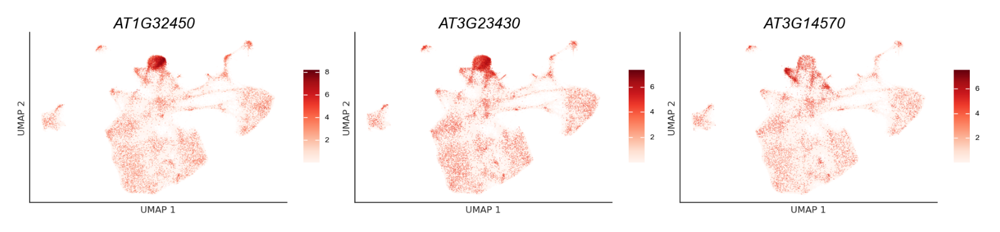

Cluster: Phloem (Companion cell)


2025-07-05 12:52:54.743 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:53:04.558 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333


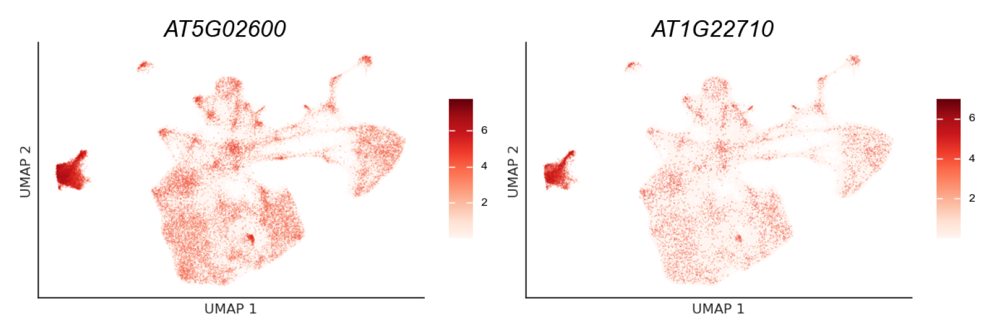

Cluster: Procambium


2025-07-05 12:53:14.384 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:53:24.021 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333


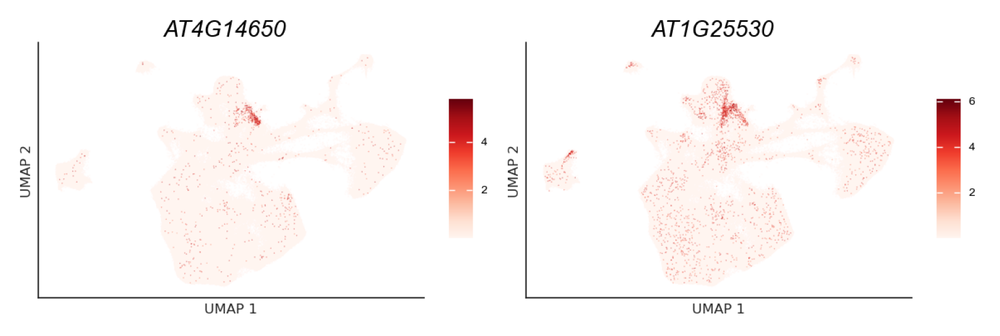

Cluster: Proliferating Cell


2025-07-05 12:53:34.023 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:53:43.647 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:53:53.420 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:54:03.027 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:54:12.850 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:54:22.507 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333


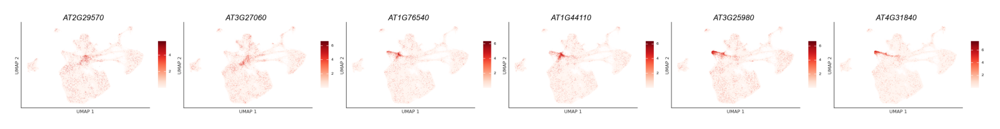

Cluster: Xylem


2025-07-05 12:54:32.739 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333
2025-07-05 12:54:42.331 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333


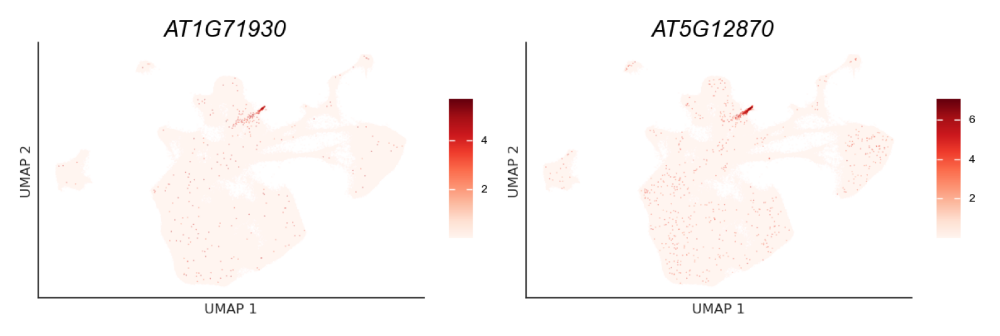

In [ ]:
_dt = df_marker.groupby('Cluster')['GeneID'].agg(list).to_dict()
from IPython.display import display
for cluster, genes in _dt.items():
    print(f"Cluster: {cluster}")
    with mpl.rc_context({'figure.titlesize': 20}):
        fig = ead.pl.embedding(color=genes, size=0.15, layer='normalize_log', figsize=(6,4), wrap=6).show()
    display(fig)

# Call DEG

In [ ]:
ead_05 = ead[ead.obs.eval("Time == 'Time05h'")]

2024-05-24 19:07:33.678 | WARNING  | jpy_tools.singleCellTools:rawLayer:446 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


In [ ]:
reloadPackages(singleCellTools)
ead_05 = singleCellTools.EnhancedAnndata(ead_05.ad)

In [ ]:
ead_05.initDe(clusterKey='Cluster_ft', groupby='Sample', controlName="Mock_05h")

In [ ]:
ead_05.de.identifyDegUsePseudoBulk(replicateKey="Replicates", njobs=4)

  0%|          | 0/35 [00:00<?, ?it/s]2024-05-24 19:07:52.622 | INFO     | jpy_tools.singleCellTools.geneEnrichInfo:findDegUsePseudobulk:2284 - LRT test wrapped with edgeR
2024-05-24 19:07:52.624 | WARNING  | jpy_tools.singleCellTools.basic:testAllCountIsInt:318 - Make sure that adata.layer contains unnormalized count data	Layer:raw
2024-05-24 19:07:53.489 | INFO     | jpy_tools.singleCellTools.geneEnrichInfo:findDegUsePseudobulk:2316 - Control mode: control: Mock_05h
  3%|▎         | 1/35 [01:03<35:45, 63.10s/it]2024-05-24 19:08:52.397 | INFO     | jpy_tools.singleCellTools.geneEnrichInfo:findDegUsePseudobulk:2284 - LRT test wrapped with edgeR
2024-05-24 19:08:52.399 | WARNING  | jpy_tools.singleCellTools.basic:testAllCountIsInt:318 - Make sure that adata.layer contains unnormalized count data	Layer:raw
2024-05-24 19:08:53.242 | INFO     | jpy_tools.singleCellTools.geneEnrichInfo:findDegUsePseudobulk:2316 - Control mode: control: Mock_05h
  6%|▌         | 2/35 [02:02<33:39, 61.21s/it]

,gene,logFC,logCPM,LR,PValue,fdr,a,b,cluster
0,AT1G01010,0.040919,5.176193,0.013451,0.907671,0.989812,Mock_05h,AUX_05h,0
1,AT1G01020,-0.140997,6.819870,0.403926,0.525069,0.931877,Mock_05h,AUX_05h,0
2,AT1G01030,0.194039,6.348849,0.564515,0.452447,0.915845,Mock_05h,AUX_05h,0
3,AT1G01040,-0.013199,8.522973,0.004181,0.948444,0.995737,Mock_05h,AUX_05h,0
4,AT1G01050,-0.370406,5.066063,1.653976,0.198419,0.800636,Mock_05h,AUX_05h,0
...,...,...,...,...,...,...,...,...,...
2471944,AT5G53460,-0.452593,13.389650,0.073778,0.785914,0.934306,Mock_05h,SA_05h,27
2471945,AT5G63530,0.963636,13.702373,0.462198,0.496599,0.840398,Mock_05h,SA_05h,27
2471946,ATMG00020,1.661475,13.369583,2.031907,0.154027,0.441991,Mock_05h,SA_05h,27
2471947,ATCG00020,-0.326934,15.524120,0.150274,0.698274,0.934306,Mock_05h,SA_05h,27


In [ ]:
ead_3 = ead[ead.obs.eval("Time == 'Time3h'")]

2024-05-24 19:29:54.770 | WARNING  | jpy_tools.singleCellTools:rawLayer:446 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


In [ ]:
ead_3.initDe(clusterKey='Cluster_ft', groupby='Sample', controlName="Mock_3h")
ead_3.de.identifyDegUsePseudoBulk(replicateKey="Replicates", njobs=8)

In [ ]:
ead.uns['de_Sample_deg'] = pd.concat([ead_05.uns['de_Sample_deg'], ead_3.uns['de_Sample_deg']]).reset_index(drop=True)

In [ ]:
ead.obs['Hormone'] = ead.obs['Hormone'].cat.set_categories([ 'Mock','AUX', 'CK', 'ABA','GA', 'SL',  'BR', 'ET', 'JA', 'SA' ])

In [ ]:
from itertools import product
ead.obs['Sample'] = ead.obs['Hormone'].astype(str) + '_' + ead.obs['Time'].astype(str).str.replace('Time', '')
ead.obs['Sample'] = ead.obs['Sample'].astype('category')
ead.obs['Sample'] = ead.obs['Sample'].cat.set_categories([f"{x}_{y}" for x,y in product(['Mock', 'AUX', 'CK', 'ABA','GA', 'SL',  'BR', 'ET', 'JA', 'SA'], ['05h', '3h'])])

In [ ]:
from itertools import product

ead.obs['All_label'] = ead.obs['All_label'].cat.set_categories([f"{x}_{y}-{z}" for x,y,z in product(['Mock', 'AUX', 'CK', 'ABA','GA', 'SL',  'BR', 'ET', 'JA', 'SA'], ['05h', '3h'], ['Rep1', 'Rep2'])])

In [ ]:
toPkl(ead.ad, 'ad_apr_embedding_0523_sct', 'ipf', dir_path=dir_result)

2024-05-25 13:31:25.123 | INFO     | jpy_tools.otherTools:toPkl:482 - please run `loadPkl('ad_apr_embedding_0523_sct', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


In [ ]:
ead = singleCellTools.EnhancedAnndata(loadPkl('ad_apr_embedding_0523_sct', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_result))

## DEG mock different Time

In [ ]:
ead_mock = ead[ead.obs.eval("Hormone == 'Mock'")].copy()

In [ ]:
ead_mock.initDe(clusterKey='Cluster_ft', groupby='Sample', controlName="Mock_05h")
ead_mock.de.identifyDegUsePseudoBulk(replicateKey="Replicates", njobs=8)

Global seed set to 0
  0%|          | 0/35 [00:00<?, ?it/s]2024-11-08 14:18:04.270 | INFO     | jpy_tools.singleCellTools.geneEnrichInfo:findDegUsePseudobulk:2301 - LRT test wrapped with edgeR
2024-11-08 14:18:04.273 | WARNING  | jpy_tools.singleCellTools.basic:testAllCountIsInt:318 - Make sure that adata.layer contains unnormalized count data	Layer:raw
2024-11-08 14:18:04.607 | INFO     | jpy_tools.singleCellTools.geneEnrichInfo:findDegUsePseudobulk:2333 - Control mode: control: Mock_05h
  3%|▎         | 1/35 [00:15<08:55, 15.76s/it]2024-11-08 14:18:16.349 | INFO     | jpy_tools.singleCellTools.geneEnrichInfo:findDegUsePseudobulk:2301 - LRT test wrapped with edgeR
2024-11-08 14:18:16.352 | WARNING  | jpy_tools.singleCellTools.basic:testAllCountIsInt:318 - Make sure that adata.layer contains unnormalized count data	Layer:raw
2024-11-08 14:18:16.434 | INFO     | jpy_tools.singleCellTools.geneEnrichInfo:findDegUsePseudobulk:2333 - Control mode: control: Mock_05h
  6%|▌         | 2/35 [00

,gene,logFC,logCPM,LR,PValue,fdr,a,b,cluster
0,AT1G01010,-0.085145,4.231071,0.063744,0.800673,0.891129,Mock_05h,Mock_3h,0
1,AT1G01020,0.125850,6.976006,0.390166,0.532212,0.705851,Mock_05h,Mock_3h,0
2,AT1G01030,-0.436785,5.325830,2.948511,0.085957,0.210262,Mock_05h,Mock_3h,0
3,AT1G01040,0.181199,8.578555,0.930436,0.334750,0.531341,Mock_05h,Mock_3h,0
4,AT1G01050,-0.393324,5.205107,2.404610,0.120978,0.268876,Mock_05h,Mock_3h,0
...,...,...,...,...,...,...,...,...,...
193469,AT4G37870,1.277803,15.724348,4.124370,0.042270,0.176124,Mock_05h,Mock_3h,27
193470,AT5G07350,2.216069,14.802563,8.356060,0.003844,0.057561,Mock_05h,Mock_3h,27
193471,AT5G25970,-0.595315,14.753813,0.459387,0.497911,0.655146,Mock_05h,Mock_3h,27
193472,AT5G38940,-1.385058,15.032067,2.462706,0.116578,0.323827,Mock_05h,Mock_3h,27


In [ ]:
ead_mock.uns['de_Sample_deg'].query("logFC > 1 & fdr < 0.05").groupby('cluster').size()

cluster
0       1405
1        863
10       599
11      1025
12       567
13       478
14-0     281
14-1     253
15       436
16       656
17       340
18       275
19-0     156
19-1      80
19-2      59
2        963
20       335
21-0     185
21-1      62
21-2      72
22       206
23       155
24        95
25       189
26        11
3       1031
4        916
5        863
6        837
7        962
8        934
9-0      372
9-1      297
9-2       51
dtype: int64

## DEG NUMBER

In [ ]:
def plotGeneCounts(ead, filterCmd, cmap, subtitle, unsKey):
    dt_tissueLevel = {
        "Root Apical Meristem": ["5"],
        "Root Cap": ["14-1"],
        "Root Epidermal Cell": ["21-0", "21-2", "2", "21-1"],
        "Root Cortex": ["19-0", "19-2", "8"],
        "Root Endodermis": ["19-1", "17", "26", "23"],
        "Pericycle": ["15", "12"],
        "Procambium": ["9-0", "9-1"],
        "Phloem": ["10"],
        "Xylem": ["9-2"],
        "Proliferating Cell": ["20", "18", "25"],
        "Shoot Apical Meristem": ["6"],
        "Shoot Epidermal Cell": ["3", "4"],
        "Guard Cell": ["24"],
        "Mesophyll Cell": ["0", "1", "7", "11", "16"],
        "Unknown": ["13", "14-0", "22", "27"],
        "Whole Sample": ["All"],
    }
    # ls_palette = ls_palette
    ls_palette = [
        "#f08080",
        "#e9967a",
        "#a52a2a",
        "#da71d8",
        "#dc143c",
        "#ff8c00",
        "#ffff52",
        "#ffd700",
        "#ffdead",
        "#b8860b",
        "#98fb98",
        "#32cd32",
        "#006600",
        "#48d1cc",
        "#708090",
        "#000000",
    ]
    dt_cl2tissue = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}
    ls_hormones = ["AUX", "CK", "ABA", "GA", "SL", "BR", "ET", "JA", "SA"]

    df_countMtx = (
        ead.uns[unsKey]
        .query(filterCmd)
        .value_counts(["Time", "Hormone", "cluster"])
        .unstack()
        .T
    )
    df_countMtx = df_countMtx.reindex(dt_cl2tissue.keys()).fillna(0)
    df_countMtxScaled = df_countMtx.div(df_countMtx.max(axis=0), axis=1)

    h = ma.Heatmap(
        df_countMtxScaled.values,
        cmap=cmap,
        width=6,
        height=6,
        annot=df_countMtx.values,
        fmt=lambda _: int(_),
        annot_kws={"fontsize": 8},
    )
    h.group_cols(
        df_countMtx.columns.get_level_values(0), order=["0.5h", "3h"], spacing=0.02
    )
    h.group_rows(df_countMtx.index.map(dt_cl2tissue), order=dt_tissueLevel.keys())
    h.add_left(
        mp.Labels(df_countMtx.index, rotation=0, ha="right", fontsize=8), pad=0.1
    )
    h.add_left(
        mp.Colors(
            df_countMtx.index.map(dt_cl2tissue).tolist(),
            palette={x: y for x, y in zip(dt_tissueLevel.keys(), ls_palette)},
        ),
        size=0.2,
        pad=0.1,
        legend=False,
    )
    h.add_left(
        mp.Chunk(
            dt_tissueLevel.keys() >> F(list),
            props={"rotation": 0, "ha": "right", "fontsize": 10},
        ),
    )
    h.add_top(
        mp.Labels(
            df_countMtx.columns.get_level_values(1), rotation=0, ha="center", fontsize=8
        ),
        pad=0.05,
    )
    h.add_top(
        mp.Chunk(
            ["0.5 hours", "3 hours"] >> F(map, lambda _: f"{_} {subtitle}") >> F(list),
            props={"rotation": 0, "ha": "center", "fontsize": 10},
        ),
    )
    return h


def plotGeneOverlapRatioWithWholeSample(
    ead, filterCmd, cmap, subtitle, unsKey="de_concat_deg"
):
    dt_tissueLevel = {
        "Root Apical Meristem": ["5"],
        "Root Cap": ["14-1"],
        "Root Epidermal Cell": ["21-0", "21-2", "2", "21-1"],
        "Root Cortex": ["19-0", "19-2", "8"],
        "Root Endodermis": ["19-1", "17", "26", "23"],
        "Pericycle": ["15", "12"],
        "Procambium": ["9-0", "9-1"],
        "Phloem": ["10"],
        "Xylem": ["9-2"],
        "Proliferating Cell": ["20", "18", "25"],
        "Shoot Apical Meristem": ["6"],
        "Shoot Epidermal Cell": ["3", "4"],
        "Guard Cell": ["24"],
        "Mesophyll Cell": ["0", "1", "7", "11", "16"],
        "Unknown": ["13", "14-0", "22", "27"],
    }
    # ls_palette = ls_palette
    ls_palette = [
        "#f08080",
        "#e9967a",
        "#a52a2a",
        "#da71d8",
        "#dc143c",
        "#ff8c00",
        "#ffff52",
        "#ffd700",
        "#ffdead",
        "#b8860b",
        "#98fb98",
        "#32cd32",
        "#006600",
        "#48d1cc",
        "#708090",
    ]
    dt_cl2tissue = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}
    ls_hormones = ["AUX", "CK", "ABA", "GA", "SL", "BR", "ET", "JA", "SA"]
    df_overlapRatio05h = pd.DataFrame(index=dt_cl2tissue.keys(), columns=ls_hormones)
    df_overlapRatio3h = pd.DataFrame(index=dt_cl2tissue.keys(), columns=ls_hormones)
    df_passDeg = ead.uns[unsKey].query(filterCmd).copy()
    from itertools import product
    dt_wholeSample = {}
    for hormone, cluster in product(ls_hormones, dt_cl2tissue.keys()):
        dt_wholeSample[(hormone, cluster, '05h')] = dt_wholeSample.get((hormone, cluster, '05h'), df_passDeg.query(f"Hormone == '{hormone}' & Time == '0.5h' & cluster == 'All'")['gene'].unique())
        ls_wholeSample05h = dt_wholeSample[(hormone, cluster, '05h')]
        dt_wholeSample[(hormone, cluster, '3h')] = dt_wholeSample.get((hormone, cluster, '3h'), df_passDeg.query(f"Hormone == '{hormone}' & Time == '3h' & cluster == 'All'")['gene'].unique())
        ls_wholeSample3h = dt_wholeSample[(hormone, cluster, '3h')]

        ls_cluster05h = df_passDeg.query(f"Hormone == '{hormone}' & Time == '0.5h' & cluster == '{cluster}'")['gene'].unique()
        ls_cluster3h = df_passDeg.query(f"Hormone == '{hormone}' & Time == '3h' & cluster == '{cluster}'")['gene'].unique()
        # print(len(set(ls_cluster05h) - set(ls_wholeSample05h)) / len(set(ls_cluster05h)))
        if len(set(ls_cluster05h)) == 0:
            df_overlapRatio05h.loc[cluster, hormone] = 0
        else:
            df_overlapRatio05h.loc[cluster, hormone] = len(set(ls_cluster05h) - set(ls_wholeSample05h)) / len(set(ls_cluster05h))
        if len(set(ls_cluster3h)) == 0:
            df_overlapRatio3h.loc[cluster, hormone] = 0
        else:
            df_overlapRatio3h.loc[cluster, hormone] = len(set(ls_cluster3h) - set(ls_wholeSample3h)) / len(set(ls_cluster3h))
    df_overlapRatio = pd.concat([df_overlapRatio05h, df_overlapRatio3h], keys=['0.5h', '3h'], axis=1)
    df_overlapRatio = df_overlapRatio.fillna(0)
    h = ma.Heatmap(
        df_overlapRatio.values,
        cmap=cmap,
        width=6,
        height=6,
        annot=df_overlapRatio.values,
        fmt=lambda _: round(_, 2),
        annot_kws={"fontsize": 8},
    )
    h.group_cols(
        df_overlapRatio.columns.get_level_values(0), order=["0.5h", "3h"], spacing=0.02
    )
    h.group_rows(df_overlapRatio.index.map(dt_cl2tissue), order=dt_tissueLevel.keys())
    h.add_left(
        mp.Labels(df_overlapRatio.index, rotation=0, ha="right", fontsize=8), pad=0.1
    )
    h.add_left(
        mp.Colors(
            df_overlapRatio.index.map(dt_cl2tissue).tolist(),
            palette={x: y for x, y in zip(dt_tissueLevel.keys(), ls_palette)},
        ),
        size=0.2,
        pad=0.1,
        legend=False,
    )
    h.add_left(
        mp.Chunk(
            dt_tissueLevel.keys() >> F(list),
            props={"rotation": 0, "ha": "right", "fontsize": 10},
        ),
    )
    h.add_top(
        mp.Labels(
            df_overlapRatio.columns.get_level_values(1), rotation=0, ha="center", fontsize=8
        ),
        pad=0.05,
    )
    h.add_top(
        mp.Chunk(
            ["0.5 hours", "3 hours"] >> F(map, lambda _: f"{_} {subtitle}") >> F(list),
            props={"rotation": 0, "ha": "center", "fontsize": 10},
        ),
    )
    return h

In [ ]:
ead.uns['de_concat_deg'] = pd.concat([ead.uns['de_All_deg'], ead.uns['de_Sample_deg']], ignore_index=True)

In [ ]:
ead.uns['de_All_deg'].query("logFC.abs() > 1 & fdr < 0.05").to_excel(
    "/datapool/data/Users/zhijian/projects/hormone/publication/deg_sampleL.xlsx"
)

In [ ]:
a = ead.uns['de_concat_deg'].query("logFC > 1 & fdr < 0.05").query("Hormone == 'CK' & Time == '3h' & cluster == 'All'")['gene'].unique()

In [ ]:
b = ead.uns['de_concat_deg'].query("logFC > 1 & fdr < 0.05").query("Hormone == 'CK' & Time == '3h' & cluster == '5'")['gene'].unique()

In [ ]:
len(set(b) - set(a)) / len(set(b))

0.5057471264367817

In [ ]:
filterCmd = "logFC > 1 & fdr < 0.05"
cmap = 'Blues'
subtitle = "Post Treatment\n(Up-regulated)"
df_degCounts = ead.uns['de_concat_deg'].query(filterCmd).query("cluster != 'All'").groupby(['cluster', 'Hormone', 'Time', 'GeneCategory']).size().rename('counts').reset_index()

In [ ]:
dt_tissueLevel = {
    "Root Apical Meristem": ["5"],
    "Root Cap": ["14-1"],
    "Root Epidermal Cell": ["21-0", "21-2", "2", "21-1"],
    "Root Cortex": ["19-0", "19-2", "8"],
    "Root Endodermis": ["19-1", "17", "26", "23"],
    "Pericycle": ["15", "12"],
    "Procambium": ["9-0", "9-1"],
    "Phloem": ["10"],
    "Xylem": ["9-2"],
    "Proliferating Cell": ["20", "18", "25"],
    "Shoot Apical Meristem": ["6"],
    "Shoot Epidermal Cell": ["3", "4"],
    "Guard Cell": ["24"],
    "Mesophyll Cell": ["0", "1", "7", "11", "16"],
    "Unknown": ["13", "14-0", "22", "27"],
}
ls_palette = [
    "#f08080",
    "#e9967a",
    "#a52a2a",
    "#da71d8",
    "#dc143c",
    "#ff8c00",
    "#ffff52",
    "#ffd700",
    "#ffdead",
    "#b8860b",
    "#98fb98",
    "#32cd32",
    "#006600",
    "#48d1cc",
    "#708090",
]
dt_cl2tissue = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}
dt_metaTissueLevel = {
    "Root": (
        dt_tissueLevel["Root Apical Meristem"]
        + dt_tissueLevel["Root Cap"]
        + dt_tissueLevel["Root Epidermal Cell"]
        + dt_tissueLevel["Root Cortex"]
        + dt_tissueLevel["Root Endodermis"]
    ),
    "Shoot": (
        dt_tissueLevel["Shoot Apical Meristem"]
        + dt_tissueLevel["Shoot Epidermal Cell"]
        + dt_tissueLevel["Guard Cell"]
        + dt_tissueLevel["Mesophyll Cell"]
    ),
    "Others": (
        dt_tissueLevel["Pericycle"]
        + dt_tissueLevel["Procambium"]
        + dt_tissueLevel["Phloem"]
        + dt_tissueLevel["Xylem"]
        + dt_tissueLevel["Proliferating Cell"]
    ),
    "Unknown": dt_tissueLevel["Unknown"],
}
dt_metaTissueLevelRev = {v: k for k, vs in dt_metaTissueLevel.items() for v in vs}

In [ ]:
df_degCounts['cellType'] = df_degCounts['cluster'].map(dt_cl2tissue)
df_degCounts['Hormone'] = df_degCounts['Hormone'].cat.set_categories(['AUX', 'CK', 'ABA','GA', 'SL',  'BR', 'ET', 'JA', 'SA' ])
df_degCounts['Tissue'] = df_degCounts['cluster'].map(dt_metaTissueLevelRev).astype('category').cat.set_categories(['Root', 'Shoot', 'Others', 'Unknown'])
df_degCounts

,cluster,Hormone,Time,GeneCategory,counts,cellType,Tissue
0,0,AUX,0.5h,Up,99,Mesophyll Cell,Shoot
1,0,AUX,3h,Up,50,Mesophyll Cell,Shoot
2,0,CK,0.5h,Up,400,Mesophyll Cell,Shoot
3,0,CK,3h,Up,602,Mesophyll Cell,Shoot
4,0,ABA,0.5h,Up,433,Mesophyll Cell,Shoot
...,...,...,...,...,...,...,...
625,9-2,ET,3h,Up,1,Xylem,Others
626,9-2,JA,0.5h,Up,18,Xylem,Others
627,9-2,JA,3h,Up,5,Xylem,Others
628,9-2,SA,0.5h,Up,46,Xylem,Others


In [ ]:
def reloadPackages(package):
    import importlib
    from types import ModuleType
    for p in dir(package):
        p = getattr(package, p)
        if isinstance(p, ModuleType):
            importlib.reload(p)
    importlib.reload(package)
reloadPackages(so)

In [ ]:
(
    so.Plot(df_degCounts, x='Tissue', y='counts', color='cluster',)
    .facet(row='Time', col='Hormone')
    .share(x=False, y=False)
    .add(so.Bar(), so.Stack(),)
    .layout(size=(4*9, 3*2))
)

In [ ]:
ead.uns["de_Sample_deg"].query("GeneCategory != 'Others'").to_excel(
    "/datapool/data/Users/zhijian/projects/hormone/publication/deg.xlsx"
)

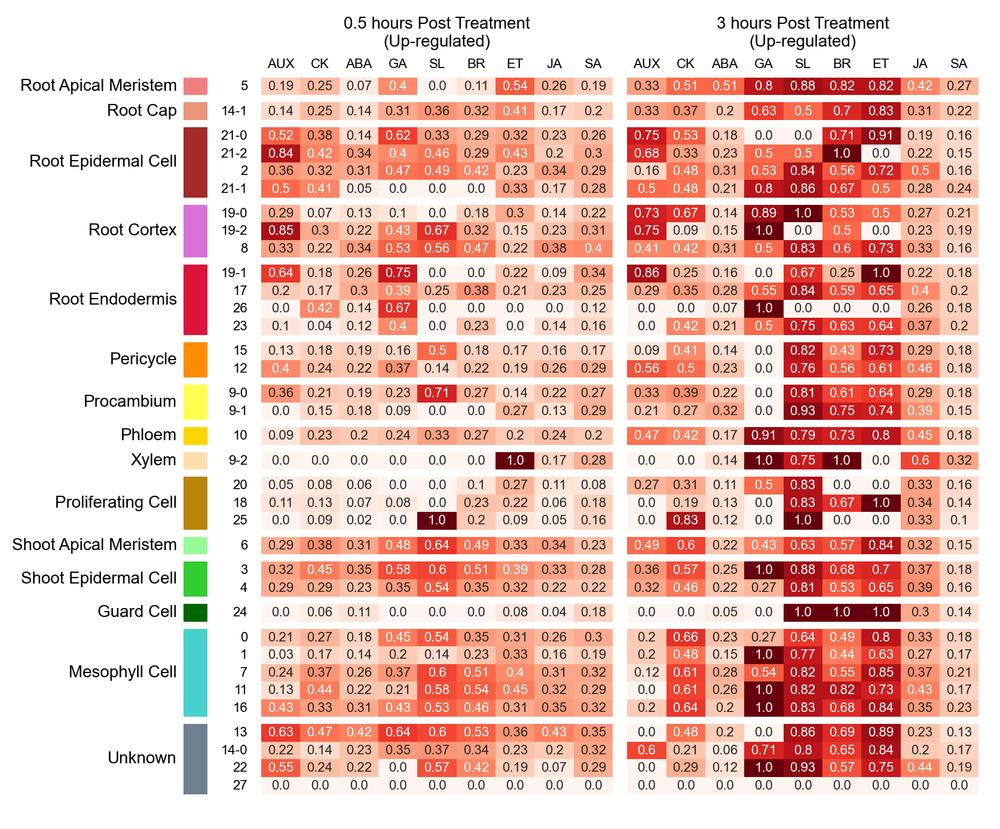

In [ ]:
filterCmd = "logFC > 1 & fdr < 0.05"
cmap = 'Reds'
subtitle = "Post Treatment\n(Up-regulated)"
h = plotGeneOverlapRatioWithWholeSample(ead, filterCmd, cmap, subtitle, 'de_concat_deg')
h.render()

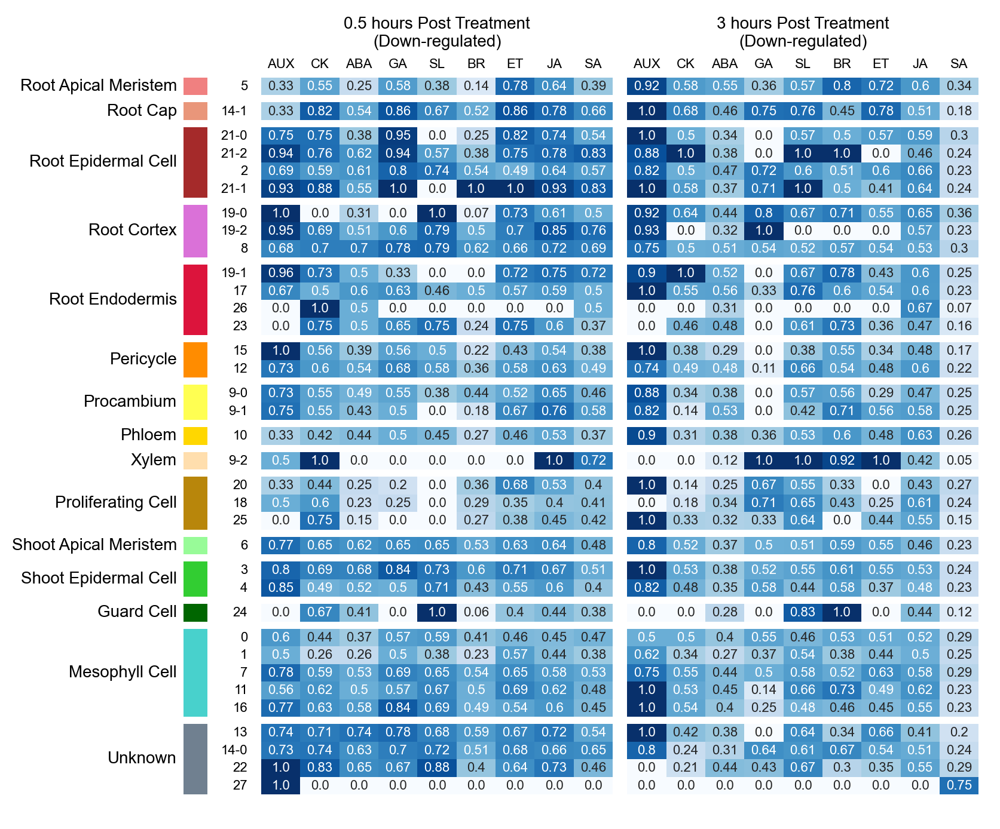

In [ ]:
filterCmd = "logFC < -1 & fdr < 0.05"
cmap = 'Blues'
subtitle = "Post Treatment\n(Down-regulated)"
h = plotGeneOverlapRatioWithWholeSample(ead, filterCmd, cmap, subtitle, 'de_concat_deg')
h.render()

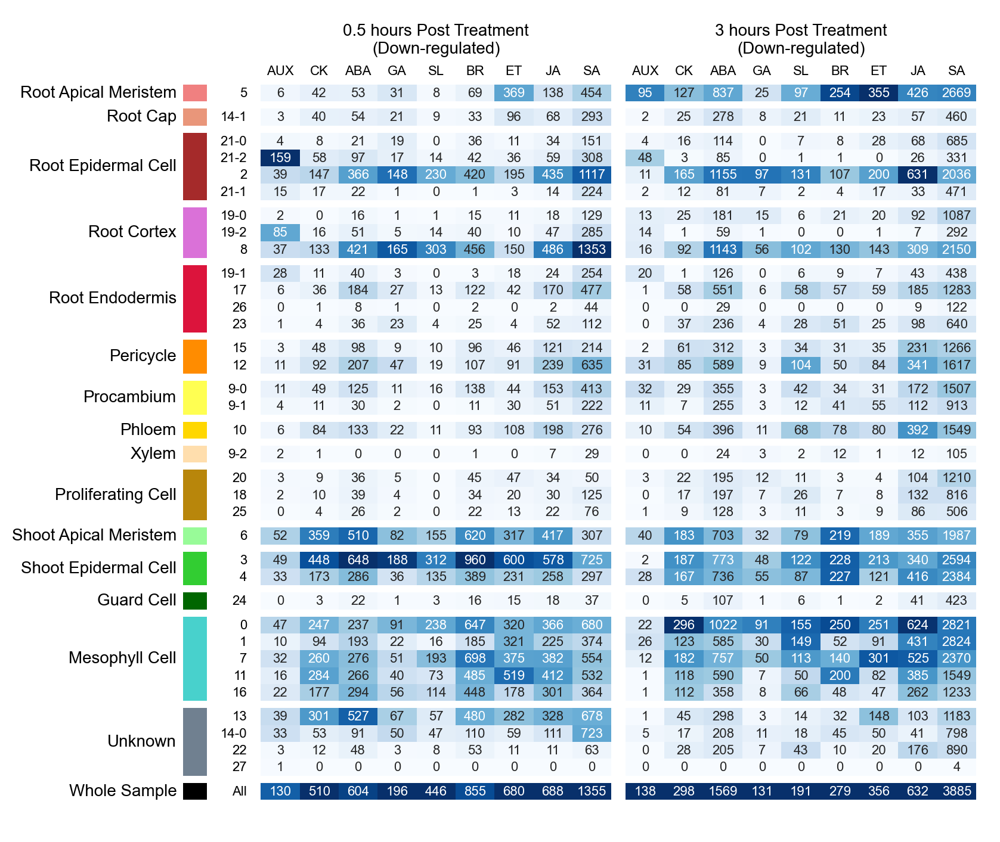

In [ ]:
filterCmd = "logFC < -1 & fdr < 0.05"
cmap = 'Blues'
subtitle = "Post Treatment\n(Down-regulated)"
h = plotGeneCounts(ead, filterCmd, cmap, subtitle, 'de_concat_deg')
h.render()

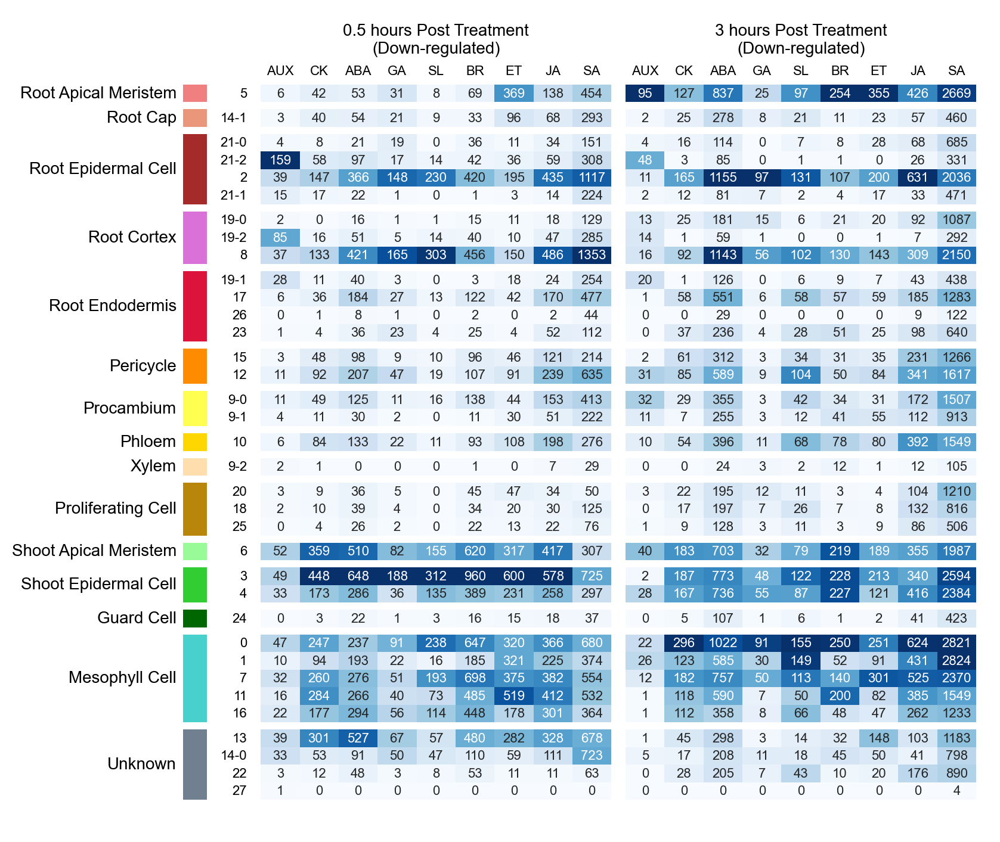

In [ ]:
filterCmd = "logFC < -1 & fdr < 0.05"
cmap = 'Blues'
subtitle = "Post Treatment\n(Down-regulated)"
h = plotGeneCounts(ead, filterCmd, cmap, subtitle)
h.render()

In [ ]:
df_temp = ead.uns['de_concat_deg'].copy()

In [ ]:
_ls = [x for x in df_temp['cluster'].unique() if x != 'All']
df_diffCounts = df_temp.query("cluster != 'All' & Time == '3h' & logFC < -1 & fdr < 0.05").value_counts(['cluster', 'Hormone']).unstack().reindex(_ls).fillna(0) - \
df_temp.query("cluster != 'All' & Time == '0.5h' & logFC < -1 & fdr < 0.05").value_counts(['cluster', 'Hormone']).unstack().reindex(_ls).fillna(0) 

In [ ]:
dt_tissueLevel = {
    "Root Apical Meristem": ["5"],
    "Root Cap": ["14-1"],
    "Root Epidermal Cell": ["21-0", "21-2", "2", "21-1"],
    "Root Cortex": ["19-0", "19-2", "8"],
    "Root Endodermis": ["19-1", "17", "26", "23"],
    "Pericycle": ["15", "12"],
    "Procambium": ["9-0", "9-1"],
    "Phloem": ["10"],
    "Xylem": ["9-2"],
    "Proliferating Cell": ["20", "18", "25"],
    "Shoot Apical Meristem": ["6"],
    "Shoot Epidermal Cell": ["3", "4"],
    "Guard Cell": ["24"],
    "Mesophyll Cell": ["0", "1", "7", "11", "16"],
    "Unknown": ["13", "14-0", "22", "27"],
}
# ls_palette = ls_palette
ls_palette = [
    "#f08080",
    "#e9967a",
    "#a52a2a",
    "#da71d8",
    "#dc143c",
    "#ff8c00",
    "#ffff52",
    "#ffd700",
    "#ffdead",
    "#b8860b",
    "#98fb98",
    "#32cd32",
    "#006600",
    "#48d1cc",
    "#708090",
]
dt_cl2tissue = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}
ls_hormones = ["AUX", "CK", "ABA", "GA", "SL", "BR", "ET", "JA", "SA"]

In [ ]:
ls_order = [
    "5",
    "14-1",
    "21-0",
    "21-2",
    "2",
    "21-1",
    "19-0",
    "19-2",
    "8",
    "19-1",
    "17",
    "26",
    "23",
    "15",
    "12",
    "9-0",
    "9-1",
    "10",
    "9-2",
    "20",
    "18",
    "25",
    "6",
    "3",
    "4",
    "24",
    "0",
    "1",
    "7",
    "11",
    "16",
    "13",
    "14-0",
    "22",
    "27",
]

In [ ]:
df_diffCounts = df_diffCounts.loc[ls_order]

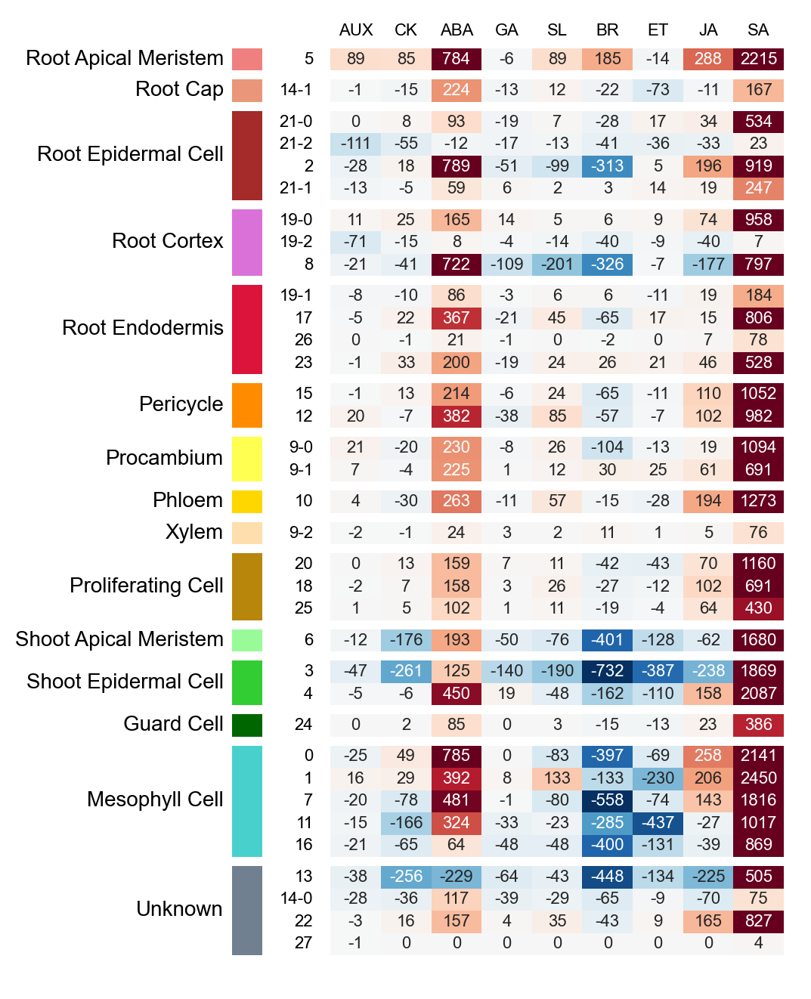

In [ ]:
h = ma.Heatmap(
    df_diffCounts.values,
    cmap='RdBu_r',
    width=3,
    height=6,
    annot=df_diffCounts.values,
    fmt=lambda _: int(_),
    annot_kws={"fontsize": 8},
    center=0,
    vmax=500,
    vmin=-500
)

h.group_rows(df_diffCounts.index.map(dt_cl2tissue), order=dt_tissueLevel.keys())
h.add_left(
    mp.Labels(df_diffCounts.index, rotation=0, ha="right", fontsize=8), pad=0.1
)
h.add_left(
    mp.Colors(
        df_diffCounts.index.map(dt_cl2tissue).tolist(),
        palette={x: y for x, y in zip(dt_tissueLevel.keys(), ls_palette)},
    ),
    size=0.2,
    pad=0.1,
    legend=False,
)
h.add_left(
    mp.Chunk(
        dt_tissueLevel.keys() >> F(list),
        props={"rotation": 0, "ha": "right", "fontsize": 10},
    ),
)
h.add_top(
    mp.Labels(
        df_diffCounts.columns, rotation=0, ha="center", fontsize=8
    ),
    pad=0.05,
)

h.render()

## cluster spec DEG ratio

In [ ]:
filterCmd = "logFC < -1 & fdr < 0.05"
cmap = 'Blues'
subtitle = "Post Treatment\n(Down-regulated)"
unsKey = 'de_concat_deg'

In [ ]:
dt_tissueLevel = {
    "Root Apical Meristem": ["5"],
    "Root Cap": ["14-1"],
    "Root Epidermal Cell": ["21-0", "21-2", "2", "21-1"],
    "Root Cortex": ["19-0", "19-2", "8"],
    "Root Endodermis": ["19-1", "17", "26", "23"],
    "Pericycle": ["15", "12"],
    "Procambium": ["9-0", "9-1"],
    "Phloem": ["10"],
    "Xylem": ["9-2"],
    "Proliferating Cell": ["20", "18", "25"],
    "Shoot Apical Meristem": ["6"],
    "Shoot Epidermal Cell": ["3", "4"],
    "Guard Cell": ["24"],
    "Mesophyll Cell": ["0", "1", "7", "11", "16"],
    "Unknown": ["13", "14-0", "22", "27"],
}
# ls_palette = ls_palette
ls_palette = [
    "#f08080",
    "#e9967a",
    "#a52a2a",
    "#da71d8",
    "#dc143c",
    "#ff8c00",
    "#ffff52",
    "#ffd700",
    "#ffdead",
    "#b8860b",
    "#98fb98",
    "#32cd32",
    "#006600",
    "#48d1cc",
    "#708090",
]
dt_cl2tissue = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}
ls_hormones = ["AUX", "CK", "ABA", "GA", "SL", "BR", "ET", "JA", "SA"]
df_overlapRatio05h = pd.DataFrame(index=dt_cl2tissue.keys(), columns=ls_hormones)
df_overlapRatio3h = pd.DataFrame(index=dt_cl2tissue.keys(), columns=ls_hormones)
df_passDeg = ead.uns[unsKey].query(filterCmd).copy()
from itertools import product
dt_wholeSample = {}

In [ ]:
for hormone in ls_hormones:
    df_singleHormoneDeg = df_passDeg.query(
        f"Hormone == '{hormone}' & Time == '0.5h' & cluster != 'All'"
    )
    ls_singleHormoneUnique = df_singleHormoneDeg.drop_duplicates("gene", keep=False)['gene'].tolist()
    df_singleHormoneDegUniqueRatio = (df_singleHormoneDeg.query("gene in @ls_singleHormoneUnique").groupby(
        "cluster"
    ).size() / df_singleHormoneDeg.groupby("cluster").size()).fillna(0)
    df_overlapRatio05h.loc[:, hormone] = df_singleHormoneDegUniqueRatio

    df_singleHormoneDeg = df_passDeg.query(
        f"Hormone == '{hormone}' & Time == '3h' & cluster != 'All'"
    )
    ls_singleHormoneUnique = df_singleHormoneDeg.drop_duplicates("gene", keep=False)['gene'].tolist()
    df_singleHormoneDegUniqueRatio = (df_singleHormoneDeg.query("gene in @ls_singleHormoneUnique").groupby(
        "cluster"
    ).size() / df_singleHormoneDeg.groupby("cluster").size()).fillna(0)
    df_overlapRatio3h.loc[:, hormone] = df_singleHormoneDegUniqueRatio

df_overlapRatio = pd.concat(
    [df_overlapRatio05h, df_overlapRatio3h], keys=["0.5h", "3h"], axis=1
)
df_overlapRatio = df_overlapRatio.fillna(0)

In [ ]:
del(ls_singleHormoneUnique)

In [ ]:

def plotGeneClusterSpecRatio(
    ead, filterCmd, cmap, subtitle, unsKey="de_concat_deg"
):
    dt_tissueLevel = {
        "Root Apical Meristem": ["5"],
        "Root Cap": ["14-1"],
        "Root Epidermal Cell": ["21-0", "21-2", "2", "21-1"],
        "Root Cortex": ["19-0", "19-2", "8"],
        "Root Endodermis": ["19-1", "17", "26", "23"],
        "Pericycle": ["15", "12"],
        "Procambium": ["9-0", "9-1"],
        "Phloem": ["10"],
        "Xylem": ["9-2"],
        "Proliferating Cell": ["20", "18", "25"],
        "Shoot Apical Meristem": ["6"],
        "Shoot Epidermal Cell": ["3", "4"],
        "Guard Cell": ["24"],
        "Mesophyll Cell": ["0", "1", "7", "11", "16"],
        "Unknown": ["13", "14-0", "22", "27"],
    }
    # ls_palette = ls_palette
    ls_palette = [
        "#f08080",
        "#e9967a",
        "#a52a2a",
        "#da71d8",
        "#dc143c",
        "#ff8c00",
        "#ffff52",
        "#ffd700",
        "#ffdead",
        "#b8860b",
        "#98fb98",
        "#32cd32",
        "#006600",
        "#48d1cc",
        "#708090",
    ]
    dt_cl2tissue = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}
    ls_hormones = ["AUX", "CK", "ABA", "GA", "SL", "BR", "ET", "JA", "SA"]
    df_overlapRatio05h = pd.DataFrame(index=dt_cl2tissue.keys(), columns=ls_hormones)
    df_overlapRatio3h = pd.DataFrame(index=dt_cl2tissue.keys(), columns=ls_hormones)
    df_passDeg = ead.uns[unsKey].query(filterCmd).copy()
    from itertools import product
    for hormone in ls_hormones:
        df_singleHormoneDeg = df_passDeg.query(
            f"Hormone == '{hormone}' & Time == '0.5h' & cluster != 'All'"
        )
        ls_singleHormoneUnique = df_singleHormoneDeg.drop_duplicates("gene", keep=False)['gene'].tolist()
        df_singleHormoneDegUniqueRatio = (df_singleHormoneDeg.query("gene in @ls_singleHormoneUnique", engine='python').groupby(
            "cluster"
        ).size() / df_singleHormoneDeg.groupby("cluster").size()).fillna(0)
        df_overlapRatio05h.loc[:, hormone] = df_singleHormoneDegUniqueRatio

        df_singleHormoneDeg = df_passDeg.query(
            f"Hormone == '{hormone}' & Time == '3h' & cluster != 'All'"
        )
        ls_singleHormoneUnique = df_singleHormoneDeg.drop_duplicates("gene", keep=False)['gene'].tolist()
        df_singleHormoneDegUniqueRatio = (df_singleHormoneDeg.query("gene in @ls_singleHormoneUnique", engine='python').groupby(
            "cluster"
        ).size() / df_singleHormoneDeg.groupby("cluster").size()).fillna(0)
        df_overlapRatio3h.loc[:, hormone] = df_singleHormoneDegUniqueRatio

    df_overlapRatio = pd.concat(
        [df_overlapRatio05h, df_overlapRatio3h], keys=["0.5h", "3h"], axis=1
    )
    df_overlapRatio = df_overlapRatio.fillna(0)
    h = ma.Heatmap(
        df_overlapRatio.values,
        cmap=cmap,
        width=6,
        height=6,
        annot=df_overlapRatio.values,
        fmt=lambda _: round(_, 2),
        annot_kws={"fontsize": 8},
    )
    h.group_cols(
        df_overlapRatio.columns.get_level_values(0), order=["0.5h", "3h"], spacing=0.02
    )
    h.group_rows(df_overlapRatio.index.map(dt_cl2tissue), order=dt_tissueLevel.keys())
    h.add_left(
        mp.Labels(df_overlapRatio.index, rotation=0, ha="right", fontsize=8), pad=0.1
    )
    h.add_left(
        mp.Colors(
            df_overlapRatio.index.map(dt_cl2tissue).tolist(),
            palette={x: y for x, y in zip(dt_tissueLevel.keys(), ls_palette)},
        ),
        size=0.2,
        pad=0.1,
        legend=False,
    )
    h.add_left(
        mp.Chunk(
            dt_tissueLevel.keys() >> F(list),
            props={"rotation": 0, "ha": "right", "fontsize": 10},
        ),
    )
    h.add_top(
        mp.Labels(
            df_overlapRatio.columns.get_level_values(1), rotation=0, ha="center", fontsize=8
        ),
        pad=0.05,
    )
    h.add_top(
        mp.Chunk(
            ["0.5 hours", "3 hours"] >> F(map, lambda _: f"{_} {subtitle}") >> F(list),
            props={"rotation": 0, "ha": "center", "fontsize": 10},
        ),
    )
    return h

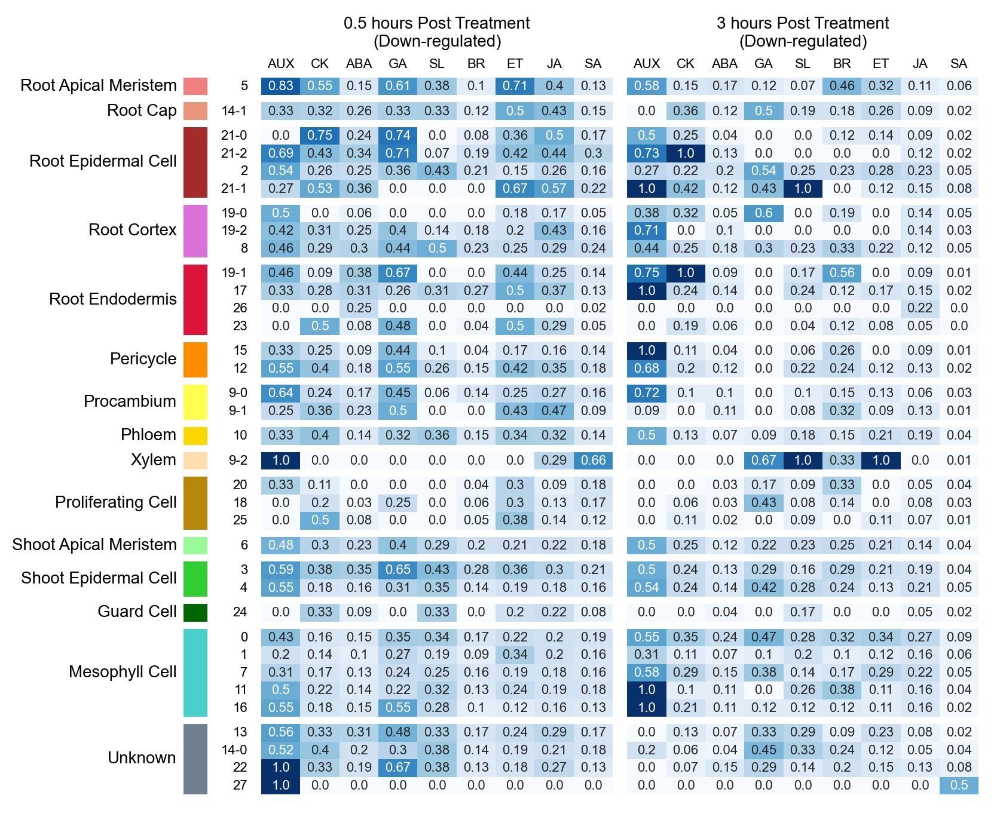

In [ ]:
filterCmd = "logFC < -1 & fdr < 0.05"
cmap = 'Blues'
subtitle = "Post Treatment\n(Down-regulated)"
h = plotGeneClusterSpecRatio(ead, filterCmd, cmap, subtitle, 'de_concat_deg')
h.render()

In [ ]:
for hormone, cluster in product(ls_hormones, dt_cl2tissue.keys()):
    dt_wholeSample[(hormone, cluster, "05h")] = dt_wholeSample.get(
        (hormone, cluster, "05h"),
        df_passDeg.query(f"Hormone == '{hormone}' & Time == '0.5h' & cluster == 'All'")[
            "gene"
        ].unique(),
    )
    ls_wholeSample05h = dt_wholeSample[(hormone, cluster, "05h")]
    dt_wholeSample[(hormone, cluster, "3h")] = dt_wholeSample.get(
        (hormone, cluster, "3h"),
        df_passDeg.query(f"Hormone == '{hormone}' & Time == '3h' & cluster == 'All'")[
            "gene"
        ].unique(),
    )

In [ ]:
for hormone, cluster in product(ls_hormones, dt_cl2tissue.keys()):
    dt_wholeSample[(hormone, cluster, "05h")] = dt_wholeSample.get(
        (hormone, cluster, "05h"),
        df_passDeg.query(f"Hormone == '{hormone}' & Time == '0.5h' & cluster == 'All'")[
            "gene"
        ].unique(),
    )
    ls_wholeSample05h = dt_wholeSample[(hormone, cluster, "05h")]
    dt_wholeSample[(hormone, cluster, "3h")] = dt_wholeSample.get(
        (hormone, cluster, "3h"),
        df_passDeg.query(f"Hormone == '{hormone}' & Time == '3h' & cluster == 'All'")[
            "gene"
        ].unique(),
    )
    ls_wholeSample3h = dt_wholeSample[(hormone, cluster, "3h")]

    ls_cluster05h = df_passDeg.query(
        f"Hormone == '{hormone}' & Time == '0.5h' & cluster == '{cluster}'"
    )["gene"].unique()
    ls_cluster3h = df_passDeg.query(
        f"Hormone == '{hormone}' & Time == '3h' & cluster == '{cluster}'"
    )["gene"].unique()
    # print(len(set(ls_cluster05h) - set(ls_wholeSample05h)) / len(set(ls_cluster05h)))
    if len(set(ls_cluster05h)) == 0:
        df_overlapRatio05h.loc[cluster, hormone] = 0
    else:
        df_overlapRatio05h.loc[cluster, hormone] = len(
            set(ls_cluster05h) - set(ls_wholeSample05h)
        ) / len(set(ls_cluster05h))
    if len(set(ls_cluster3h)) == 0:
        df_overlapRatio3h.loc[cluster, hormone] = 0
    else:
        df_overlapRatio3h.loc[cluster, hormone] = len(
            set(ls_cluster3h) - set(ls_wholeSample3h)
        ) / len(set(ls_cluster3h))
df_overlapRatio = pd.concat(
    [df_overlapRatio05h, df_overlapRatio3h], keys=["0.5h", "3h"], axis=1
)
df_overlapRatio = df_overlapRatio.fillna(0)

## DEG overlap for each hormone

In [ ]:
from jpy_tools.overlapTools import GeneOverlapBase

In [ ]:
ead.uns['de_Sample_deg']

,gene,logFC,logCPM,LR,PValue,fdr,a,b,cluster,Hormone,Time,GeneCategory
0,AT1G01010,0.040919,5.176193,0.013451,0.907671,0.989812,Mock_05h,AUX_05h,0,AUX,0.5h,Others
1,AT1G01020,-0.140997,6.819870,0.403926,0.525069,0.931877,Mock_05h,AUX_05h,0,AUX,0.5h,Others
2,AT1G01030,0.194039,6.348849,0.564515,0.452447,0.915845,Mock_05h,AUX_05h,0,AUX,0.5h,Others
3,AT1G01040,-0.013199,8.522973,0.004181,0.948444,0.995737,Mock_05h,AUX_05h,0,AUX,0.5h,Others
4,AT1G01050,-0.370406,5.066063,1.653976,0.198419,0.800636,Mock_05h,AUX_05h,0,AUX,0.5h,Others
...,...,...,...,...,...,...,...,...,...,...,...,...
4569889,AT4G37870,-0.160916,15.644088,0.014691,0.903529,0.903529,Mock_3h,SL_3h,27,SL,3h,Others
4569890,AT5G07350,-0.362110,14.945542,0.065471,0.798049,0.903529,Mock_3h,SL_3h,27,SL,3h,Others
4569891,AT5G45110,-3.792954,14.224658,1.165070,0.280416,0.903529,Mock_3h,SL_3h,27,SL,3h,Others
4569892,ATMG00020,0.871704,14.939141,0.292860,0.588393,0.903529,Mock_3h,SL_3h,27,SL,3h,Others


In [ ]:
ead.uns["de_Sample_deg"] = ead.uns["de_Sample_deg"].assign(
    GeneCategory=lambda _: np.select(
        [
            (_.logFC > 1) & (_.fdr < 0.05),
            (_.logFC < -1) & (_.fdr < 0.05),
        ],
        ["Up", "Down"],
        "Others",
    )
)

In [ ]:
df_degForOverlap = pd.concat(
    [
        ead.uns["de_Sample_deg"]
        .assign(
            Group=lambda _: _.Hormone.astype(str)
            + "_"
            + _.Time.astype(str)
            + "_"
            + "Up"
        )
        .assign(
            GeneCategory=lambda _: np.where(_.GeneCategory == "Up", "Target", "Others")
        ),
        ead.uns["de_Sample_deg"]
        .assign(
            Group=lambda _: _.Hormone.astype(str)
            + "_"
            + _.Time.astype(str)
            + "_"
            + "Down"
        )
        .assign(
            GeneCategory=lambda _: np.where(_.GeneCategory == "Down", "Target", "Others")
        ),
    ]
)

In [ ]:
df_degForOverlap = df_degForOverlap.assign(
    geneGroup=lambda _: _.gene + "_" + _.Group,
    GeneCategory=lambda _: np.where(_.GeneCategory != "Others", "Target", "Others"),
)

In [ ]:
from itertools import product
dt_obs = {}
for hormone, time in product(
    ead.obs["Hormone"].cat.categories, ['0.5h', '3h']
):
    _df = df_degForOverlap.query(
        f"Hormone == '{hormone}' & Time == '{time}'"
    )
    gop = GeneOverlapBase(_df, 'geneGroup', 'cluster', 'GeneCategory', 'Target')
    gop.getOverlapInfo(additionalTest=True)
    dt_obs[(hormone, time)] = gop

0it [00:00, ?it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
0it [00:00, ?it/s]
 10%|█         | 128/1225 [02:13<21:09,  1.16s/it]2025-05-30 15:25:17.756 | ERROR    | jpy_tools.overlapTools:getOverlapResSingle:156 - 10
2025-05-30 15:25:17.764 | ERROR    | jpy_tools.overlapTools:getOverlapResSingle:156 - 11
 16%|█▌        | 192/1225 [02:13<10:50,  1.59it/s]2025-05-30 15:25:17.869 | ERROR    | jpy_tools.overlapTools:getOverlapResSingle:156 - 13
2025-05-30 15:25:17.881 | ERROR    | jpy_tools.overlapTools:getOverlapResSingle:156 - 1
2025-05-30 15:25:17.935 | ERROR    | jpy_tools.overlapTools:getOverlapResSingle:156 - 14-0
 21%|██        | 256/1225 [02:13<06:10,  2.62it/s]2025-05-30 15:25:18.002 | ERROR    | jpy_tools.overlapTools:getOverlapResSingle:156 - 14-1
2025-05-30 15:25:18.077 | ERROR    | jpy_tools.overlapTools:getOverlapResSingle:156 - 15
 26%|██▌       | 320/1225 [02:14<03:41,  4.08it/s]2025-05-30 15:25:18.193 | ERROR    | jpy_tools.overlapTools:getOverlapResSingle

In [ ]:
def plotHormoneClusterOverlapInfo(gob, cmap, subtitle, method='qmod', vmax=1):
    dt_tissueLevel = {
        "Root Apical Meristem": ["5"],
        "Root Cap": ["14-1"],
        "Root Epidermal Cell": ["21-0", "21-2", "2", "21-1"],
        "Root Cortex": ["19-0", "19-2", "8"],
        "Root Endodermis": ["19-1", "17", "26", "23"],
        "Pericycle": ["15", "12"],
        "Procambium": ["9-0", "9-1"],
        "Phloem": ["10"],
        "Xylem": ["9-2"],
        "Proliferating Cell": ["20", "18", "25"],
        "Shoot Apical Meristem": ["6"],
        "Shoot Epidermal Cell": ["3", "4"],
        "Guard Cell": ["24"],
        "Mesophyll Cell": ["0", "1", "7", "11", "16"],
        "Unknown": ["13", "14-0", "22", "27"],
    }
    # ls_palette = ls_palette
    ls_palette = [
        "#f08080",
        "#e9967a",
        "#a52a2a",
        "#da71d8",
        "#dc143c",
        "#ff8c00",
        "#ffff52",
        "#ffd700",
        "#ffdead",
        "#b8860b",
        "#98fb98",
        "#32cd32",
        "#006600",
        "#48d1cc",
        "#708090",
    ]
    dt_cl2tissue = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}

    df_overlap = gob.df_overlapInfo.pivot_table(index='comp1', columns='comp2', values=method)
    df_overlap = df_overlap.reindex(index=dt_cl2tissue.keys(), columns=dt_cl2tissue.keys()).fillna(0)

    h = ma.Heatmap(
        df_overlap.values,
        cmap=cmap,
        width=6,
        height=6,
        annot=False,
        fmt=lambda _: round(_, 2),
        annot_kws={"fontsize": 8},
        vmin=0, vmax=vmax
    )
    h.group_cols(df_overlap.index.map(dt_cl2tissue), order=dt_tissueLevel.keys(), spacing=0.002)
    h.group_rows(df_overlap.index.map(dt_cl2tissue), order=dt_tissueLevel.keys(), spacing=0.002)
    h.add_left(
        mp.Labels(df_overlap.index, rotation=0, ha="right", fontsize=8), pad=0.1
    )
    h.add_left(
        mp.Colors(
            df_overlap.index.map(dt_cl2tissue).tolist(),
            palette={x: y for x, y in zip(dt_tissueLevel.keys(), ls_palette)},
        ),
        size=0.2,
        pad=0.1,
        legend=False,
    )
    h.add_top(
        mp.Colors(
            df_overlap.index.map(dt_cl2tissue).tolist(),
            palette={x: y for x, y in zip(dt_tissueLevel.keys(), ls_palette)},
        ),
        size=0.1,
        pad=0.1,
        legend=False,
    )
    h.add_left(
        mp.Chunk(
            dt_tissueLevel.keys() >> F(list),
            props={"rotation": 0, "ha": "right", "fontsize": 10},
        ),
    )
    h.add_top(
        mp.Title(f"{subtitle}\n(Overlap Ratio)"),
    )
    return h


In [ ]:
from jpy_tools.otherTools import FigConcate, FigConcateWrap

In [ ]:
def plotHormoneClusterOverlapInfo(gob, cmap, subtitle, method='qmod', vmax=1):
    dt_tissueLevel = {
        "Root Apical Meristem": ["5"],
        "Root Cap": ["14-1"],
        "Root Epidermal Cell": ["21-0", "21-2", "2", "21-1"],
        "Root Cortex": ["19-0", "19-2", "8"],
        "Root Endodermis": ["19-1", "17", "26", "23"],
        "Pericycle": ["15", "12"],
        "Procambium": ["9-0", "9-1"],
        "Phloem": ["10"],
        "Xylem": ["9-2"],
        "Proliferating Cell": ["20", "18", "25"],
        "Shoot Apical Meristem": ["6"],
        "Shoot Epidermal Cell": ["3", "4"],
        "Guard Cell": ["24"],
        "Mesophyll Cell": ["0", "1", "7", "11", "16"],
        "Unknown": ["13", "14-0", "22", "27"],
    }
    # ls_palette = ls_palette
    ls_palette = [
        "#f08080",
        "#e9967a",
        "#a52a2a",
        "#da71d8",
        "#dc143c",
        "#ff8c00",
        "#ffff52",
        "#ffd700",
        "#ffdead",
        "#b8860b",
        "#98fb98",
        "#32cd32",
        "#006600",
        "#48d1cc",
        "#708090",
    ]
    dt_cl2tissue = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}

    df_overlap = gob.df_overlapInfo.pivot_table(index='comp1', columns='comp2', values=method)
    df_overlap = df_overlap.reindex(index=dt_cl2tissue.keys(), columns=dt_cl2tissue.keys()).fillna(0)

    h = ma.Heatmap(
        df_overlap.values,
        cmap=cmap,
        width=6,
        height=6,
        annot=False,
        fmt=lambda _: round(_, 2),
        annot_kws={"fontsize": 8},
        vmin=0, vmax=vmax
    )
    h.group_cols(df_overlap.index.map(dt_cl2tissue), order=dt_tissueLevel.keys(), spacing=0.002)
    h.group_rows(df_overlap.index.map(dt_cl2tissue), order=dt_tissueLevel.keys(), spacing=0.002)
    h.add_left(
        mp.Labels(df_overlap.index, rotation=0, ha="right", fontsize=14), pad=0.1
    )
    h.add_left(
        mp.Colors(
            df_overlap.index.map(dt_cl2tissue).tolist(),
            palette={x: y for x, y in zip(dt_tissueLevel.keys(), ls_palette)},
            # legend_kws={'ncol':8}
        ),
        size=0.1,
        pad=0.1,
        legend=False,
    )
    h.add_top(
        mp.Colors(
            df_overlap.index.map(dt_cl2tissue).tolist(),
            palette={x: y for x, y in zip(dt_tissueLevel.keys(), ls_palette)},
        ),
        size=0.1,
        pad=0.1,
        legend=False,
    )
    # h.add_left(
    #     mp.Chunk(
    #         dt_tissueLevel.keys() >> F(list),
    #         props={"rotation": 0, "ha": "right", "fontsize": 10},
    #     ),
    # )
    h.add_top(
        mp.Title(f"{subtitle}", fontsize=24), pad=0.05
    )
    return h


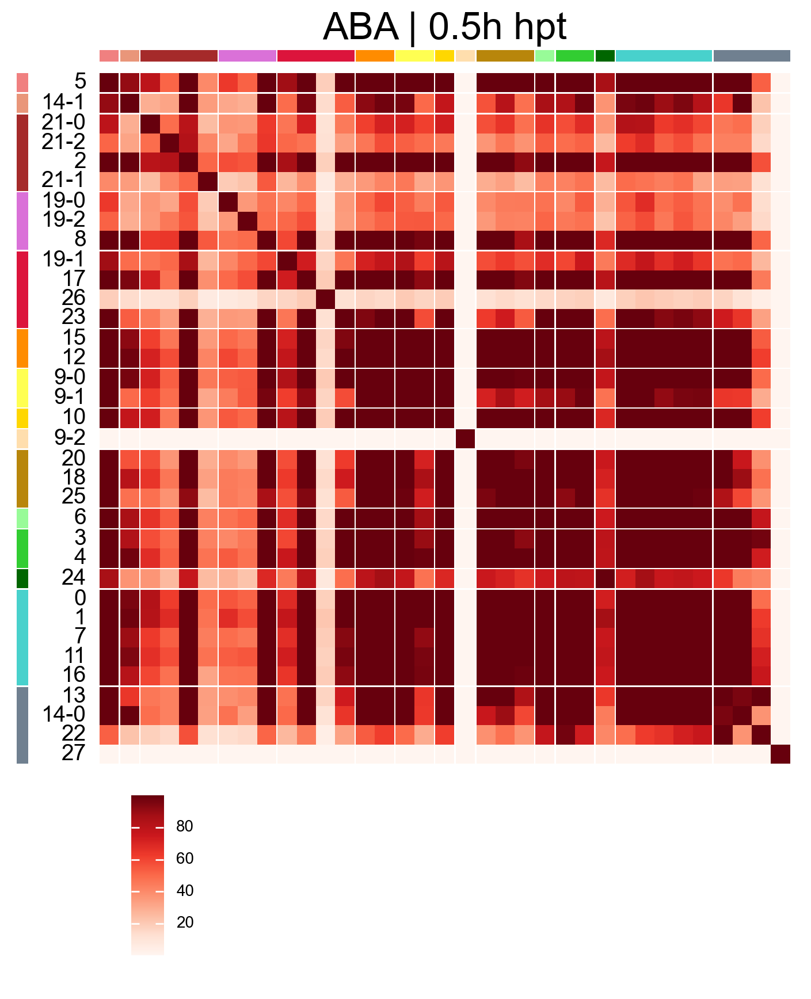

In [ ]:
for x,y in product(['ABA', 'JA', 'SA'], ['0.5h', '3h']):
    break
h = plotHormoneClusterOverlapInfo(dt_obs[(x, y)], 'Reds', f"{x} | {y} hpt", 'smod', vmax=100)
h.add_legends('bottom')
h.render()


In [ ]:
ls_hormones

['AUX', 'CK', 'ABA', 'GA', 'SL', 'BR', 'ET', 'JA', 'SA']

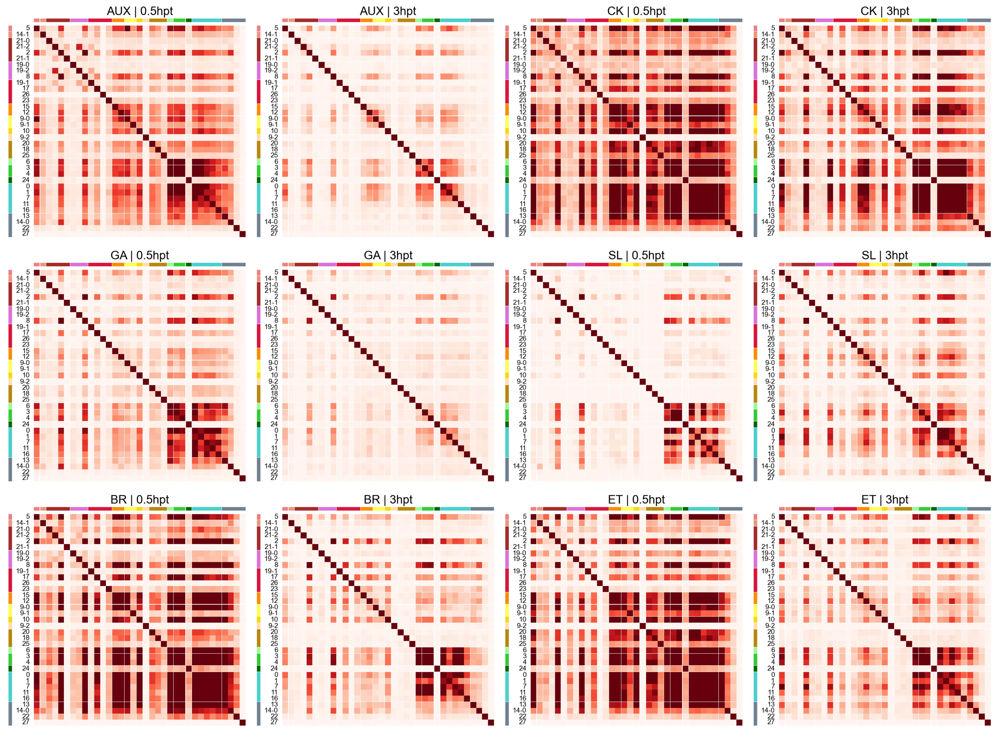

In [ ]:
figw = FigConcateWrap()
for x,y in product(['AUX', 'CK','GA', 'SL', 'BR', 'ET', ], ['0.5h', '3h']):
    h = plotHormoneClusterOverlapInfo(dt_obs[(x, y)], 'Reds', f"{x} | {y}pt", 'smod', vmax=100)
    h.render()
    fig = h.figure
    plt.close()
    figw.addFig(FigConcate(fig))
figw.wrapAndGenerate(4).show([40,40])

## Synthesis pathway

In [ ]:
from jpy_tools.otherTools import getGoDesc
df_araGo = pd.read_table("/datapool/data/Users/zhijian/ipf/data/Araport11/tair10/ath_go_parsed.txt")
df_araGo = df_araGo.loc[lambda _: _.gene.map(len) == 9].query("gene.str.startswith('AT')")
df_goDesc = getGoDesc(df_araGo["goTerm"].unique().tolist(), retry=10, verbose=True)

100%|██████████| 7623/7623 [02:23<00:00, 53.19it/s] 
2025-06-05 18:50:36.075 | WARNING  | jpy_tools.otherTools:getGoDesc:610 - query : GO:0016021, target : GO:0016020
2025-06-05 18:50:36.080 | WARNING  | jpy_tools.otherTools:getGoDesc:610 - query : GO:0005887, target : GO:0005886
2025-06-05 18:50:36.113 | WARNING  | jpy_tools.otherTools:getGoDesc:610 - query : GO:0052928, target : GO:0052927
2025-06-05 18:50:36.129 | WARNING  | jpy_tools.otherTools:getGoDesc:610 - query : GO:0044106, target : GO:0009308
2025-06-05 18:50:36.140 | WARNING  | jpy_tools.otherTools:getGoDesc:610 - query : GO:0004367, target : GO:0047952
2025-06-05 18:50:36.143 | WARNING  | jpy_tools.otherTools:getGoDesc:610 - query : GO:0102092, target : GO:0033857
2025-06-05 18:50:36.147 | WARNING  | jpy_tools.otherTools:getGoDesc:610 - query : GO:0004147, target : GO:0043754
2025-06-05 18:50:36.149 | WARNING  | jpy_tools.otherTools:getGoDesc:610 - query : GO:0102860, target : GO:0050184
2025-06-05 18:50:36.151 | WARNING  

In [ ]:
import gseapy


def enrichrUsingGsea(ls_gene, dt_goSets, background=None, **kwargs):
    enr = gseapy.enrich(
        list(ls_gene), gene_sets=dt_goSets, background=background, **kwargs
    )
    enr.results = enr.results.assign(
        geneTotal=lambda x: x["Overlap"].str.split("/").str[1].astype(int),
        geneIn=lambda x: x["Overlap"].str.split("/").str[0].astype(int),
    )
    enr.results["-log10(p)"] = -np.log10(enr.results["Adjusted P-value"])
    return enr.results.copy().sort_values("Adjusted P-value").reset_index(drop=True)

In [ ]:
dt_goForGseapy = (
    df_araGo.merge(df_goDesc, left_on="goTerm", right_on="hitGO", how="left")
    .groupby(["hitName"])["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
def onlyKeepHormoneGoTerm(x):
    res = False
    if 'biosynth' in x:
        for i in ['auxin', 'jasmonic', 'abscisic', 'brassinosteroid', 'cytokinin', 'ethylene', 'gibberell', 'strigolact', 'salicylic acid']:
            if i in x:
                res= True
    return res

In [ ]:
dt_hormoneGoForGseapy = {
    x: y for x, y in dt_goForGseapy.items() if onlyKeepHormoneGoTerm(x)
}
dt_hormoneAbb = {
    x: y
    for x, y in zip(
        [
            "auxin",
            "jasmonic",
            "abscisic",
            "brassinosteroid",
            "cytokinin",
            "ethylene",
            "gibberell",
            "strigolactone",
            "salicylic acid",
        ],
        ["AUX", "JA", "ABA", "BR", "CK", "ET", "GA", "SL", "SA"],
    )
}

In [ ]:
dt_term2hormone = {}
for x in dt_hormoneGoForGseapy.keys():
    for y in dt_hormoneAbb.keys():
        if y in x:
            dt_term2hormone[x] = dt_hormoneAbb[y]

In [ ]:
import re

# 假设 gene_pathways 是原始的字典，key 为通路名称，value 为该通路中的所有基因列表
gene_pathways = {
    'abscisic acid biosynthetic process (GO:0009688)': ['gene1', 'gene2'],
    'auxin biosynthetic process (GO:0009851)': ['gene3', 'gene4'],
    'brassinosteroid biosynthetic process (GO:0016132)': ['gene5'],
    'cytokinin biosynthetic process (GO:0009691)': ['gene6'],
    'ethylene biosynthetic process (GO:0009693)': ['gene7'],
    'gibberellin biosynthetic process (GO:0009686)': ['gene8'],
    'jasmonic acid biosynthetic process (GO:0009695)': ['gene9'],
    'negative regulation of abscisic acid biosynthetic process (GO:0090359)': ['gene10'],
    'negative regulation of brassinosteroid biosynthetic process (GO:0010423)': ['gene11'],
    'negative regulation of ethylene biosynthetic process (GO:0010366)': ['gene12'],
    'negative regulation of gibberellin biosynthetic process (GO:0010373)': ['gene13'],
    'positive regulation of abscisic acid biosynthetic process (GO:0010116)': ['gene14'],
    'positive regulation of auxin biosynthetic process (GO:0010601)': ['gene15'],
    'positive regulation of brassinosteroid biosynthetic process (GO:2000488)': ['gene16'],
    'positive regulation of ethylene biosynthetic process (GO:0010365)': ['gene17'],
    'positive regulation of gibberellin biosynthetic process (GO:0010372)': ['gene18'],
    'regulation of abscisic acid biosynthetic process (GO:0010115)': ['gene19'],
    'regulation of auxin biosynthetic process (GO:0010600)': ['gene20'],
    'regulation of brassinosteroid biosynthetic process (GO:0010422)': ['gene21'],
    'regulation of ethylene biosynthetic process (GO:0010364)': ['gene22'],
    'regulation of gibberellin biosynthetic process (GO:0010371)': ['gene23'],
    'regulation of jasmonic acid biosynthetic process (GO:0080141)': ['gene24'],
    'regulation of salicylic acid biosynthetic process (GO:0080142)': ['gene25'],
    'salicylic acid biosynthetic process (GO:0009697)': ['gene26'],
    'strigolactone biosynthetic process (GO:1901601)': ['gene27']
}

# 定义激素列表，用于正则匹配（注意大小写需要与通路名称中的一致）
hormones = [
    "abscisic acid", "auxin", "brassinosteroid", "cytokinin", 
    "ethylene", "gibberellin", "jasmonic acid", "salicylic acid", "strigolactone"
]

# 构建正则表达式，将激素名称用 | 分隔
pattern = re.compile("|".join(hormones))

# 初始化合并后的字典
merged_pathways = {}

# 遍历所有通路，提取激素名称并合并基因列表
for pathway, genes in dt_hormoneGoForGseapy.items():
    match = pattern.search(pathway)
    if match:
        hormone = match.group()  # 获取匹配到的激素名称
        # 如果该激素已经在 merged_pathways 中，则将基因列表合并，否则新建条目
        if hormone in merged_pathways:
            merged_pathways[hormone] += genes
        else:
            merged_pathways[hormone] = genes.copy()  # 使用 copy 以避免原列表被修改
    else:
        # 如果未匹配到任何激素，可以选择忽略或另行处理
        pass

# 输出合并后的字典
# print(merged_pathways)

In [ ]:
dt_hormoneGoForGseapy = {
    x: list(set(y)) for x, y in merged_pathways.items()
}

In [ ]:
dt_term2hormone = {
    'abscisic acid': 'ABA',
    'auxin': 'AUX',
    'brassinosteroid': 'BR',
    'cytokinin': 'CK',
    'ethylene': 'ET',
    'gibberellin': 'GA',
    'jasmonic acid': 'JA',
    'salicylic acid': 'SA',
    'strigolactone': 'SL'
}

In [ ]:
ls_goResHormoneSyn = []
for (hormone, time, cluster), ls_gene in df_degForOverlap.query('GeneCategory == "Target" & Group.str.contains("Up")').groupby(['Hormone', 'Time', 'cluster'])['gene'].agg(list).to_dict().items():
    try:
        ls_goResHormoneSyn.append(
            enrichrUsingGsea(
                ls_gene,
                dt_hormoneGoForGseapy,
                cutoff=1,
                background=ead.var.index.tolist(),
            ).assign(Cluster=cluster, Time=time, Hormone=hormone, Direction='Up')
        )
        # break
    except:
        logger.error(f"Error: {cluster} {time} {hormone}")
for (hormone, time, cluster), ls_gene in df_degForOverlap.query('GeneCategory == "Target" & Group.str.contains("Down")').groupby(['Hormone', 'Time', 'cluster'])['gene'].agg(list).to_dict().items():
    try:
        ls_goResHormoneSyn.append(
            enrichrUsingGsea(
                ls_gene,
                dt_hormoneGoForGseapy,
                cutoff=1,
                background=ead.var.index.tolist(),
            ).assign(Cluster=cluster, Time=time, Hormone=hormone, Direction='Down')
        )
        # break
    except:
        logger.error(f"Error: {cluster} {time} {hormone}")
df_goResHormoneSyn = pd.concat(ls_goResHormoneSyn, ignore_index=True)

In [ ]:
df_goResHormoneSyn = df_goResHormoneSyn.assign(
    TermHormone = lambda x: x['Term'].map(dt_term2hormone)
)

In [ ]:
ls_order = ['5', '14-1', '21-0', '21-2', '2', '21-1', '19-0', '19-2', '8', '19-1', '17', '26', '23', '15', '12', '9-0', '9-1', '10', '9-2', '20', '18', '25', '6', '3', '4', '24', '0', '1', '7', '11', '16', '13', '14-0', '22', '27']

In [ ]:
mpl.rcdefaults()

In [ ]:

df_goResHormoneSyn['Term'] = df_goResHormoneSyn['Time'] + ' ' + df_goResHormoneSyn['Term'] + " pathway"

In [ ]:
df_goResHormoneSyn = (df_goResHormoneSyn.query("`P-value` < 0.05").query("TermHormone == Hormone"))

In [ ]:
df_goResHormoneSyn = df_goResHormoneSyn.sort_values(
    ["Cluster", "Time", "TermHormone", "Adjusted P-value"],
    ascending=[True, True, True, True],
)
df_goResHormoneSyn = df_goResHormoneSyn.drop_duplicates(
    ["Cluster", "Time", "TermHormone"],
    keep="first",
)

In [ ]:
df_goResHormoneSyn['Cluster'] = df_goResHormoneSyn['Cluster'].astype('category').cat.set_categories(ls_order)

In [ ]:
df_goResHormoneSyn['Hormone'] = df_goResHormoneSyn['Hormone'].astype('category').cat.set_categories(ls_hormones)
df_goResHormoneSyn['TermHormone'] = df_goResHormoneSyn['TermHormone'].astype('category').cat.set_categories(ls_hormones)

In [ ]:
df_goResHormoneSyn['Direction'] = df_goResHormoneSyn['Direction'].map({'Up': 5, 'Down': -10}).astype(int)

In [ ]:
df_htSize = (
    df_goResHormoneSyn.query("`P-value` < 0.05")
    .query("TermHormone == Hormone")
    .pivot_table(columns=["TermHormone", "Time"], index="Cluster", values="geneIn", dropna=False)
    .fillna(0)
    .astype(int)
)
def _fc(x):
    if x > 0:
        return "Up"
    elif x < 0:
        return "Down"
    else:
        return np.random.choice(["Up", "Down"])
df_htColor = (
    df_goResHormoneSyn.query("`P-value` < 0.05")
    .query("TermHormone == Hormone")
    .pivot_table(columns=["TermHormone", "Time"], index="Cluster", values="Direction", dropna=False)
    .fillna(0)
    .applymap(_fc)
)

In [ ]:
dt_tissueLevel = {
    "Root Apical Meristem": ["5"],
    "Root Cap": ["14-1"],
    "Root Epidermal Cell": ["21-0", "21-2", "2", "21-1"],
    "Root Cortex": ["19-0", "19-2", "8"],
    "Root Endodermis": ["19-1", "17", "26", "23"],
    "Pericycle": ["15", "12"],
    "Procambium": ["9-0", "9-1"],
    "Phloem": ["10"],
    "Xylem": ["9-2"],
    "Proliferating Cell": ["20", "18", "25"],
    "Shoot Apical Meristem": ["6"],
    "Shoot Epidermal Cell": ["3", "4"],
    "Guard Cell": ["24"],
    "Mesophyll Cell": ["0", "1", "7", "11", "16"],
    "Unknown": ["13", "14-0", "22", "27"],
}
# ls_palette = ls_palette
ls_palette = [
    "#f08080",
    "#e9967a",
    "#a52a2a",
    "#da71d8",
    "#dc143c",
    "#ff8c00",
    "#ffff52",
    "#ffd700",
    "#ffdead",
    "#b8860b",
    "#98fb98",
    "#32cd32",
    "#006600",
    "#48d1cc",
    "#708090",
]
dt_cl2anno = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}

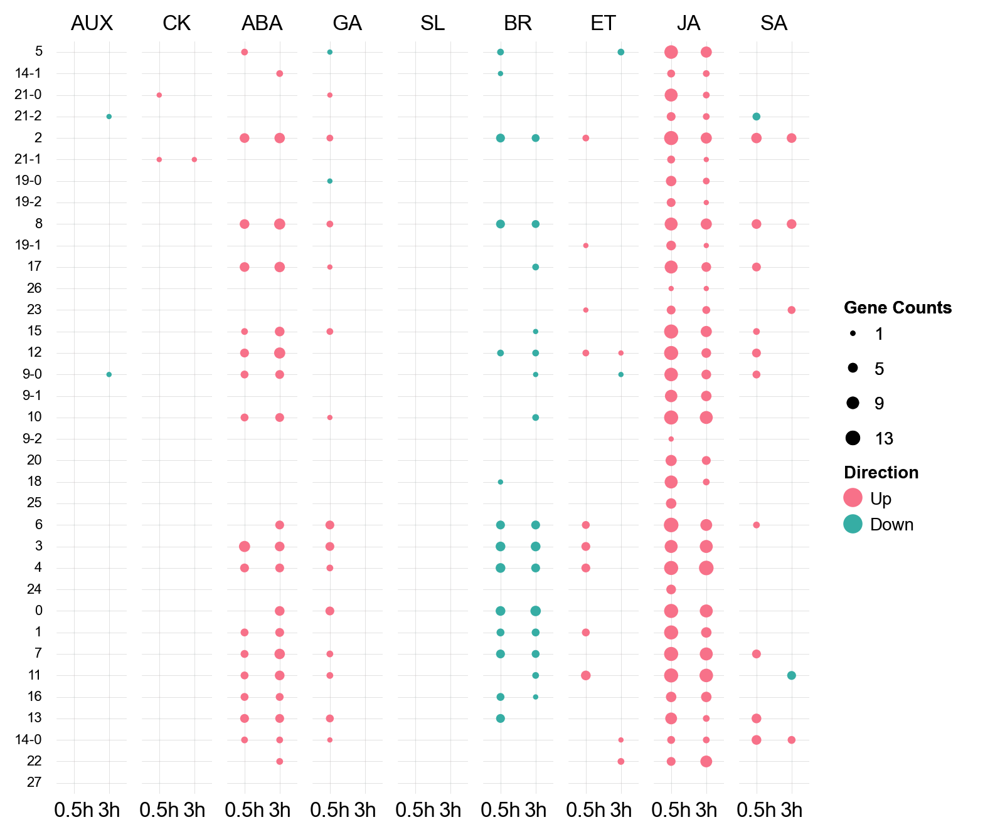

In [ ]:
h = ma.SizedHeatmap(
    size=df_htSize.values,
    color=df_htColor.values,
    width=6,
    height=6,
    palette={"Up": "#f77189", "Down": "#36ada4"},
    size_norm=mpl.colors.Normalize(vmin=0, vmax=12, clip=False),
    sizes=(0.0001, 50),
    frameon=False,
    grid=True,
    grid_linewidth=0.2,
    size_legend_kws={'title':'Gene Counts',  'spacing': 'uniform', 'show_at': [1/13,5/13, 9/13, 1]},
    color_legend_kws={'title':'Direction'}
)
h.group_cols(
    df_htSize.columns.get_level_values(0),
    order=ls_hormones,
    spacing=0.02,
)
h.add_bottom(
    mp.Labels(
        df_htSize.columns.get_level_values(1), rotation=0, ha="center", fontsize=12
    ),
    pad=0.05,
)
h.add_top(
    mp.Chunk(
        texts=ls_hormones,
        props={"rotation": 0, "ha": "center", "fontsize": 12},
    ),
)
h.add_left(
    mp.Labels(df_htSize.index, rotation=0, ha="right", fontsize=8), pad=0.1
)
# h.group_rows(
#     df_htSize.index.map(dt_cl2anno), order=dt_tissueLevel.keys(), spacing=0.02
# )
h.add_legends()
h.render()

In [ ]:

# p = (
#     so.Plot(
#         df_goResHormoneSyn.query("`P-value` < 0.05").query("TermHormone == Hormone"),
#         x="Term",
#         y="Cluster",
#     )
#     .facet(col="Hormone", row="Time", order={'row': ['0.5h', '3h']})
#     .share(x='col')
#     .add(so.Dot(), pointsize="geneIn", color="Direction")
#     .scale(y=so.Nominal(order=ls_order), pointsize=so.Continuous(values=(1,10)).tick(every=2))
#     .label(y="", x="", pointsize="Gene Counts")
#     .layout(size=(16, 14), engine='constrained')
# )
# fig = p.plot()._figure
# for i, ax in enumerate(fig.axes):
#     if i < 8:
#         # hide x ticklabels
#         ax.xaxis.set_tick_params(labelbottom=False)
#     else:
#         ax.set_xticklabels(ax.get_xticklabels(), rotation=-30, ha='left')
# soExt.mvLegToAx(fig, fig, 'center left', [0.9, 0.5])
# fig

### crosstalk

In [ ]:
df_goResHormoneSyn = (
    df_goResHormoneSyn.groupby(["Hormone", "Term", "Cluster", "Time"])
    .apply(lambda _: _.sort_values("-log10(p)").iloc[-1])
    .reset_index(drop=True)
)

In [ ]:
df_goResHormoneSyn['Tissue'] = df_goResHormoneSyn['Cluster'].map(dt_cl2tissue)

In [ ]:
df_goResHormoneSyn['Tissue'] 

0                 shoot
1                 shoot
2       vascular bundle
3                 shoot
4       vascular bundle
             ...       
1991               root
1992              shoot
1993              shoot
1994               root
1995              shoot
Name: Tissue, Length: 1996, dtype: object

In [ ]:
p._variables

['x', 'y', 'col', 'pointsize', 'color']

In [ ]:
df_goResHormoneSyn["Cluster"] = df_goResHormoneSyn["Cluster"].astype("category").cat.set_categories(
    [
        "0",
        "1",
        "2",
        "3",
        "4",
        "5",
        "6",
        "7",
        "8",
        "9-0",
        "9-1",
        "9-2",
        "10",
        "11",
        "12",
        "13",
        "14-0",
        "14-1",
        "15",
        "16",
        "17",
        "18",
        "19-0",
        "19-1",
        "19-2",
        "20",
        
        "21-0",
        "21-1",
        "21-2",
        "22",
        "23",
        "24",
        "25",
        "26",
        "27",
    ],
)

In [ ]:
df_goResHormoneSyn = df_goResHormoneSyn.sort_values('Cluster')

In [ ]:
df_goResHormoneSyn["Cluster"] = df_goResHormoneSyn["Cluster"].astype(str)

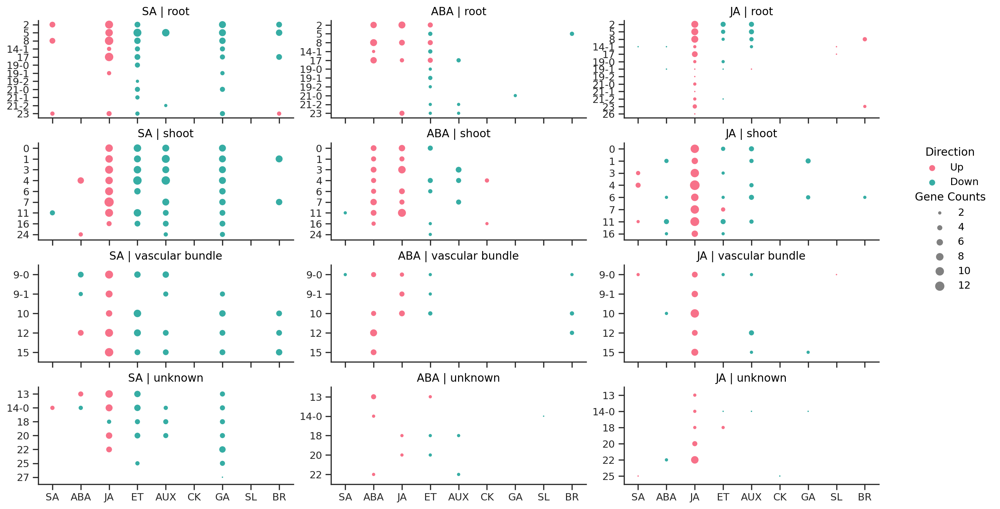

In [ ]:
p = (
    so.Plot(
        df_goResHormoneSyn.query("`P-value` < 0.05").query("Time == '3h'"),
        x="TermHormone",
        y="Cluster",
        color="Direction",
        pointsize="geneIn",
    )
    .facet(
        col="Hormone",
        row='Tissue',
        order={
            "col": [
                "SA",
                "ABA",
                "JA",
                # "ET"
            ],
            "row": ['root', 'shoot', 'vascular bundle', 'unknown']
        },
    )
    .share(x=True, y=False)
    .add(
        so.Dot(),
        so.Dodge(by=["fill"]),
    )
    .scale(
        x=so.Nominal(order=['SA', 'ABA', 'JA', 'ET', 'AUX', 'CK',  'GA', 'SL', 'BR', ]),
        pointsize=so.Continuous(values=(1, 10)).tick(every=2),
        color=so.Nominal(order=['Up', 'Down']),
    )
    .label(y="", x="", pointsize="Gene Counts")
    .layout(size=(14, 8), engine="constrained", extent=[0, 0, 0.95, 0.95])
)
fig = p.plot()._figure
# display(fig)
# plt.close()
# for i, ax in enumerate(fig.axes):
#     if i < 0:
#         # hide x ticklabels
#         ax.xaxis.set_tick_params(labelbottom=False)
#     else:
#         ax.set_xticklabels(ax.get_xticklabels(), rotation=-90, ha="center")
# soExt.mvLegToAx(fig, fig, 'center left', [0.9, 0.5])
fig

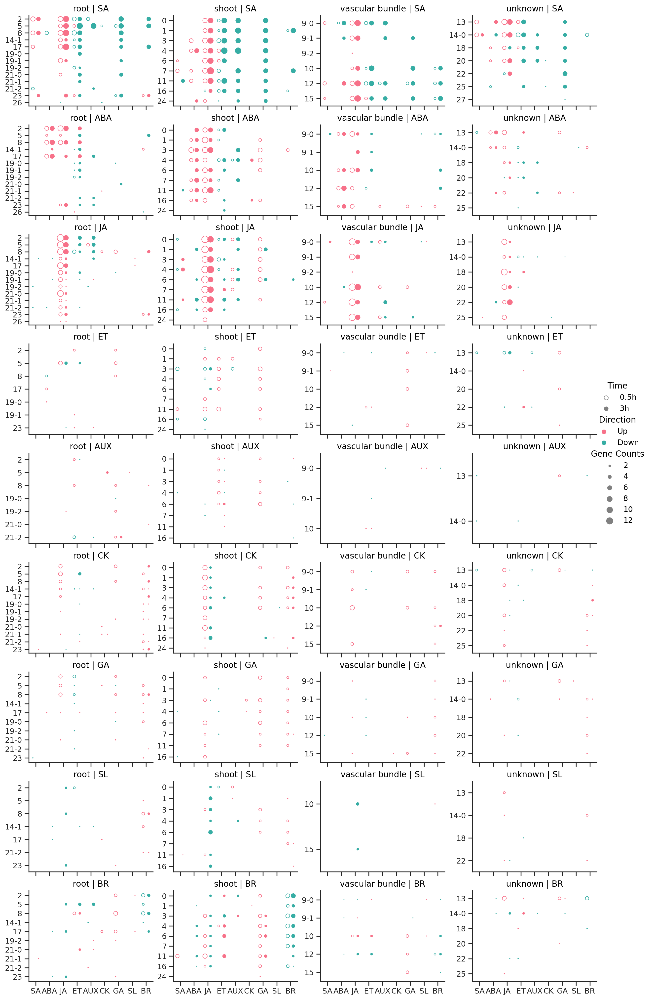

In [ ]:
p = (
    so.Plot(
        df_goResHormoneSyn.query("`P-value` < 0.05"),
        x="TermHormone",
        y="Cluster",
        fill="Time",
        color="Direction",
        pointsize="geneIn",
    )
    .facet(
        row="Hormone",
        col='Tissue',
        order={
            "row": [
'SA', 'ABA', 'JA', 'ET', 'AUX', 'CK',  'GA', 'SL', 'BR',
            ],
            "col": ['root', 'shoot', 'vascular bundle', 'unknown']
        },
    )
    .share(x=True, y=False)
    .add(
        so.Dot(),
        so.Dodge(by=["fill"]),
    )
    .scale(
        y1=so.Nominal(order=ls_order),
        x=so.Nominal(order=['SA', 'ABA', 'JA', 'ET', 'AUX', 'CK',  'GA', 'SL', 'BR', ]),
        pointsize=so.Continuous(values=(1, 10)).tick(every=2),
        fill=so.Nominal({'0.5h': False, '3h':True},order=['0.5h', '3h']),
    )
    .label(y="", x="", pointsize="Gene Counts")
    .layout(size=(12, 20), engine="constrained")
)
fig = p.plot()._figure
# display(fig)
# plt.close()
# for i, ax in enumerate(fig.axes):
#     if i < 0:
#         # hide x ticklabels
#         ax.xaxis.set_tick_params(labelbottom=False)
#     else:
#         ax.set_xticklabels(ax.get_xticklabels(), rotation=-90, ha="center")
# soExt.mvLegToAx(fig, fig, 'center left', [0.9, 0.5])
fig

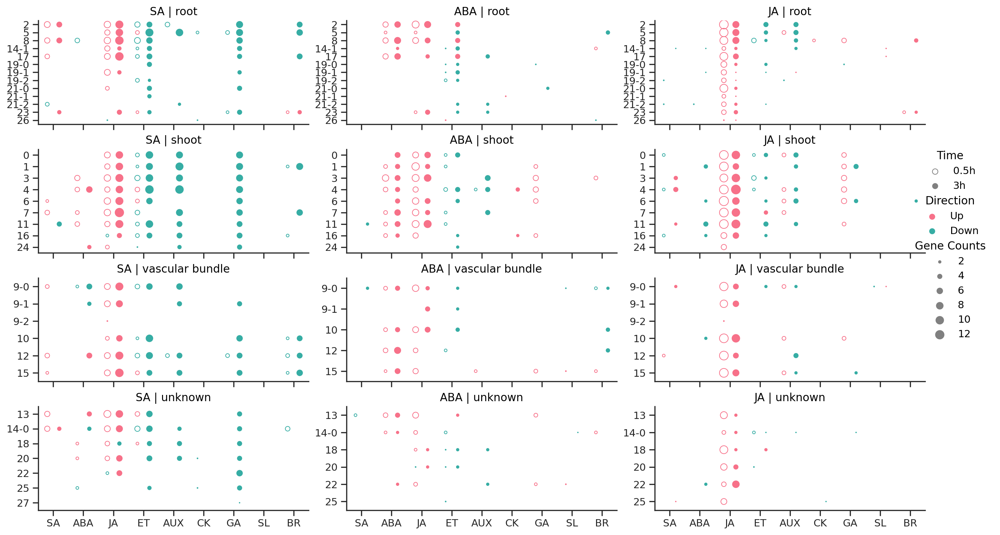

In [ ]:
p = (
    so.Plot(
        df_goResHormoneSyn.query("`P-value` < 0.05"),
        x="TermHormone",
        y="Cluster",
        fill="Time",
        color="Direction",
        pointsize="geneIn",
    )
    .facet(
        col="Hormone",
        row='Tissue',
        order={
            "col": [
                "SA",
                "ABA",
                "JA",
                # "ET"
            ],
            "row": ['root', 'shoot', 'vascular bundle', 'unknown']
        },
    )
    .share(x=True, y=False)
    .add(
        so.Dot(),
        so.Dodge(by=["fill"]),
    )
    .scale(
        y1=so.Nominal(order=ls_order),
        x=so.Nominal(order=['SA', 'ABA', 'JA', 'ET', 'AUX', 'CK',  'GA', 'SL', 'BR', ]),
        pointsize=so.Continuous(values=(1, 10)).tick(every=2),
        fill=so.Nominal({'0.5h': False, '3h':True},order=['0.5h', '3h']),
    )
    .label(y="", x="", pointsize="Gene Counts")
    .layout(size=(14, 8), engine="constrained")
)
fig = p.plot()._figure
# display(fig)
# plt.close()
# for i, ax in enumerate(fig.axes):
#     if i < 0:
#         # hide x ticklabels
#         ax.xaxis.set_tick_params(labelbottom=False)
#     else:
#         ax.set_xticklabels(ax.get_xticklabels(), rotation=-90, ha="center")
# soExt.mvLegToAx(fig, fig, 'center left', [0.9, 0.5])
fig

# Crosstalk

## smod (pb)

In [ ]:
from jpy_tools.overlapTools import GeneOverlapBase

In [ ]:
ead.uns["de_All_deg"] = ead.uns["de_All_deg"].assign(
    GeneCategory=lambda _: np.select(
        [
            (_.logFC > 1) & (_.fdr < 0.05),
            (_.logFC < -1) & (_.fdr < 0.05),
        ],
        ["Up", "Down"],
        "Others",
    )
)

In [ ]:
df_bulkLevelDeg = pd.concat(
    [
        ead.uns["de_All_deg"]
        .assign(
            Group=lambda _: _.Hormone.astype(str)
            + "_"
            + _.Time.astype(str)
            + "_"
            + "Up"
        )
        .assign(
            GeneCategory=lambda _: np.where(_.GeneCategory == "Up", "Target", "Others")
        ),
        ead.uns["de_All_deg"]
        .assign(
            Group=lambda _: _.Hormone.astype(str)
            + "_"
            + _.Time.astype(str)
            + "_"
            + "Down"
        )
        .assign(
            GeneCategory=lambda _: np.where(_.GeneCategory == "Down", "Target", "Others")
        ),
    ]
)

In [ ]:
gop_pb = GeneOverlapBase(df_bulkLevelDeg, 'gene', 'Group', 'GeneCategory', 'Target')

In [ ]:
gop_pb.getOverlapInfo(additionalTest=True)

100%|██████████| 1296/1296 [02:29<00:00,  8.68it/s]


In [ ]:
df_heatmap = gop_pb.df_overlapInfo.pivot_table(
    index="comp1", columns="comp2", values="smod", aggfunc="mean", fill_value=0
)

In [ ]:
ls_hormones = ['AUX', 'CK', 'ABA','GA', 'SL',  'BR', 'ET', 'JA', 'SA']
from itertools import product

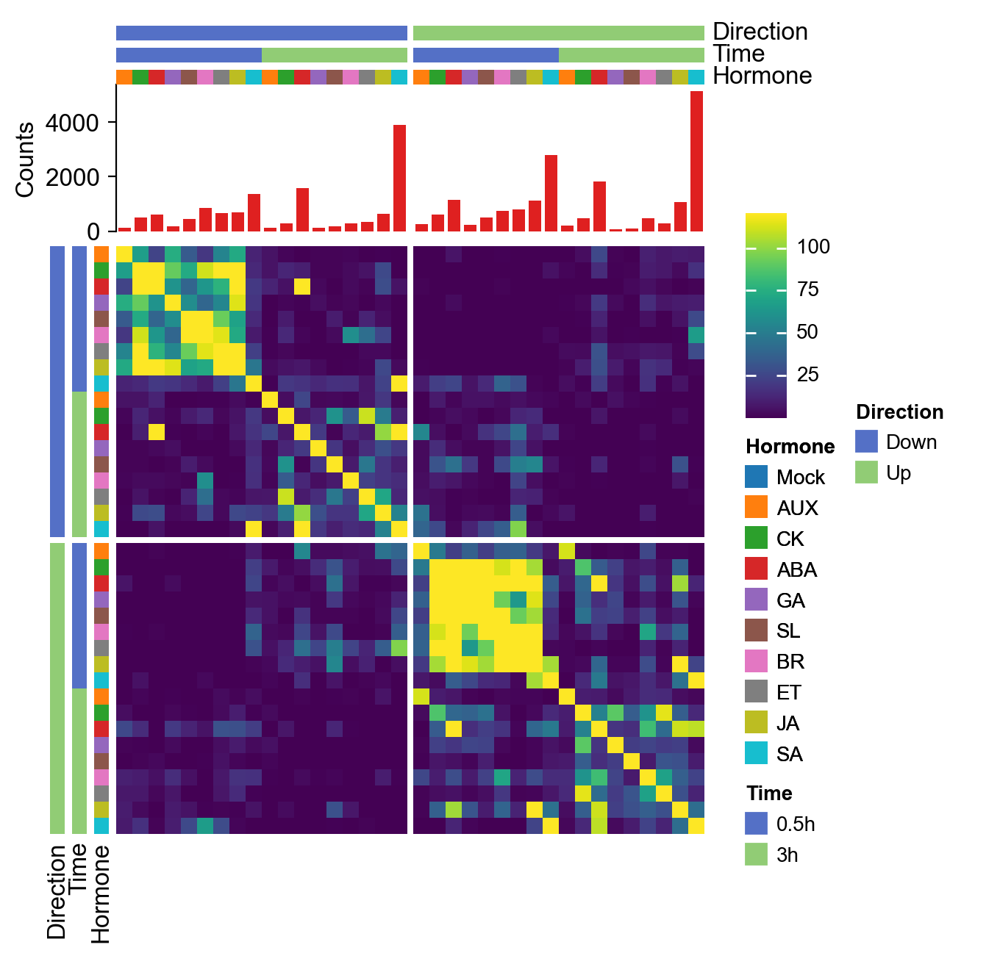

In [ ]:
df_overlapInfo = gop_pb.df_overlapInfo
df_color = df_overlapInfo.pivot_table(
    index="comp1", columns="comp2", values="smod"
).fillna(0)
df_cluster = df_overlapInfo.pivot_table(
    index="comp1", columns="comp2", values="smod"
).fillna(0)

df_color = df_color.reindex(
    index=product(
        ["Up", "Down"],
        ["0.5h", "3h"],
        ls_hormones,
    )
    >> F(map, lambda _: f"{_[2]}_{_[1]}_{_[0]}")
    >> F(list),
    columns=product(
        ["Up", "Down"],
        ["0.5h", "3h"],
        ls_hormones,
    )
    >> F(map, lambda _: f"{_[2]}_{_[1]}_{_[0]}")
    >> F(list),
)
h = ma.Heatmap(
    df_color.values, cmap='viridis', cluster_data=df_cluster.values, vmax=120
)


ls_order = df_color.index
df_counts = df_overlapInfo.query("comp1 == comp2").set_index('comp1').loc[ls_order, 'm'].to_frame().T
h.add_top(
    mp.Bar(df_counts, color='Red', label='Counts'), size=1, pad=0.1
)

h.add_top(
    mp.Colors(df_color.columns.str.split('_').str[0], label='Hormone', palette=ead.pl.getAdColors('Hormone')), size=0.1
)

h.add_top(
    mp.Colors(df_color.columns.str.split('_').str[1], label='Time'), size=0.1, pad=0.05
)

h.add_top(
    mp.Colors(df_color.columns.str.split('_').str[2], label='Direction'), size=0.1, pad=0.05
)

h.add_left(
    mp.Colors(df_color.index.str.split('_').str[0], label='Hormone', palette=ead.pl.getAdColors('Hormone')), size=0.1, legend=False, pad=0.05
)

h.add_left(
    mp.Colors(df_color.index.str.split('_').str[1], label='Time'), size=0.1, pad=0.05, legend=False
)

h.add_left(
    mp.Colors(df_color.index.str.split('_').str[2], label='Direction'), size=0.1, pad=0.05, legend=False
)
h.group_cols(df_color.columns.str.split('_').str[2])
h.group_rows(df_color.columns.str.split('_').str[2])
h.add_legends()
h.render()

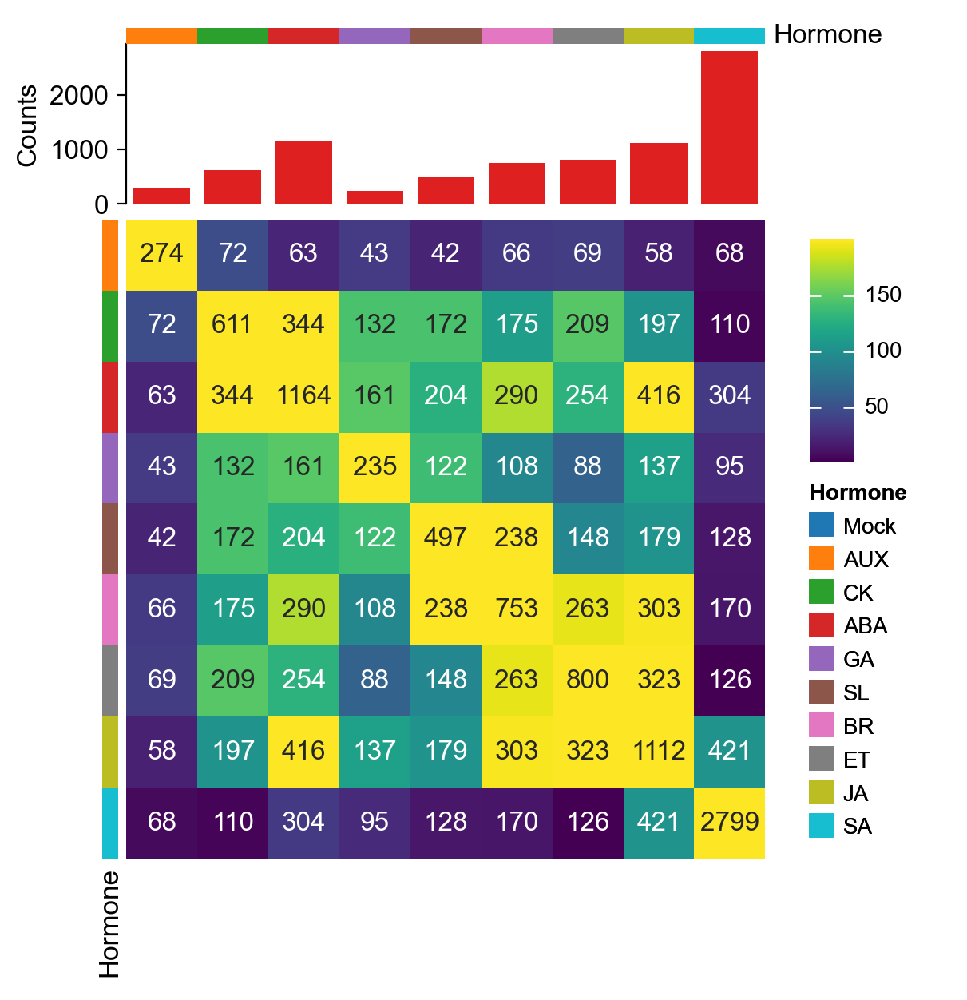

In [ ]:
df_overlapInfo = gop_pb.df_overlapInfo

df_overlapInfo = df_overlapInfo.query("comp1.str.contains('0.5h_Up') & comp2.str.contains('0.5h_Up')")
ls_order = [f"{x}_0.5h_Up" for x in ls_hormones]

df_color = df_overlapInfo.pivot_table(
    index="comp1", columns="comp2", values="smod"
).fillna(0)

df_opCounts = df_overlapInfo.pivot_table(
    index="comp1", columns="comp2", values="m"
).fillna(0)
df_color = df_color.rename(index=lambda _: _.split('_')[0], columns=lambda _: _.split('_')[0])
df_opCounts = df_opCounts.rename(index=lambda _: _.split('_')[0], columns=lambda _: _.split('_')[0])
df_color = df_color.loc[ls_hormones, ls_hormones]
df_opCounts = df_opCounts.loc[ls_hormones, ls_hormones]

h = ma.Heatmap(
    df_color.values, cmap='viridis', annot=df_opCounts.values, fmt=lambda _: int(_), vmax=200
)

df_counts = df_overlapInfo.query("comp1 == comp2").set_index('comp1').loc[ls_order, 'm'].to_frame().T
df_counts = df_counts.rename(index=lambda _: _.split('_')[0])
h.add_top(
    mp.Bar(df_counts, color='Red', label='Counts'), size=1, pad=0.1
)

h.add_top(
    mp.Colors(df_color.columns.str.split('_').str[0], label='Hormone', palette=ead.pl.getAdColors('Hormone')), size=0.1
)

h.add_left(
    mp.Colors(df_color.index.str.split('_').str[0], label='Hormone', palette=ead.pl.getAdColors('Hormone')), size=0.1, legend=False, pad=0.05
)



h.add_legends()
h.render()

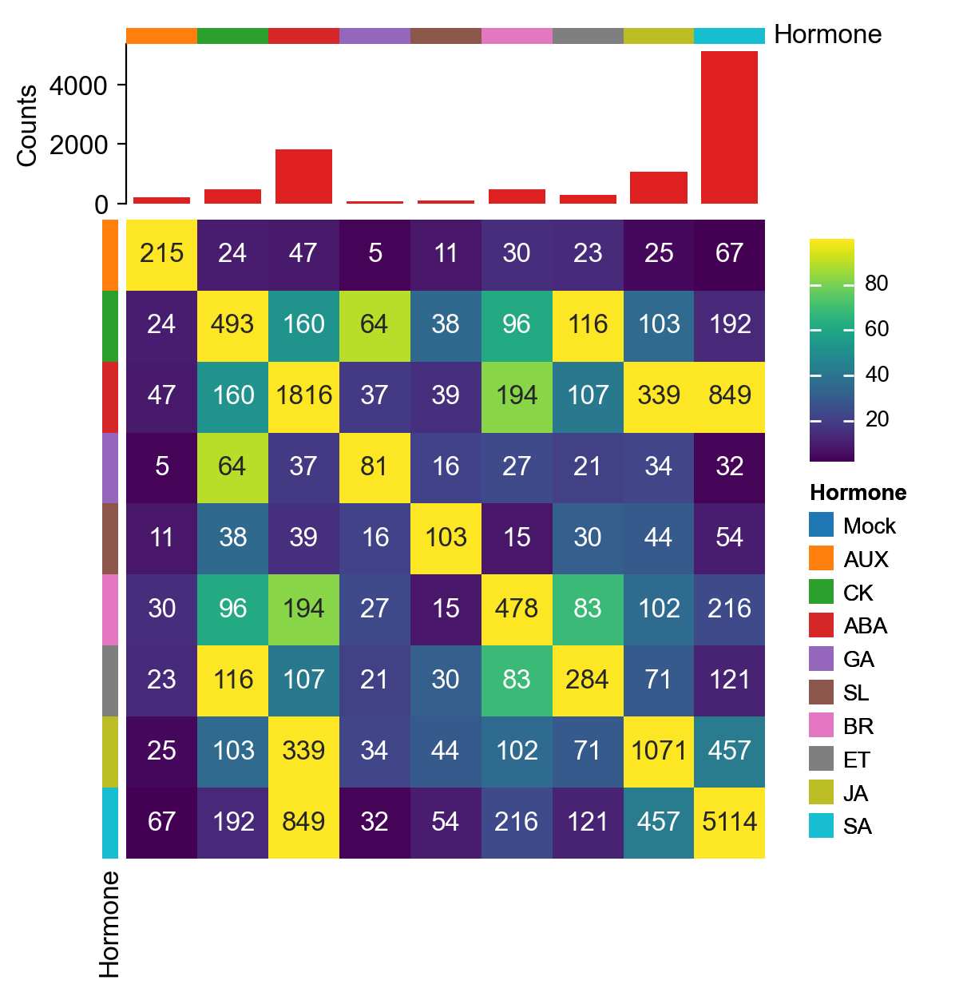

In [ ]:
df_overlapInfo = gop_pb.df_overlapInfo

df_overlapInfo = df_overlapInfo.query("comp1.str.contains('3h_Up') & comp2.str.contains('3h_Up')")
ls_order = [f"{x}_3h_Up" for x in ls_hormones]

df_color = df_overlapInfo.pivot_table(
    index="comp1", columns="comp2", values="smod"
).fillna(0)

df_opCounts = df_overlapInfo.pivot_table(
    index="comp1", columns="comp2", values="m"
).fillna(0)
df_color = df_color.rename(index=lambda _: _.split('_')[0], columns=lambda _: _.split('_')[0])
df_opCounts = df_opCounts.rename(index=lambda _: _.split('_')[0], columns=lambda _: _.split('_')[0])
df_color = df_color.loc[ls_hormones, ls_hormones]
df_opCounts = df_opCounts.loc[ls_hormones, ls_hormones]

h = ma.Heatmap(
    df_color.values, cmap='viridis', annot=df_opCounts.values, fmt=lambda _: int(_), vmax=100
)

df_counts = df_overlapInfo.query("comp1 == comp2").set_index('comp1').loc[ls_order, 'm'].to_frame().T
df_counts = df_counts.rename(index=lambda _: _.split('_')[0])
h.add_top(
    mp.Bar(df_counts, color='Red', label='Counts'), size=1, pad=0.1
)

h.add_top(
    mp.Colors(df_color.columns.str.split('_').str[0], label='Hormone', palette=ead.pl.getAdColors('Hormone')), size=0.1
)

h.add_left(
    mp.Colors(df_color.index.str.split('_').str[0], label='Hormone', palette=ead.pl.getAdColors('Hormone')), size=0.1, legend=False, pad=0.05
)



h.add_legends()
h.render()

## smod (Cluster)

In [ ]:
from jpy_tools.overlapTools import GeneOverlapBase

In [ ]:
ead.uns["de_Sample_deg"] = ead.uns["de_Sample_deg"].assign(
    GeneCategory=lambda _: np.select(
        [
            (_.logFC > 1) & (_.fdr < 0.05),
            (_.logFC < -1) & (_.fdr < 0.05),
        ],
        ["Up", "Down"],
        "Others",
    )
)

In [ ]:
df_clusterLevelDeg = pd.concat(
    [
        ead.uns["de_Sample_deg"]
        .assign(
            Group=lambda _: _.Hormone.astype(str)
            + "_"
            + _.Time.astype(str)
            + "_"
            + "Up"
        )
        .assign(
            GeneCategory=lambda _: np.where(_.GeneCategory == "Up", "Target", "Others")
        ),
        ead.uns["de_Sample_deg"]
        .assign(
            Group=lambda _: _.Hormone.astype(str)
            + "_"
            + _.Time.astype(str)
            + "_"
            + "Down"
        )
        .assign(
            GeneCategory=lambda _: np.where(_.GeneCategory == "Down", "Target", "Others")
        ),
    ]
)

In [ ]:
dtGop = {}
for cluster, _df in df_clusterLevelDeg.groupby('cluster'):
    gop_cluster = GeneOverlapBase(_df, 'gene', 'Group', 'GeneCategory', 'Target')
    gop_cluster.getOverlapInfo(additionalTest=False)
    dtGop[cluster] = gop_cluster

100%|██████████| 1296/1296 [00:01<00:00, 893.21it/s]


In [ ]:
def plotClusterSmodInDiffHormone(gop, title, addBar=True, vmax=100, needLegend=True, figsize=(6, 6)):
    ls_hormones = ["AUX", "CK", "ABA", "GA", "SL", "BR", "ET", "JA", "SA"]
    dt_color = {
        "AUX": "#ff7f0e",
        "CK": "#2ca02c",
        "ABA": "#d62728",
        "GA": "#9467bd",
        "SL": "#8c564b",
        "BR": "#e377c2",
        "ET": "#7f7f7f",
        "JA": "#bcbd22",
        "SA": "#17becf",
    }
    from itertools import product

    df_overlapInfo = gop.df_overlapInfo
    df_color = df_overlapInfo.pivot_table(
        index="comp1", columns="comp2", values="smod"
    ).fillna(0)
    df_cluster = df_overlapInfo.pivot_table(
        index="comp1", columns="comp2", values="smod"
    ).fillna(0)

    df_color = df_color.reindex(
        index=product(
            ["Up", "Down"],
            ["0.5h", "3h"],
            ls_hormones,
        )
        >> F(map, lambda _: f"{_[2]}_{_[1]}_{_[0]}")
        >> F(list),
        columns=product(
            ["Up", "Down"],
            ["0.5h", "3h"],
            ls_hormones,
        )
        >> F(map, lambda _: f"{_[2]}_{_[1]}_{_[0]}")
        >> F(list),
    )
    h = ma.Heatmap(
        df_color.values, cmap="viridis", cluster_data=df_cluster.values, vmax=vmax, height=figsize[0], width=figsize[1], name='smod'
    )

    ls_order = df_color.index
    df_counts = (
        df_overlapInfo.query("comp1 == comp2")
        .set_index("comp1")
        .loc[ls_order, "m"]
        .to_frame()
        .T
    )
    if addBar:
        h.add_top(mp.Bar(df_counts, color="Red", label="Counts"), size=1, pad=0.1,)

    h.add_top(
        mp.Colors(
            df_color.columns.str.split("_").str[0], label="Hormone", palette=dt_color
        ),
        size=0.1,
        name='hormone'
    )

    h.add_top(
        mp.Colors(df_color.columns.str.split("_").str[1], label="Time"),
        size=0.1,
        pad=0.05,
        name='time'
    )

    h.add_top(
        mp.Colors(df_color.columns.str.split("_").str[2], label="Direction"),
        size=0.1,
        pad=0.05,
        name='direction'
    )

    h.add_left(
        mp.Colors(
            df_color.index.str.split("_").str[0], label="Hormone", palette=dt_color
        ),
        size=0.1,
        legend=False,
        pad=0.05,
    )

    h.add_left(
        mp.Colors(df_color.index.str.split("_").str[1], label="Time"),
        size=0.1,
        pad=0.05,
        legend=False,
    )

    h.add_left(
        mp.Colors(df_color.index.str.split("_").str[2], label="Direction"),
        size=0.1,
        pad=0.05,
        legend=False,
    )
    h.group_cols(df_color.columns.str.split("_").str[2])
    h.group_rows(df_color.columns.str.split("_").str[2])
    if needLegend:
        h.add_legends()
    h.add_top(mp.Title(title))
    return h

In [ ]:
# from jpy_tools.otherTools import FigConcate, FigConcateWrap
# figw = FigConcateWrap()
# for cluster, gop in dtGop.items():
#     h = plotClusterSmodInDiffHormone(gop, f"Cluster {cluster}")
#     h.render()
#     plt.close()
#     fig = h.figure
#     figw.addFig(FigConcate(fig))


In [ ]:
from jpy_tools.otherTools import FigConcate, FigConcateWrap
figw = FigConcateWrap()
for cluster, gop in dtGop.items():
    h = plotClusterSmodInDiffHormone(gop, f"Cluster {cluster}")
    h.render()
    plt.close()
    fig = h.figure
    figw.addFig(FigConcate(fig))


In [ ]:
figw.wrapAndGenerate(4).show([40,40])

## clustering based on p-value

In [ ]:
from itertools import combinations, product, permutations

In [ ]:
ls_usedVs = []
for x, y in permutations(product(["AUX", "CK", "ABA", "GA", "SL", "BR", "ET", "JA", "SA"], ['0.5h', '3h'], ['Up', 'Down']), 2):
    x = '_'.join(x)
    y = '_'.join(y)
    z = x + ' vs ' + y
    ls_usedVs.append(z)

In [ ]:
usedIndex = 'qmod'

_ls = []
for cluster, gop in dtGop.items():
    _sr = gop.df_overlapInfo.assign(
        vs = lambda x: x['comp1'].astype(str) + ' vs ' + x['comp2'].astype(str)
    ).query('vs in @ls_usedVs', engine='python').set_index('vs')[usedIndex].rename(cluster)
    _ls.append(_sr)
df_wideClusterCrosstalk = pd.concat(_ls, axis=1).T.fillna(0)

In [ ]:
df_wideClusterCrosstalk = df_wideClusterCrosstalk.apply(
    lambda _:( _ - _.mean()) / _.std(),
)

In [ ]:
df_wideClusterCrosstalk = df_wideClusterCrosstalk.dropna(axis=1)

In [ ]:
dt_tissueLevel =  {
    "root": [
        # Root-related
        "5",       # Root Apical Meristem
        "14-1",    # Root Cap
        "21-0", "21-2", "2", "21-1",  # Root Epidermal Cell
        "19-0", "19-2", "8",         # Root Cortex
        "19-1", "17", "26", "23"     # Root Endodermis
    ],
    "shoot": [
        # Shoot-related
        "6",       # Shoot Apical Meristem
        "3", "4",  # Shoot Epidermal Cell
        "24",      # Guard Cell
        "0", "1", "7", "11", "16"  # Mesophyll Cell
    ],
    "vascular bundle": [
        # 与维管系统相关
        "15", "12",      # Pericycle
        "9-0", "9-1",    # Procambium
        "10",            # Phloem
        "9-2"            # Xylem
    ],
    "unknown": [
        # 无法明确归入 root / shoot / vascular bundle 的
        "20", "18", "25",          # Proliferating Cell
        "13", "14-0", "22", "27"   # Unknown
    ]
}
# ls_palette = ls_palette
ls_palette = [
    "#f08080",
    "#98fb98",
    "#ffd700",
    "#708090",
]
dt_cl2tissue = {cl: tissue for tissue, cls in dt_tissueLevel.items() for cl in cls}
dt_palette={x: y for x, y in zip(dt_tissueLevel.keys(), ls_palette)}

In [ ]:
dt_clusteringBasedOnCrosstalk = {}
i=1
for x in [
    [13, 16, 1, 11, 3],
    [4, 6, 0],
    [7],
    ["14-1", "14-0", "2", "8", "24"],
    [27, "9-2", "19-1", "19-2", "21-2", "21-1", "26", "15"],
    ["9-0", "23", "12", "17"],
    ["22", "10", "5", "9-1", "19-0", "21-0", "25", "18", "20"],
]:
    for y in x:
        dt_clusteringBasedOnCrosstalk[str(y)] = str(i)
    i += 1

In [ ]:
df_wideClusterCrosstalk.index

Index(['0', '1', '10', '11', '12', '13', '14-0', '14-1', '15', '16', '17',
       '18', '19-0', '19-1', '19-2', '2', '20', '21-0', '21-1', '21-2', '22',
       '23', '24', '25', '26', '27', '3', '4', '5', '6', '7', '8', '9-0',
       '9-1', '9-2'],
      dtype='object')

In [ ]:
# h.add_legends(side='left', stack_size=2, order=['hormone', 'time', 'direction', 'smod'])
# h.render()

In [ ]:
from jpy_tools.otherTools import FigConcate, FigConcateWrap
figw = FigConcateWrap()
for cluster, vmax, module in zip(['1', '4', '7', '24', '15', '23', '25'], [50] * 7, range(1,8)):
    gop = dtGop[cluster]
    h = plotClusterSmodInDiffHormone(gop, f"M{module}: Cluster {cluster}", False, vmax, False, (2,2))
    # if cluster == '25':
    #     h.add_legends()
    h.render()
    plt.close()
    fig = h.figure
    figw.addFig(FigConcate(fig))

figw.wrapAndGenerate(4).show([40,40])

### find the most cross-talked hormone pair

In [ ]:
ls_usedVs = []
for x, y in combinations(product(["AUX", "CK", "ABA", "GA", "SL", "BR", "ET", "JA", "SA"], ['0.5h', '3h'], ['Up', 'Down']), 2):
    x = '_'.join(x)
    y = '_'.join(y)
    z = x + ' vs ' + y
    ls_usedVs.append(z)

In [ ]:
usedIndex = 'smod'

_ls = []
for cluster, gop in dtGop.items():
    _sr = gop.df_overlapInfo.assign(
        vs = lambda x: x['comp1'].astype(str) + ' vs ' + x['comp2'].astype(str)
    ).query('vs in @ls_usedVs', engine='python').set_index('vs')[usedIndex].rename(cluster)
    _ls.append(_sr)
df_wideClusterCrosstalk = pd.concat(_ls, axis=1).T.fillna(0)

In [ ]:
df_wideClusterCrosstalk = df_wideClusterCrosstalk.loc[
    :,
    ~df_wideClusterCrosstalk.columns.map(
        lambda _: _.split(" vs ")[0].split("_")[0] == _.split(" vs ")[1].split("_")[0]
    ),
]

In [ ]:
df_wideClusterCrosstalk = df_wideClusterCrosstalk.rank(axis=1, method='first', ascending=False)

In [ ]:
df_wideClusterCrosstalkSame = df_wideClusterCrosstalk.loc[
    :,
    df_wideClusterCrosstalk.columns.map(
        lambda _: _.split(" vs ")[0].split("_")[2] == _.split(" vs ")[1].split("_")[2]
    ),
]

In [ ]:
df_wideClusterCrosstalkSameForRank = df_wideClusterCrosstalkSame.median(0).rename(
    "medianCounts"
).sort_values().reset_index().assign(
    time1=lambda x: x["vs"].str.split(" vs ").str[0].str.split("_").str[1],
    time2=lambda x: x["vs"].str.split(" vs ").str[1].str.split("_").str[1],
    hormone1=lambda x: x["vs"].str.split(" vs ").str[0].str.split("_").str[0],
    hormone2=lambda x: x["vs"].str.split(" vs ").str[1].str.split("_").str[0],
).assign(
    time=lambda _: np.select(
        [
            (_.time1 == _.time2) & (_.time1 == '0.5h'),
            (_.time1 == _.time2) & (_.time1 == '3h'),
            (_.time1 != _.time2) ,
        ],
        ['0.5h vs 0.5h', '3h vs 3h', '0.5h vs 3h'],
    )
)
df_wideClusterCrosstalkSameForRank['rank'] = range(1, df_wideClusterCrosstalkSameForRank.shape[0] + 1)

In [ ]:
df_wideClusterCrosstalkDiff = df_wideClusterCrosstalk.loc[
    :,
    df_wideClusterCrosstalk.columns.map(
        lambda _: _.split(" vs ")[0].split("_")[2] != _.split(" vs ")[1].split("_")[2]
    ),
]

In [ ]:
df_wideClusterCrosstalkDiffForRank = df_wideClusterCrosstalkDiff.median(0).rename(
    "medianCounts"
).sort_values().reset_index().assign(
    time1=lambda x: x["vs"].str.split(" vs ").str[0].str.split("_").str[1],
    time2=lambda x: x["vs"].str.split(" vs ").str[1].str.split("_").str[1],
    hormone1=lambda x: x["vs"].str.split(" vs ").str[0].str.split("_").str[0],
    hormone2=lambda x: x["vs"].str.split(" vs ").str[1].str.split("_").str[0],
).assign(
    time=lambda _: np.select(
        [
            (_.time1 == _.time2) & (_.time1 == '0.5h'),
            (_.time1 == _.time2) & (_.time1 == '3h'),
            (_.time1 != _.time2) ,
        ],
        ['0.5h vs 0.5h', '3h vs 3h', '0.5h vs 3h'],
    )
)
df_wideClusterCrosstalkDiffForRank['rank'] = range(1, df_wideClusterCrosstalkDiffForRank.shape[0] + 1)

In [ ]:
df_wideClusterCrosstalkForRank = pd.concat(
    [df_wideClusterCrosstalkSameForRank.assign(Type='Synergistic'), df_wideClusterCrosstalkDiffForRank.assign(Type='Antagonistic ')]
).reset_index(drop=True)

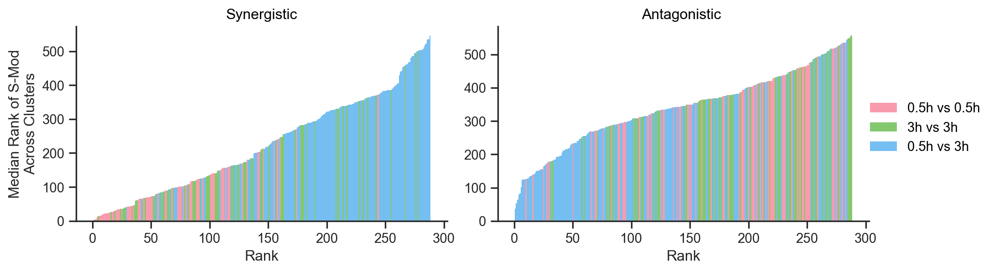

In [ ]:
(
    so.Plot(df_wideClusterCrosstalkForRank, x='rank', y='medianCounts', color='time')
    .facet(col='Type')
    .share(x=False, y=False)
    .add(so.Bars(edgewidth=0))
    .scale(color=so.Nominal(order=['0.5h vs 0.5h', '3h vs 3h', '0.5h vs 3h']))
    .label(x='Rank', y='Median Rank of S-Mod\nAcross Clusters', color='')
    .layout(size=(10, 3), engine='constrained')
)

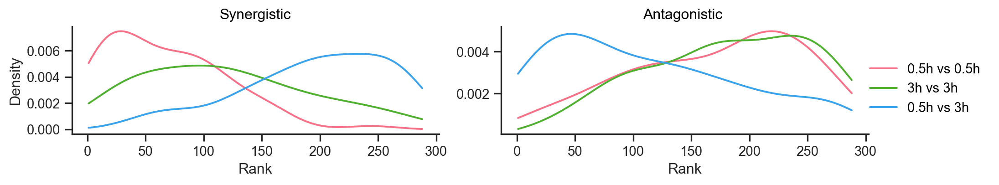

In [ ]:
(
    so.Plot(df_wideClusterCrosstalkForRank, x='rank', color='time')
    .facet(col='Type')
    .share(x=True, y=False)
    .add(so.Line(), so.KDE(cut=0, common_norm=False))
    .scale(color=so.Nominal(order=['0.5h vs 0.5h', '3h vs 3h', '0.5h vs 3h']), y=so.Continuous().tick(every=0.002))
    .label(x='Rank',color='', y='Density')
    .layout(size=(10, 2), engine='constrained')
)

In [ ]:
def _parse(x):
    a, b = x.split(' vs ')
    a_h, a_t, a_d = a.split('_')
    b_h, b_t, b_d = b.split('_')
    return f"{a_h} ({a_t}, {a_d}) vs {b_h} ({b_t}, {b_d})"

In [ ]:
df_wideClusterCrosstalkForRank.query("Type == 'Synergistic' & (hormone1 == 'ABA' & hormone2 == 'SA') ")

,vs,medianCounts,time1,time2,hormone1,hormone2,time,rank,Type
0,ABA_3h_Down vs SA_3h_Down,2.0,3h,3h,ABA,SA,3h vs 3h,1,Synergistic
27,ABA_3h_Up vs SA_3h_Up,40.0,3h,3h,ABA,SA,3h vs 3h,28,Synergistic
49,ABA_0.5h_Up vs SA_0.5h_Up,72.0,0.5h,0.5h,ABA,SA,0.5h vs 0.5h,50,Synergistic
50,ABA_0.5h_Down vs SA_0.5h_Down,73.0,0.5h,0.5h,ABA,SA,0.5h vs 0.5h,51,Synergistic
56,ABA_3h_Up vs SA_0.5h_Up,81.0,3h,0.5h,ABA,SA,0.5h vs 3h,57,Synergistic
71,ABA_3h_Down vs SA_0.5h_Down,99.0,3h,0.5h,ABA,SA,0.5h vs 3h,72,Synergistic
114,ABA_0.5h_Down vs SA_3h_Down,158.0,0.5h,3h,ABA,SA,0.5h vs 3h,115,Synergistic
133,ABA_0.5h_Up vs SA_3h_Up,181.0,0.5h,3h,ABA,SA,0.5h vs 3h,134,Synergistic


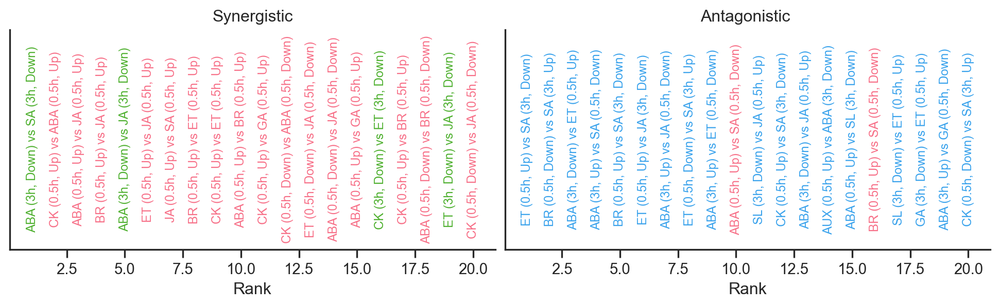

In [ ]:
_df = df_wideClusterCrosstalkForRank.query("rank <= 20")
_df = _df.assign(yloc=0.5, vs=_df['vs'].map(_parse))


p = (
    so.Plot(_df, x='rank', y='yloc', text='vs', color='time')
    .facet(col='Type')
    # .share(x=True, y=False)
    .add(so.Text(fontsize=9, artist_kws={'rotation': 90, 'ha': 'center',}, valign='center'))
    .scale(color=so.Nominal(order=['0.5h vs 0.5h', '3h vs 3h', '0.5h vs 3h']), y=so.Continuous().tick(count=0))
    .label(x='Rank',color='', y='')
    .layout(size=(10, 3), engine='constrained')
    .theme(dt_snsStyle)
).plot()
# for ax in fig.axes:
#     ax.spines['left'].set_visible(False)
p

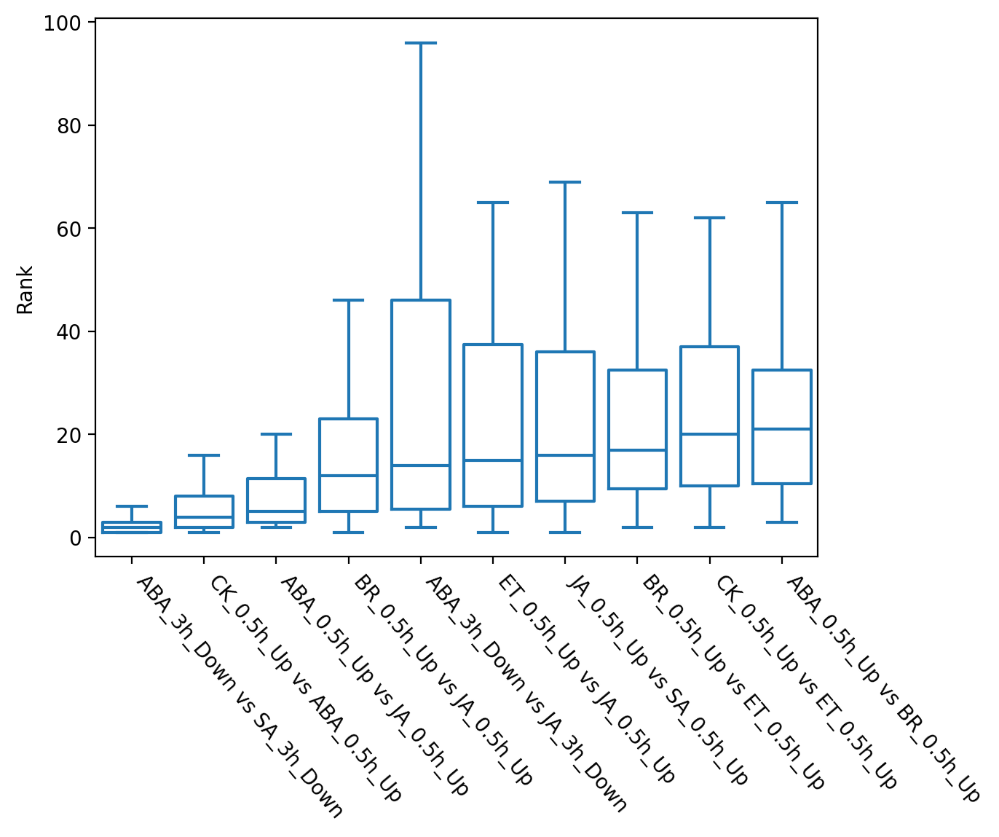

In [ ]:
df_wideClusterCrosstalkSame = df_wideClusterCrosstalk.loc[
    :,
    df_wideClusterCrosstalk.columns.map(
        lambda _: _.split(" vs ")[0].split("_")[2] == _.split(" vs ")[1].split("_")[2]
    ),
]
_ls = df_wideClusterCrosstalkSame.median(0).sort_values().iloc[:10].index
_df = (
    df_wideClusterCrosstalkSame[_ls]
    .melt(var_name="HormonePair", value_name="Rank", ignore_index=False)
    .sort_values("Rank")
    .rename_axis("Cluster")
    .reset_index()
).assign(
    HormonePair=lambda _: _.HormonePair.astype('category').cat.set_categories(_ls)
)
sns.boxplot(data=_df, x="HormonePair", y="Rank", fill=False, showfliers=False)
ax = plt.gca()
ax.set_xticklabels(ax.get_xticklabels(), rotation=-50, ha='left')
ax.set_xlabel("")
plt.show()

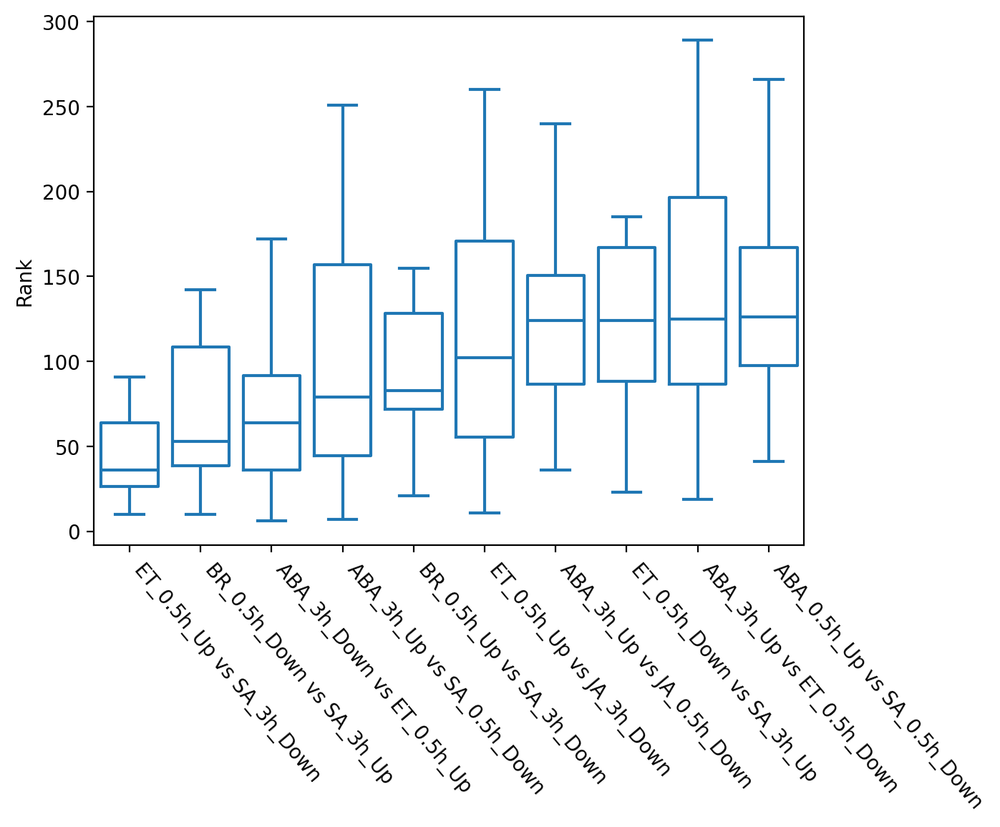

In [ ]:
df_wideClusterCrosstalkDiff = df_wideClusterCrosstalk.loc[
    :,
    df_wideClusterCrosstalk.columns.map(
        lambda _: _.split(" vs ")[0].split("_")[2] != _.split(" vs ")[1].split("_")[2]
    ),
]
_ls = df_wideClusterCrosstalkDiff.median(0).sort_values().iloc[:10].index
_df = (
    df_wideClusterCrosstalkDiff[_ls]
    .melt(var_name="HormonePair", value_name="Rank", ignore_index=False)
    .sort_values("Rank")
    .rename_axis("Cluster")
    .reset_index()
).assign(
    HormonePair=lambda _: _.HormonePair.astype('category').cat.set_categories(_ls)
)
sns.boxplot(data=_df, x="HormonePair", y="Rank", fill=False, showfliers=False)
ax = plt.gca()
ax.set_xticklabels(ax.get_xticklabels(), rotation=-50, ha='left')
ax.set_xlabel("")
plt.show()

# Three or more hormone crosstalk

In [ ]:
ead.uns["de_All_deg"] = ead.uns["de_All_deg"].assign(
    GeneCategory=lambda _: np.select(
        [
            (_.logFC > 1) & (_.fdr < 0.05),
            (_.logFC < -1) & (_.fdr < 0.05),
        ],
        ["Up", "Down"],
        "Others",
    )
)

In [ ]:
df_deg = ead.uns["de_Sample_deg"].query('GeneCategory != "Others"').query("Time == '0.5h'")

In [ ]:
df_deg = df_deg.assign(
    gene_direction=lambda _: _.gene + "_" + _.GeneCategory
)

In [ ]:
_ls = []
for cluster in df_deg['cluster'].unique():
    _df = df_deg.query("cluster == @cluster", engine='python')
    _size = len(set(_df['gene_direction']))
    _sr_counts = _df.value_counts('gene_direction')
    for i in range(1, 10):
        notLessThan = len(_sr_counts[_sr_counts >= i].index)
        _ls.append([cluster, i, notLessThan, _size])
df_aucRawData = pd.DataFrame(_ls, columns=['cluster', 'Rank', 'Counts', 'Size'])

# calc auc
ls_auc = []
for cluster in df_deg['cluster'].unique():
    _sr = df_aucRawData.query("cluster == @cluster", engine='python').set_index("Rank")['Counts']
    _size = df_aucRawData.query("cluster == @cluster", engine="python").iloc[0, 3]
    _auc = 0
    for i in range(1, 9):
        _auc += (_sr[i] + _sr[i+1]) / 2 / _size / 8
        _auc = round(_auc, 3)
        # print(cluster, i, _auc)
    ls_auc.append([cluster,  _auc, _size, f"AUC={_auc}"])
df_auc = pd.DataFrame(ls_auc, columns=['cluster', 'AUC', 'Size', 'AUC_text'])  
df_auc['x'] = 7

In [ ]:
df_aucRawData = df_aucRawData.assign(ratio = df_aucRawData.groupby('cluster')['Counts'].transform(lambda _: _ / _.max()))

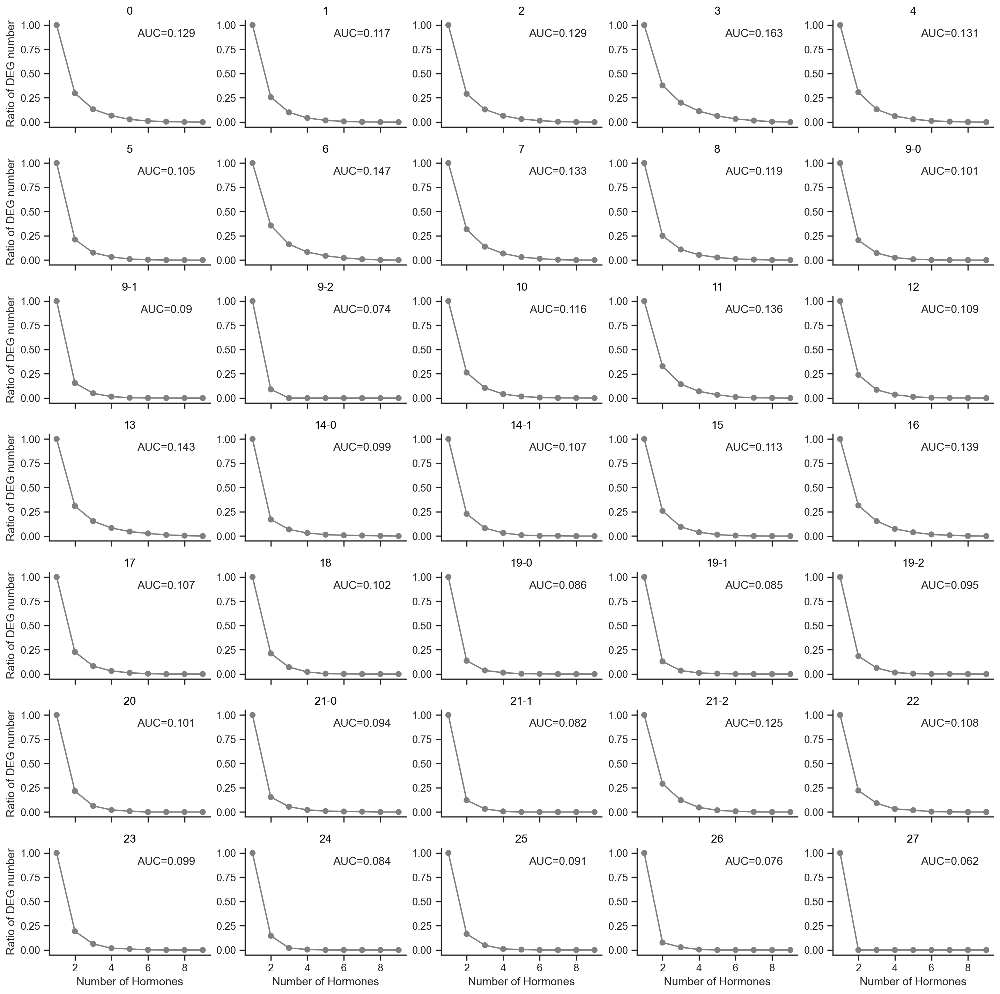

In [ ]:
(
    so.Plot(df_aucRawData, x='Rank', y='ratio')
    .facet('cluster', wrap=5)
    .share(y=False)
    .add(so.Line())
    .add(so.Dot())
    .add(so.Text(valign='top', ), text='AUC_text', data=df_auc.assign(Size=1), x='x', y='Size', col='cluster')
    .label(x='Number of Hormones', y='Ratio of DEG number')
    .layout(size=(15,15))
    .scale(x=so.Continuous().tick(every=2))
)

In [ ]:
_dt = df_auc.set_index('cluster')['AUC'].to_dict()
ead.obs['05h_AUC'] = ead.obs['Cluster_ft'].map(_dt)

2025-06-16 17:23:44.260 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.8938888888888888


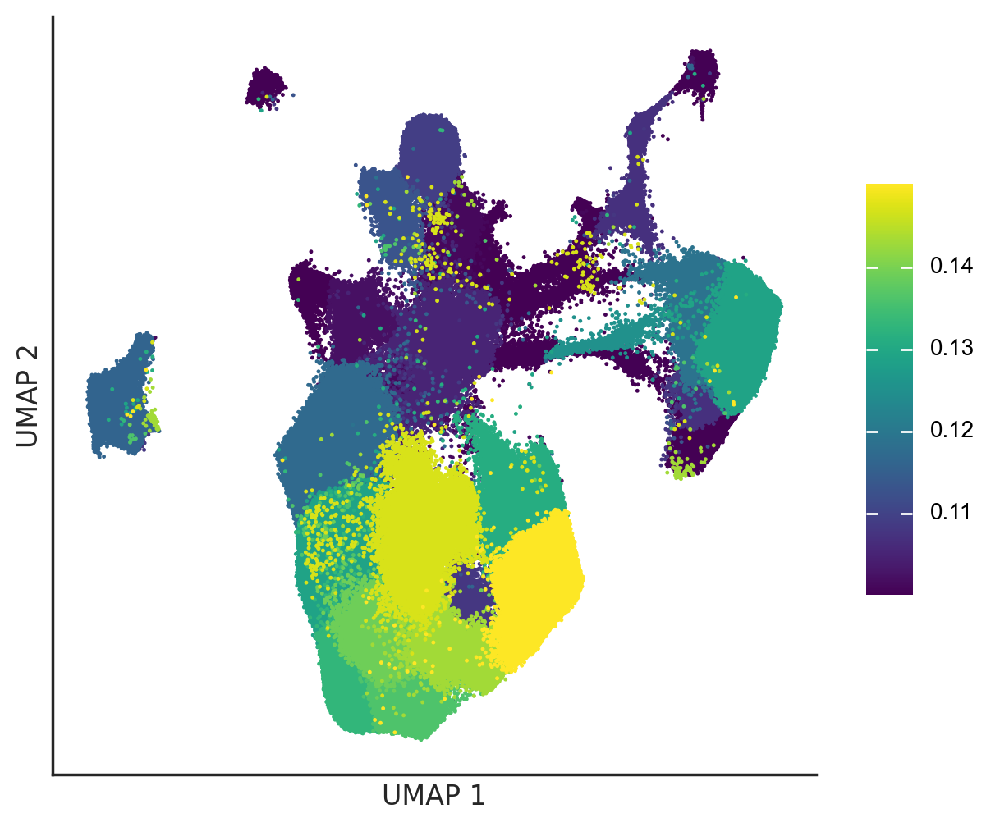

In [ ]:
ead.pl.embedding(color='05h_AUC', size=1, cmap='viridis',vmin=0.1, vmax=0.15, figsize=(6,6), title='')

In [ ]:
df_deg = ead.uns["de_Sample_deg"].query('GeneCategory != "Others"').query("Time == '3h'")

In [ ]:
df_deg = df_deg.assign(
    gene_direction=lambda _: _.gene + "_" + _.GeneCategory
)

In [ ]:
_ls = []
for cluster in df_deg['cluster'].unique():
    _df = df_deg.query("cluster == @cluster", engine='python')
    _size = len(set(_df['gene_direction']))
    _sr_counts = _df.value_counts('gene_direction')
    for i in range(1, 10):
        notLessThan = len(_sr_counts[_sr_counts >= i].index)
        _ls.append([cluster, i, notLessThan, _size])
df_aucRawData = pd.DataFrame(_ls, columns=['cluster', 'Rank', 'Counts', 'Size'])

# calc auc
ls_auc = []
for cluster in df_deg['cluster'].unique():
    _sr = df_aucRawData.query("cluster == @cluster", engine='python').set_index("Rank")['Counts']
    _size = df_aucRawData.query("cluster == @cluster", engine="python").iloc[0, 3]
    _auc = 0
    for i in range(1, 9):
        _auc += (_sr[i] + _sr[i+1]) / 2 / _size / 8
        _auc = round(_auc, 3)
        # print(cluster, i, _auc)
    ls_auc.append([cluster,  _auc, _size, f"AUC={_auc}"])
df_auc = pd.DataFrame(ls_auc, columns=['cluster', 'AUC', 'Size', 'AUC_text'])  
df_auc['x'] = 7

In [ ]:
df_aucRawData = df_aucRawData.assign(ratio = df_aucRawData.groupby('cluster')['Counts'].transform(lambda _: _ / _.max()))

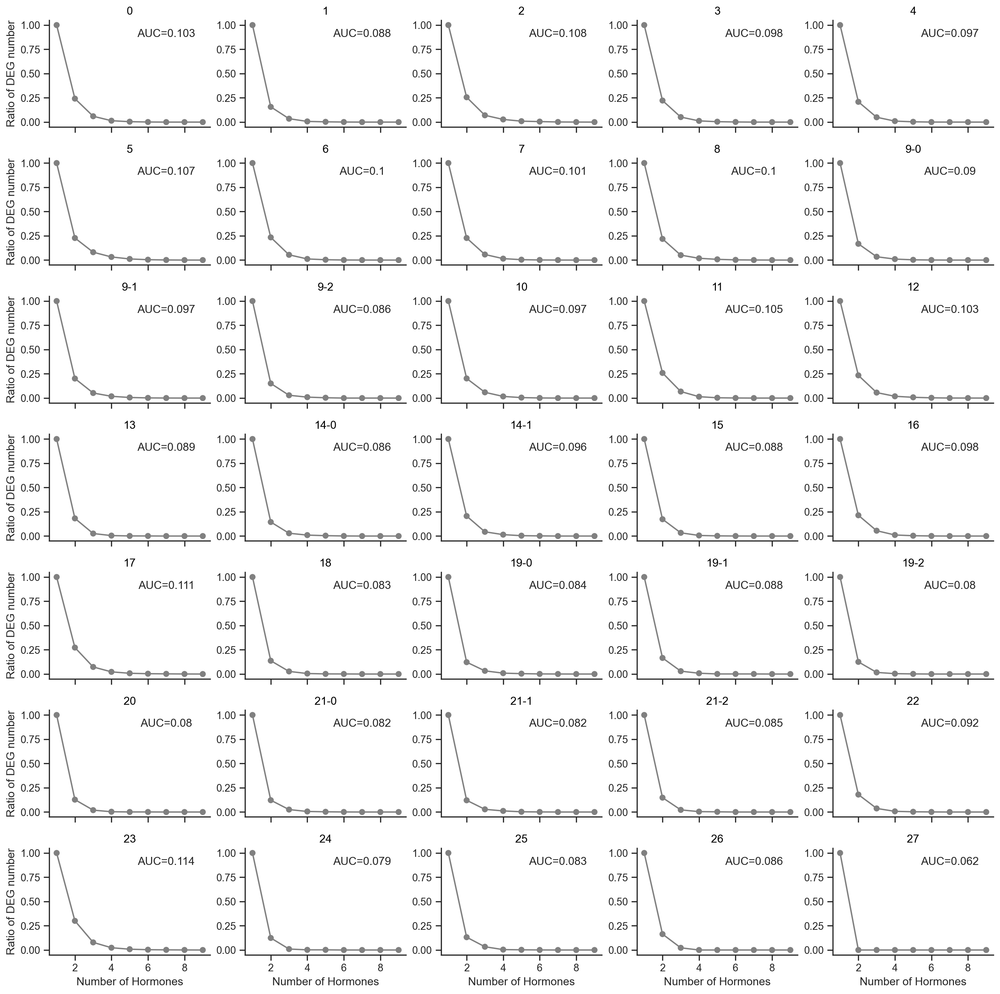

In [ ]:
(
    so.Plot(df_aucRawData, x='Rank', y='ratio')
    .facet('cluster', wrap=5)
    .share(y=False)
    .add(so.Line())
    .add(so.Dot())
    .add(so.Text(valign='top', ), text='AUC_text', data=df_auc.assign(Size=1), x='x', y='Size', col='cluster')
    .label(x='Number of Hormones', y='Ratio of DEG number')
    .layout(size=(15,15))
    .scale(x=so.Continuous().tick(every=2))
)

In [ ]:
_dt = df_auc.set_index('cluster')['AUC'].to_dict()
ead.obs['3h_AUC'] = ead.obs['Cluster_ft'].map(_dt)

2025-06-16 17:24:49.695 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.8938888888888888


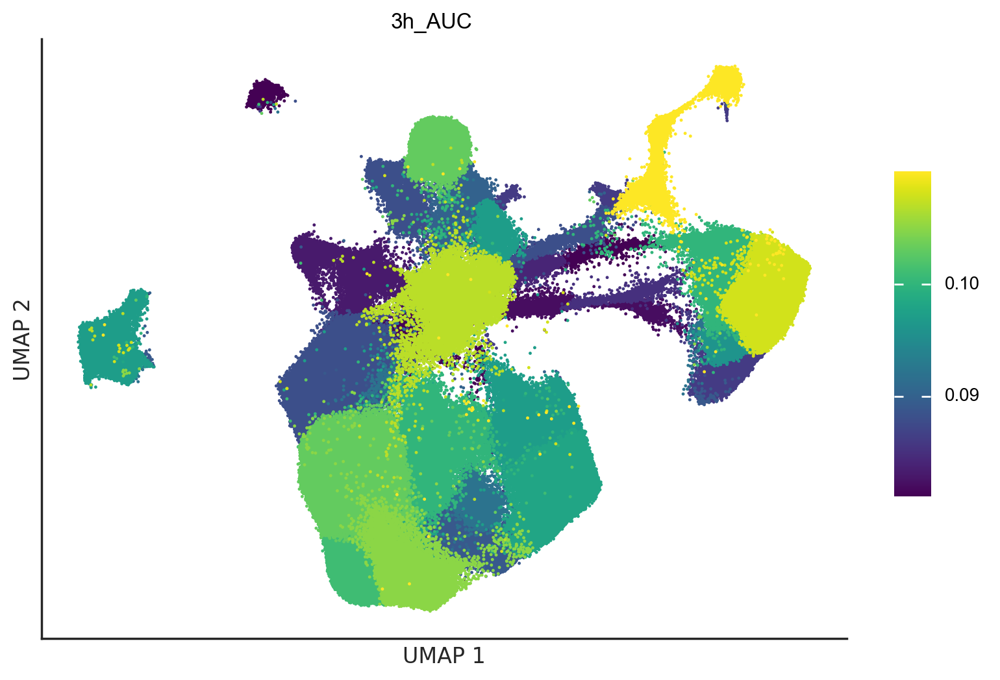

In [ ]:
ead.pl.embedding(color='3h_AUC', size=1, cmap='viridis',vmin=0.081, vmax=0.11)

# prepare output for miniex

In [ ]:
def prepareOutputForMiniex(ead, dir_miniex, prefix, clusterKey, annoKey, layer="raw", geneDiffLayer='normalize_log'):
    import pyarrow as pa
    import pyarrow.csv as csv
    import os

    df_allCount = ead.ad.T.to_df(layer)
    df_allCount.rename_axis('geneid', inplace=True)
    a = df_allCount.reset_index()
    a.to_feather(f"{dir_miniex}/{prefix}_matrix.feather")
    logger.info(f"Saved {dir_miniex}/{prefix}_matrix.feather")

    new_pa_dataframe = pa.Table.from_pandas(a)
    csv.write_csv(
        new_pa_dataframe,
        f"{dir_miniex}/{prefix}_matrix.tsv.1",
        write_options=csv.WriteOptions(delimiter="\t", include_header=False, quoting_style="none"),
    )
    df_allCount.head(0).to_csv(f"{dir_miniex}/{prefix}_matrix.tsv.2", sep="\t")
    os.system(
        f"cat {dir_miniex}/{prefix}_matrix.tsv.2 {dir_miniex}/{prefix}_matrix.tsv.1 > {dir_miniex}/{prefix}_matrix.tsv"
    )
    os.system(
        f"rm {dir_miniex}/{prefix}_matrix.tsv.1 {dir_miniex}/{prefix}_matrix.tsv.2"
    )
    logger.info(f"Saved {dir_miniex}/{prefix}_matrix.tsv")

    sc.tl.rank_genes_groups(
        ead.ad,
        groupby=f"{clusterKey}",
        method="wilcoxon",
        layer=geneDiffLayer,
        use_raw=False,
        pts=True,
        key_added=f"{clusterKey}_rank_genes",
    )
    df_markers = sc.get.rank_genes_groups_df(ead.ad, None, key=f"{clusterKey}_rank_genes", log2fc_min=0.25)
    df_markers = df_markers.query("pvals < 0.01 & pct_nz_group > 0.05")
    df_markers = df_markers.rename(
        columns={
            "names": "geneID",
            "pvals": "p_val",
            "logfoldchanges": "avg_logFC",
            "pct_nz_group": "pct.1",
            "pct_nz_reference": "pct.2",
            "pvals_adj": "p_val_adj",
            "group": "cluster",
        }
    ).reindex(
        columns=["geneID", "p_val", "avg_logFC", "pct.1", "pct.2", "p_val_adj", "cluster"]
    ).assign(
        gene=lambda _: _.geneID
    )
    _min = min(df_markers['p_val'].loc[lambda _: _ > 0].min(), 1e-100)
    df_markers['p_val'] = df_markers['p_val'].map(lambda _: max(_, _min))
    df_markers.sort_values(["cluster", "p_val"]).to_csv(
        f"{dir_miniex}/{prefix}_allMarkers.tsv", sep="\t", index=False, quoting=None
    )
    logger.info(f"Saved {dir_miniex}/{prefix}_allMarkers.tsv")

    ead.obs[['ClusterMiniex']].to_csv(f"{dir_miniex}/{prefix}_cells2clusters.tsv", sep="\t", quoting=None, header=False)
    ead.obs[[clusterKey, annoKey]].drop_duplicates().set_index(clusterKey).sort_values(
        clusterKey
    ).to_csv(f"{dir_miniex}/{prefix}_identities.tsv", sep="\t", quoting=None, header=False)
    logger.info(f"Saved {dir_miniex}/{prefix}_identities.tsv")

In [ ]:
ead.obs['annoOnly'] = ead.obs['Cluster_ft_anno'].map(lambda _: _.split(': ')[-1])
ead.obs["ClusterMiniex"] = (
    ead.obs["Cluster_ft"].astype(str)
    + "-"
    + ead.obs["Hormone"].astype(str)
)

In [ ]:
ls_hormone = ['SA','ABA', 'Mock', 'JA']
ls_shoot = [
        # Shoot-related
        "6",       # Shoot Apical Meristem
        "3", "4",  # Shoot Epidermal Cell
        "24",      # Guard Cell
        "0", "1", "7", "11", "16"  # Mesophyll Cell
    ]

2025-05-20 17:46:53.079 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1597 - ls_color: ['6', '3', '4', '24', '0', '1', '7', '11', '16']
2025-05-20 17:47:02.225 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.8938888888888888


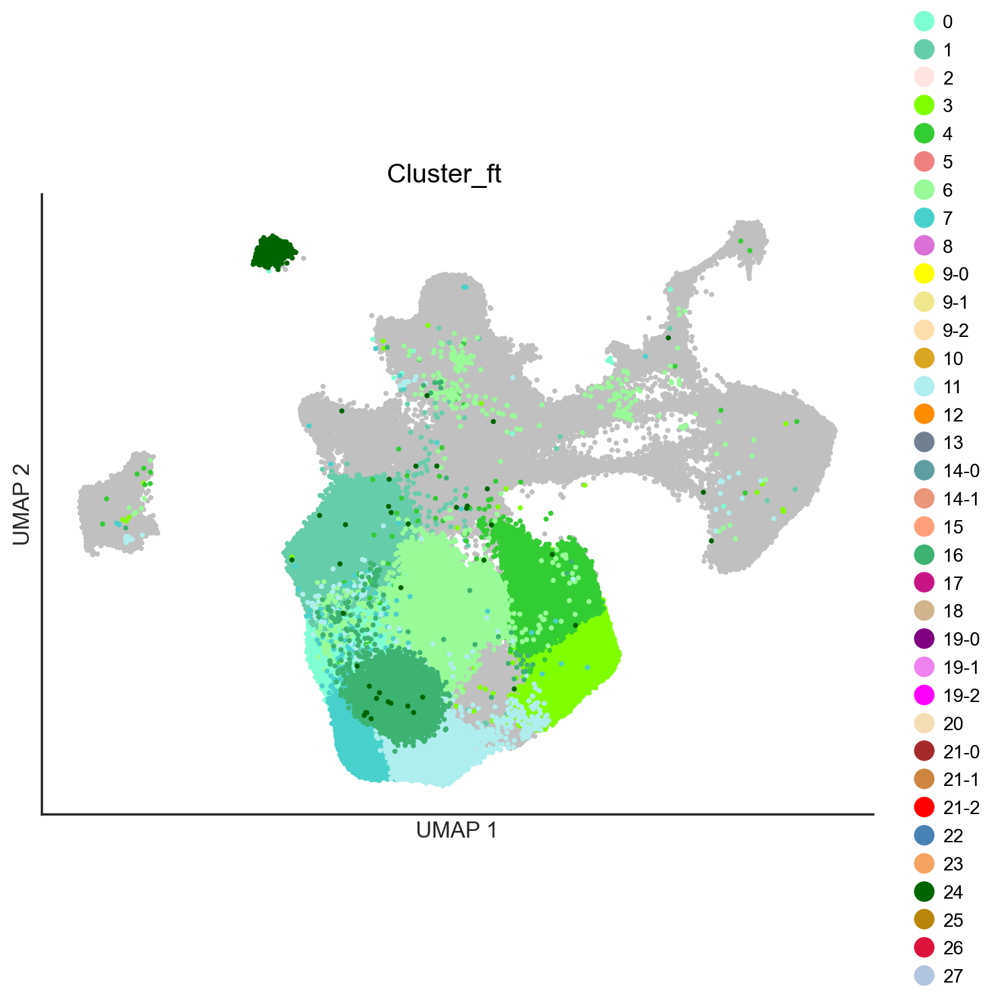

In [ ]:
ead.pl.embedding(
    color='Cluster_ft', ls_color=ls_shoot
)

In [ ]:
ead_shootAndResponseHormone = ead[ead.obs.query("Cluster_ft.isin(@ls_shoot) & Hormone.isin(@ls_hormone)").index].copy()

In [ ]:
prepareOutputForMiniex(
    ead_shootAndResponseHormone,
    "/datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input/",
    "jaSaAbaShootOnly",
    "ClusterMiniex",
    "annoOnly",
    layer="raw",
    geneDiffLayer="normalize_log",
)

2025-04-03 10:17:19.647 | INFO     | __main__:prepareOutputForMiniex:10 - Saved /datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input//jaSaAbaShootOnly_matrix.feather
2025-04-03 10:19:47.157 | INFO     | __main__:prepareOutputForMiniex:25 - Saved /datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input//jaSaAbaShootOnly_matrix.tsv
2025-04-03 10:28:12.984 | INFO     | __main__:prepareOutputForMiniex:58 - Saved /datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input//jaSaAbaShootOnly_allMarkers.tsv
2025-04-03 10:28:13.494 | INFO     | __main__:prepareOutputForMiniex:64 - Saved /datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input//jaSaAbaShootOnly_identities.tsv


# prepare output for miniex

In [ ]:
def prepareOutputForMiniex(ead, dir_miniex, prefix, clusterKey, annoKey, layer="raw", geneDiffLayer='normalize_log'):
    import pyarrow as pa
    import pyarrow.csv as csv
    import os

    df_allCount = ead.ad.T.to_df(layer)
    df_allCount.rename_axis('geneid', inplace=True)
    a = df_allCount.reset_index()
    a.to_feather(f"{dir_miniex}/{prefix}_matrix.feather")
    logger.info(f"Saved {dir_miniex}/{prefix}_matrix.feather")

    new_pa_dataframe = pa.Table.from_pandas(a)
    csv.write_csv(
        new_pa_dataframe,
        f"{dir_miniex}/{prefix}_matrix.tsv.1",
        write_options=csv.WriteOptions(delimiter="\t", include_header=False, quoting_style="none"),
    )
    df_allCount.head(0).to_csv(f"{dir_miniex}/{prefix}_matrix.tsv.2", sep="\t")
    os.system(
        f"cat {dir_miniex}/{prefix}_matrix.tsv.2 {dir_miniex}/{prefix}_matrix.tsv.1 > {dir_miniex}/{prefix}_matrix.tsv"
    )
    os.system(
        f"rm {dir_miniex}/{prefix}_matrix.tsv.1 {dir_miniex}/{prefix}_matrix.tsv.2"
    )
    logger.info(f"Saved {dir_miniex}/{prefix}_matrix.tsv")

    sc.tl.rank_genes_groups(
        ead.ad,
        groupby=f"{clusterKey}",
        method="wilcoxon",
        layer=geneDiffLayer,
        use_raw=False,
        pts=True,
        key_added=f"{clusterKey}_rank_genes",
    )
    df_markers = sc.get.rank_genes_groups_df(ead.ad, None, key=f"{clusterKey}_rank_genes", log2fc_min=0.25)
    df_markers = df_markers.query("pvals < 0.01 & pct_nz_group > 0.05")
    df_markers = df_markers.rename(
        columns={
            "names": "geneID",
            "pvals": "p_val",
            "logfoldchanges": "avg_logFC",
            "pct_nz_group": "pct.1",
            "pct_nz_reference": "pct.2",
            "pvals_adj": "p_val_adj",
            "group": "cluster",
        }
    ).reindex(
        columns=["geneID", "p_val", "avg_logFC", "pct.1", "pct.2", "p_val_adj", "cluster"]
    ).assign(
        gene=lambda _: _.geneID
    )
    _min = min(df_markers['p_val'].loc[lambda _: _ > 0].min(), 1e-100)
    df_markers['p_val'] = df_markers['p_val'].map(lambda _: max(_, _min))
    df_markers.sort_values(["cluster", "p_val"]).to_csv(
        f"{dir_miniex}/{prefix}_allMarkers.tsv", sep="\t", index=False, quoting=None
    )
    logger.info(f"Saved {dir_miniex}/{prefix}_allMarkers.tsv")

    ead.obs[['ClusterMiniex']].to_csv(f"{dir_miniex}/{prefix}_cells2clusters.tsv", sep="\t", quoting=None, header=False)
    ead.obs[[clusterKey, annoKey]].drop_duplicates().set_index(clusterKey).sort_values(
        clusterKey
    ).to_csv(f"{dir_miniex}/{prefix}_identities.tsv", sep="\t", quoting=None, header=False)
    logger.info(f"Saved {dir_miniex}/{prefix}_identities.tsv")

In [ ]:
ead.obs['annoOnly'] = ead.obs['Cluster_ft_anno'].map(lambda _: _.split(': ')[-1])
ead.obs["ClusterMiniex"] = (
    ead.obs["Cluster_ft"].astype(str)
    + "-"
    + ead.obs["Hormone"].astype(str)
)

In [ ]:
ls_hormone = ['SA','ABA', 'Mock', 'JA']
ls_shoot = [
        # Shoot-related
        "6",       # Shoot Apical Meristem
        "3", "4",  # Shoot Epidermal Cell
        "24",      # Guard Cell
        "0", "1", "7", "11", "16"  # Mesophyll Cell
    ]

2025-05-20 17:46:53.079 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1597 - ls_color: ['6', '3', '4', '24', '0', '1', '7', '11', '16']
2025-05-20 17:47:02.225 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.8938888888888888


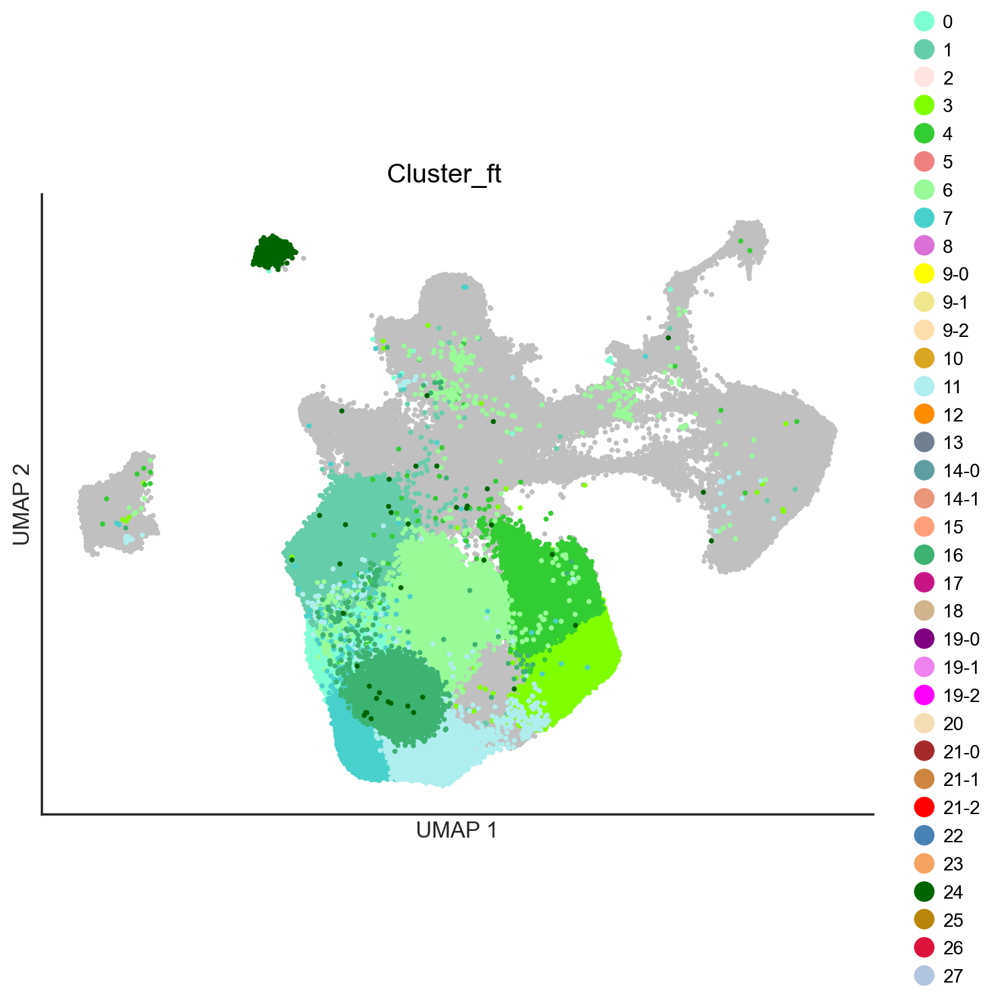

In [ ]:
ead.pl.embedding(
    color='Cluster_ft', ls_color=ls_shoot
)

In [ ]:
ead_shootAndResponseHormone = ead[ead.obs.query("Cluster_ft.isin(@ls_shoot) & Hormone.isin(@ls_hormone)").index].copy()

In [ ]:
prepareOutputForMiniex(
    ead_shootAndResponseHormone,
    "/datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input/",
    "jaSaAbaShootOnly",
    "ClusterMiniex",
    "annoOnly",
    layer="raw",
    geneDiffLayer="normalize_log",
)

2025-04-03 10:17:19.647 | INFO     | __main__:prepareOutputForMiniex:10 - Saved /datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input//jaSaAbaShootOnly_matrix.feather
2025-04-03 10:19:47.157 | INFO     | __main__:prepareOutputForMiniex:25 - Saved /datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input//jaSaAbaShootOnly_matrix.tsv
2025-04-03 10:28:12.984 | INFO     | __main__:prepareOutputForMiniex:58 - Saved /datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input//jaSaAbaShootOnly_allMarkers.tsv
2025-04-03 10:28:13.494 | INFO     | __main__:prepareOutputForMiniex:64 - Saved /datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/input//jaSaAbaShootOnly_identities.tsv


# Parse Miniex output

## get DE TF

In [ ]:
ead_sketch = ead[ead.obs["sketch"]].copy()
ead_sketchMiniex = ead[
    ead.obs.query("Cluster_ft.isin(@ls_shoot) & Hormone.isin(@ls_hormone)").index
].copy()

In [ ]:
ead_sketchMiniex.cl.getClusterSpecGeneByCellex('ClusterMiniex')

cutoff         0.60  0.70  0.80  0.90  0.95  0.99
ClusterMiniex                                    
3-SA           1300   917   567   244    93     5
1-SA           1288   943   606   265   130    12
4-SA            924   619   355   137    47     2
0-Mock          911   649   402   176    71     5
1-ABA           906   641   407   140    43     5
3-ABA           905   649   399   182    74     8
1-Mock          903   642   384   161    62     7
0-JA            886   621   405   162    63     4
1-JA            859   606   337   139    47     7
3-JA            831   597   381   182    68     4
0-ABA           815   591   368   155    63     4
4-Mock          804   572   378   162    65     3
0-SA            799   543   337   126    34     1
4-JA            788   550   358   147    60     3
4-ABA           764   549   342   126    31     2
11-SA           756   496   329   131    49     0
6-ABA           738   543   325   134    58     6
3-Mock          696   496   304   135    48     4


In [ ]:
df_deGeneVsOthersSketch = ead_sketchMiniex.uns['ClusterMiniex_cellexES'].query("enrichScore > 0.8")

In [ ]:
df_miniex = pd.read_table(
    "/datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/output/regulons/jaSaAbaShootOnly_regulons.tsv",
    names=["regulon", "cluster", "genes"],
)

In [ ]:
df_miniex.assign(
    hormone=lambda _: _.cluster.str.split("-").str[1],
    cluster=lambda _: _.cluster.str.split("-").str[0]
).to_excel("/datapool/data/Users/zhijian/projects/hormone/publication/miniex.xlsx")

In [ ]:
df_miniex = df_miniex.assign(
    regulon_name=lambda _: _.regulon + "-" + _.cluster, TF=lambda _: _.regulon
).set_index("regulon_name")

In [ ]:
ls_allTf = df_miniex['TF'].drop_duplicates()

In [ ]:
df_tfSpecInfo = pd.DataFrame(index=ead_sketchMiniex.obs['ClusterMiniex'].cat.categories, columns=ls_allTf)
for clMiniex in df_tfSpecInfo.index:
    df_temp = ead_sketchMiniex.uns['ClusterMiniex_cellexES'].query("ClusterMiniex == @clMiniex & expressed_ratio > 0.1")
    df_temp['new_score'] = np.where(df_temp['expressed_ratio'] > 0.1, df_temp['enrichScore'], 0)
    sr_temp = df_temp.set_index('gene')['new_score']
    df_tfSpecInfo.loc[clMiniex, df_temp['gene']] = sr_temp
df_tfSpecInfo.fillna(0, inplace=True)

In [ ]:
ls_kept = (
    ead_sketchMiniex.uns["ClusterMiniex_cellexES"]
    .query("enrichScore > 0.8 & expressed_ratio > 0.1 & gene in @ls_allTf")
    .sort_values("ClusterMiniex")["gene"]
    .drop_duplicates()
)

In [ ]:
df_tfSpecInfoForPlot = df_tfSpecInfo[ls_kept]

In [ ]:
df_borda = pd.read_table(
    "/datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/output/regulons/jaSaAbaShootOnly_rankedRegulons.tsv"
)
ls_tfRelatedWithStomatol = df_borda.query("hasTFrelevantGOterm == 'relevant_known_TF'")['TF'].unique().tolist() >> F(set)

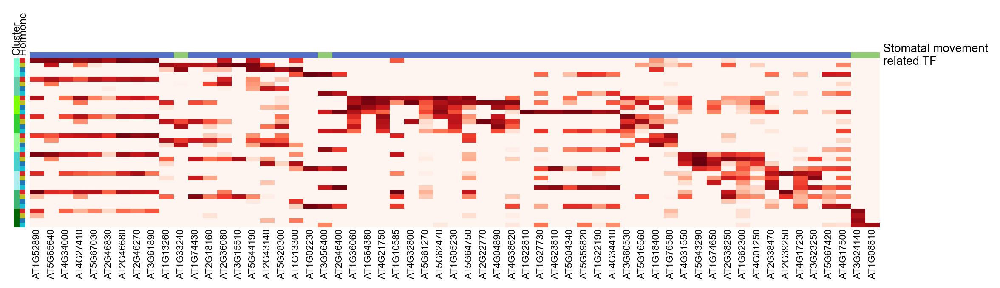

In [ ]:
h = ma.Heatmap(
    df_tfSpecInfoForPlot.values,
    width=10,
    height=2,
    cmap="Reds",
    vmax=1,
    label="Cluster specificity score",
)
h.add_left(
    mp.Colors(
        df_tfSpecInfoForPlot.index.str.split("-").str[1],
        palette={
            x: ead.pl.getAdColors("Hormone")[x] for x in ["Mock", "ABA", "JA", "SA"]
        },
        label="Hormone", label_loc='top',
        label_props={"size": 9},
    ),
    size=0.07,
    pad=0.05,
)
h.add_left(
    mp.Colors(
        df_tfSpecInfoForPlot.index.str.split("-").str[0],
        palette={
            x: ead.pl.getAdColors("Cluster_ft")[x] for x in df_tfSpecInfoForPlot.index.str.split("-").str[0].unique()
        },
        label="Cluster",label_loc='top',
        label_props={"size": 9},
    ),
    size=0.07,
)
h.add_bottom(mp.Labels(df_tfSpecInfoForPlot.columns, size=8))
h.add_top(
    mp.Colors(
        df_tfSpecInfoForPlot.columns.isin(ls_tfRelatedWithStomatol),
        label="Stomatal movement\nrelated TF",
        label_props={"size": 10},
    ),
    size=0.07,
)
# h.add_legends()
h.render()

# plot network

In [ ]:
df_edge = pd.read_table("/datapool/data/Users/zhijian/github/MINI-EX/hormone/jaSaAbaShootOnly/output/regulons/jaSaAbaShootOnly_edgeTable.tsv")
df_edge = df_edge.query("cluster=='Cluster_24-SA' & TF == 'AT1G08810'")

In [ ]:
import networkx as nx

In [ ]:
ls_myb60TgStoRelated = """AT3G49260
AT4G14480
AT3G56400
AT2G46070
AT5G26000
AT5G54270
AT2G16630
AT3G24140""".split()

In [ ]:
df_edge

,TF,TG,cluster,borda_rank,borda_clusterRank,weight
11980,AT1G08810,AT3G17070,Cluster_24-SA,18,5,58.695842
11981,AT1G08810,AT1G11850,Cluster_24-SA,18,5,37.487240
11982,AT1G08810,AT5G15230,Cluster_24-SA,18,5,29.314792
11983,AT1G08810,AT1G79910,Cluster_24-SA,18,5,28.133942
11984,AT1G08810,AT4G14440,Cluster_24-SA,18,5,26.314982
...,...,...,...,...,...,...
12120,AT1G08810,AT5G02380,Cluster_24-SA,18,5,0.024664
12121,AT1G08810,AT4G02380,Cluster_24-SA,18,5,0.019354
12122,AT1G08810,AT1G70600,Cluster_24-SA,18,5,0.009746
12123,AT1G08810,AT5G63790,Cluster_24-SA,18,5,0.004782


In [ ]:
dt_myb50TgStoRelated = {
    x: y
    for x, y in zip(
        ls_myb60TgStoRelated,
        ["IQD21", "BLUS1", "WRKY70", "MPK12", "TGG1", "LHCB3", "FOCL1", "FAMA"],
    )
}
dt_myb50TgStoRelated['AT1G08810'] = 'MYB60'

2025-05-22 17:00:11.633 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1730 - Title location: 0.9008333333333333


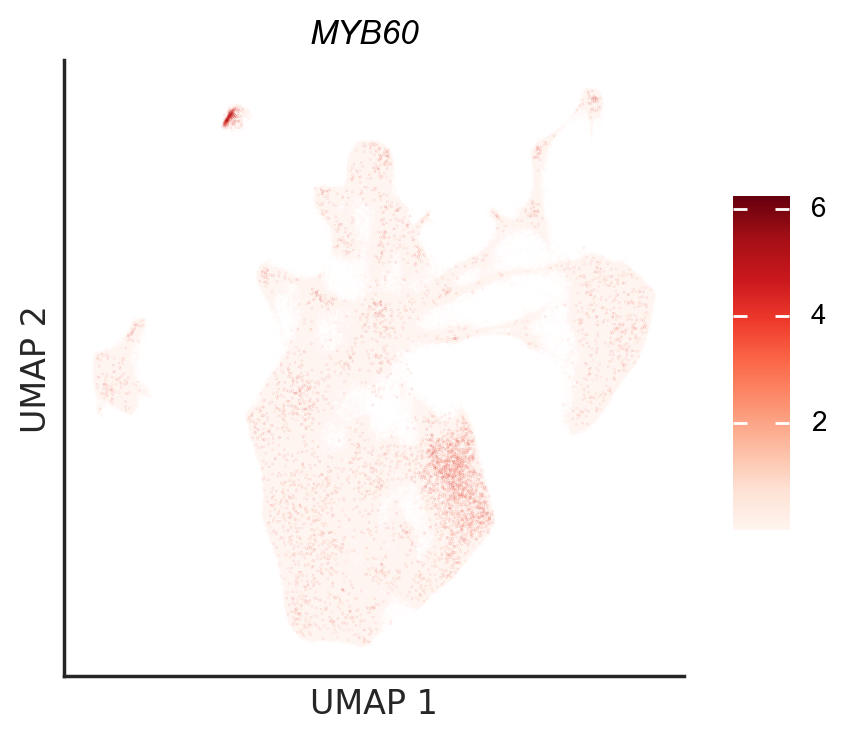

In [ ]:
ead.pl.embedding(color='AT1G08810', size=0.03, title='MYB60', figsize=(4,4))

In [ ]:
1*10-7

3

In [ ]:
-np.log10(10**-7)

7.0

In [ ]:
import matplotlib.ticker as ticker

In [ ]:
a = ticker.FixedLocator([-np.log10(0.05), 2, 4, 6, 8])

In [ ]:
import legendkit

In [ ]:
lambda _, a: -np.log10(10**_)(0)

<function __main__.<lambda>(_, a)>

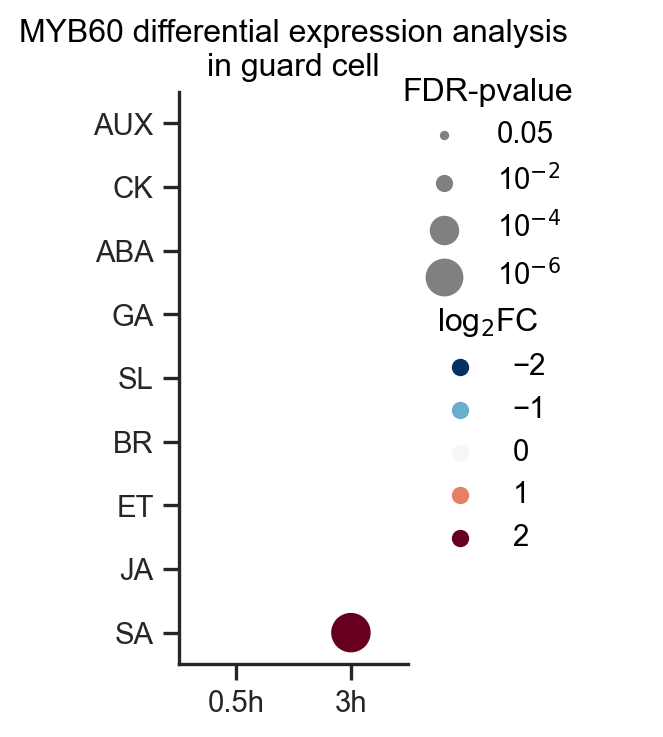

In [ ]:
def _fc(x, y):
    if np.abs(-np.log10(0.05) - x) < 0.001:
        return 0.05
    else:
        return f"10$^{{{int(-x)}}}$"

df_tempPlot = (
    ead.uns["de_Sample_deg"]
    .query("gene == 'AT1G08810' & cluster == '24'")
    .assign(**{"-log10(fdr)": lambda _: -np.log10(_["fdr"])})
)
(
    so.Plot(
        data=df_tempPlot,
        y="Hormone",
        x="Time",
        pointsize="-log10(fdr)",
        color="logFC",
    )
    .add(so.Dot())
    .label(
        x="",
        y="",
        pointsize="FDR-pvalue",
        color="log$_2$FC",
        title="MYB60 differential expression analysis\nin guard cell",
    )
    .scale(
        pointsize=so.Continuous(
            values=(3, 15), norm=(-np.log10(0.05), -np.log10(10**-7))
        ).tick(at=[-np.log10(0.05), 2, 4, 6]).label(like=_fc),
        color=so.Continuous(values="RdBu_r", norm=(-2, 2)),
    )
    .layout(size=(2, 4))
)

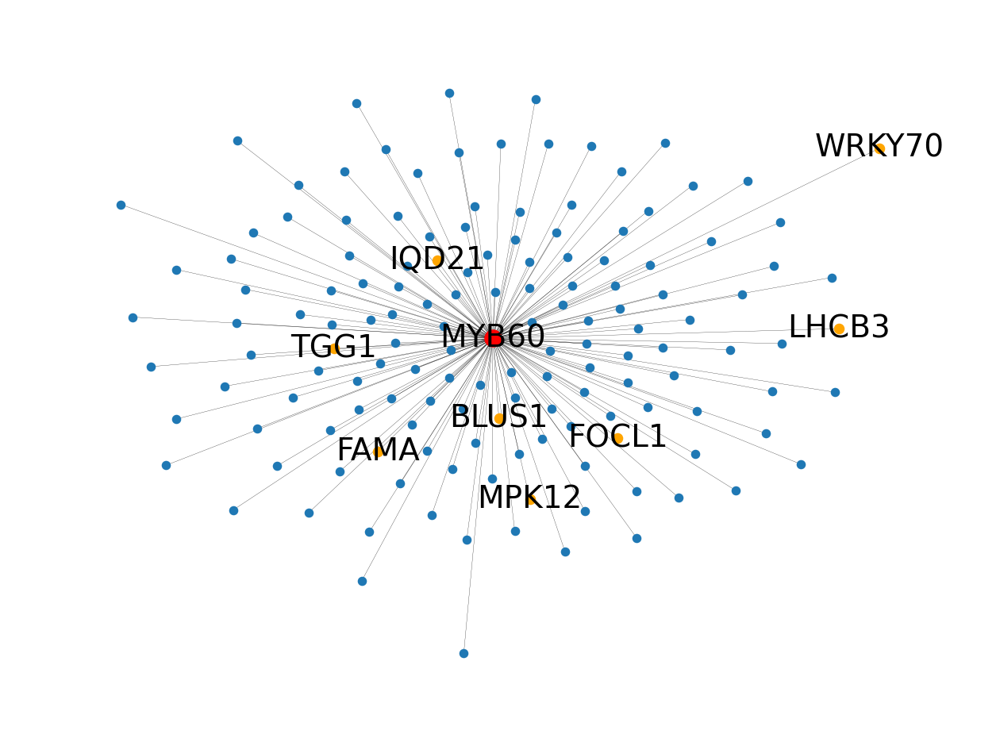

In [ ]:
G = nx.Graph()
for _, row in df_edge.iterrows():
    G.add_edge(row["TF"], row["TG"], weight=np.cbrt(row["weight"]))
pos = nx.spring_layout(G)  # positions for all nodes - seed for reproducibility
nx.draw_networkx_nodes(G, pos, node_size=10)
nx.draw_networkx_nodes(
    G, pos, nodelist=["AT1G08810"], **{"node_size": 50, "node_color": "r"}
)
nx.draw_networkx_edges(G, pos, width=0.1)

ls_stomatalRelatedTf = []
for gene in ls_myb60TgStoRelated:
    ls_stomatalRelatedTf.append(gene)
nx.draw_networkx_nodes(
    G, pos, nodelist=ls_stomatalRelatedTf, **{"node_size": 15, "node_color": "orange"}
)

nx.draw_networkx_labels(
    G,
    pos,
    labels=dt_myb50TgStoRelated,
    font_size=14,
    font_family="sans-serif",
    verticalalignment="center",
    horizontalalignment="center",
)

ax = plt.gca()
ax.margins(0.08)
plt.axis("off")
plt.tight_layout()
plt.show()